# Binarized analyses of cross-species Lung

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys

In [3]:
import pickle

In [4]:
sys.version

'3.7.3 | packaged by conda-forge | (default, Dec  6 2019, 08:54:18) \n[GCC 7.3.0]'

In [5]:
import itertools
import os

import matplotlib.pyplot as plt
import matplotlib_venn
# Third-party modules
import numpy as np
import pandas as pd

from joblib import Parallel, delayed
from tqdm import tqdm



import seaborn as sns
import scanpy


# Olga's modules
import xspecies
import binarized
import enrich

outdir_gdrive = "/home/olga/googledrive/TabulaMicrocebus/data/cross-species"
outdir_local = "/home/olga/data_lg/data_sm_copy/tabula-microcebus/data-objects/cross-species"
outdirs = outdir_local, outdir_gdrive

# Google drive figure output folder
FIGURE_FOLDER = "/home/olga/googledrive/TabulaMicrocebus/analysis/cross-species--bladder-blood-lung-muscle"
# !ls -lha $outdir_local

GDRIVE_ANALYSIS_DIR = '/home/olga/googledrive/TabulaMicrocebus/analysis/cross-species--bladder-blood-lung-muscle'

### Remove rogue tqdm instances

In [6]:
def remove_rogue_tqdm():
    import tqdm
    try:
        tqdm._instances.clear()
    except AttributeError:
        pass

### Local utils to save figures

In [7]:
import sys

# sys.path.append()

sys.path.append(
    "/home/olga/code/xspecies--olgabot/refactor-bladder-blood-lung-muscle/xspecies"
)

from plot_utils import save_figures

Matplotlib Backend: module://ipykernel.pylab.backend_inline


## Constants

In [8]:
groupby = "narrow_group"
species = "species"

tissue = "lung"

figure_folder_base = os.path.join(FIGURE_FOLDER, tissue, "binarized")

# Load data

In [9]:
%%time

h5ad = os.path.join(
    outdir_local,
    f"concatenated__human-lemur-mouse_10x__one2one_orthologs__{tissue}__preprocessed.h5ad",
)
adata = scanpy.read_h5ad(h5ad)
adata

CPU times: user 528 ms, sys: 830 ms, total: 1.36 s
Wall time: 3.89 s


AnnData object with n_obs × n_vars = 83526 × 12972
    obs: 'age', 'cell_id', 'cell_ontology_class', 'cell_ontology_id', 'free_annotation', 'n_genes', 'sex', 'subtissue', 'tissue', 'species', 'species_latin', 'channel', 'sequencing_run', 'cell_barcode', 'n_counts', 'individual', 'narrow_group', 'broad_group', 'compartment_group', 'cell_id_v1', 'cell_id_v2', 'species_batch', 'compartment_broad', 'compartment_narrow', 'compartment_broad_narrow', 'compartment_species', 'compartment_narrow_species', 'log_counts', 'sqrt_counts', 'narrow_group_dendrogram', 'narrow_group_dendrogram_colors', 'narrow_group_dendrogram_color', 'asdf', 'asdf_colors', 'dendrogram_group', 'dendrogram_group_name', 'dendrogram_group_color_name', 'dendrogram_group_color_hex', 'dendrogram_subgroup_name', 'dendrogram_subgroup_color_hex', 'dendrogram_group_name_colors', 'dendrogram_subgroup_name_colors'
    var: 'mouse_lemur__gene_name-human_hlca', 'mouse__gene_name-human_hlca', 'ensembl_id-human_sapiens', 'len-human_sapi

In [10]:
! ls -lha $h5ad

-rw-r--r-- 1 olga czb 979M Jun 21 12:00 /home/olga/data_lg/data_sm_copy/tabula-microcebus/data-objects/cross-species/concatenated__human-lemur-mouse_10x__one2one_orthologs__lung__preprocessed.h5ad


# Within-narrow group, run stability analyses

-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 14:49:19,893 INFO: Computing fraction cells expressing genes per narrow_group
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 14:49:19,894 INFO: Filtering adata for only narrow_group shared across all 3 species
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 14:49:19,899 INFO: Starting number of narrow_group: 22
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 14:49:19,973 INFO: After removing groups not in all species narrow_group: 22
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 14:49:20,060 INFO: After cell groups with too few cells in narrow_group: 22
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/

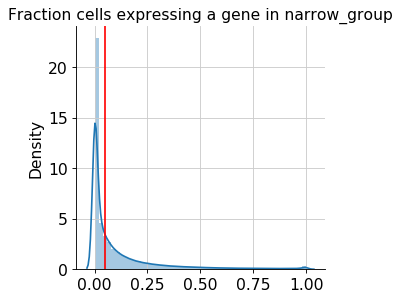

In [11]:
stability = binarized.BinarizedStabilityAnalyses(
    adata, groupby, species, debug=True, species_order=["Human", "Mouse lemur", "Mouse"]
)

Binarizing at thresholds: [0.01, 0.02, 0.03, 0.04, 0.05, 0.060000000000000005, 0.06999999999999999, 0.08, 0.09, 0.09999999999999999, 0.11, 0.12, 0.13, 0.14, 0.15000000000000002, 0.16, 0.17, 0.18000000000000002, 0.19, 0.2, 0.21000000000000002, 0.22, 0.23, 0.24000000000000002, 0.25, 0.26, 0.27, 0.28, 0.29000000000000004, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35000000000000003, 0.36000000000000004, 0.37, 0.38, 0.39]: 100%|██████████| 39/39 [00:00<00:00, 1444.12it/s]
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 14:49:27,371 INFO: Computing pairwise mutual information across thresholds
Computing mutual information between thresholds: 0it [00:00, ?it/s][Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
Computing mutual information between thresholds: 48it [00:33,  1.87it/s][Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:   33.6s
Computing mutual information between thresholds: 192it [02:45,  1.11it/s][P

(3224832, 4)


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:03:05,183 INFO: Number of stable genes: 4352/12972 (33.55%)
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:03:05,195 INFO: Number of unstable genes: 8620/12972 (66.45%)


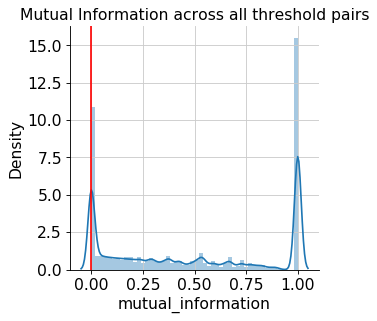

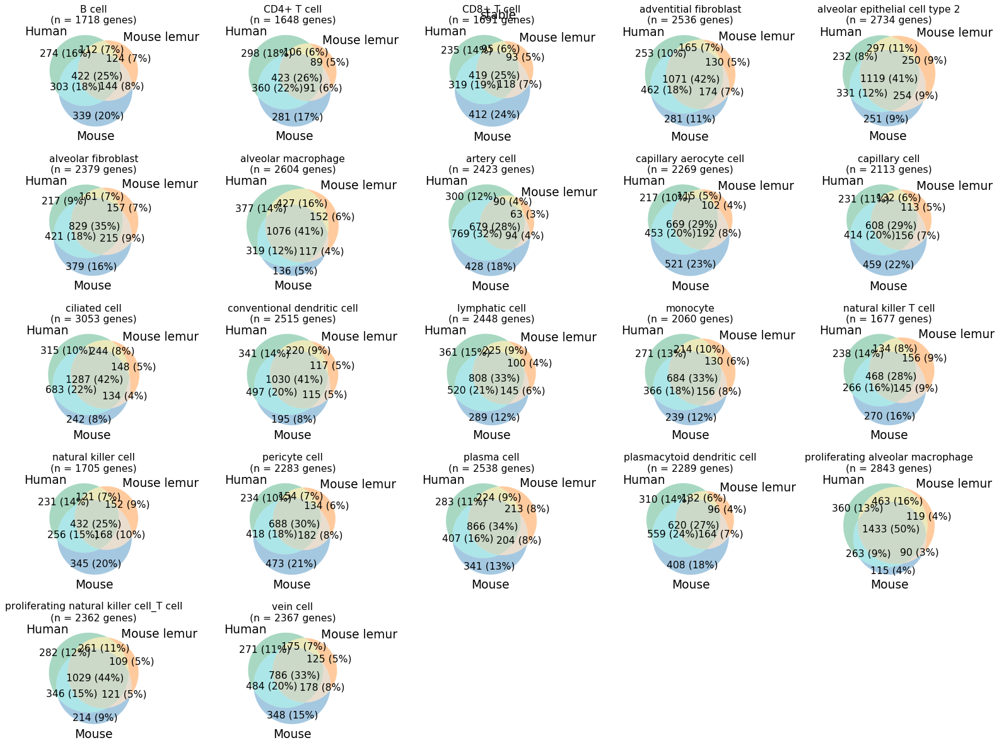

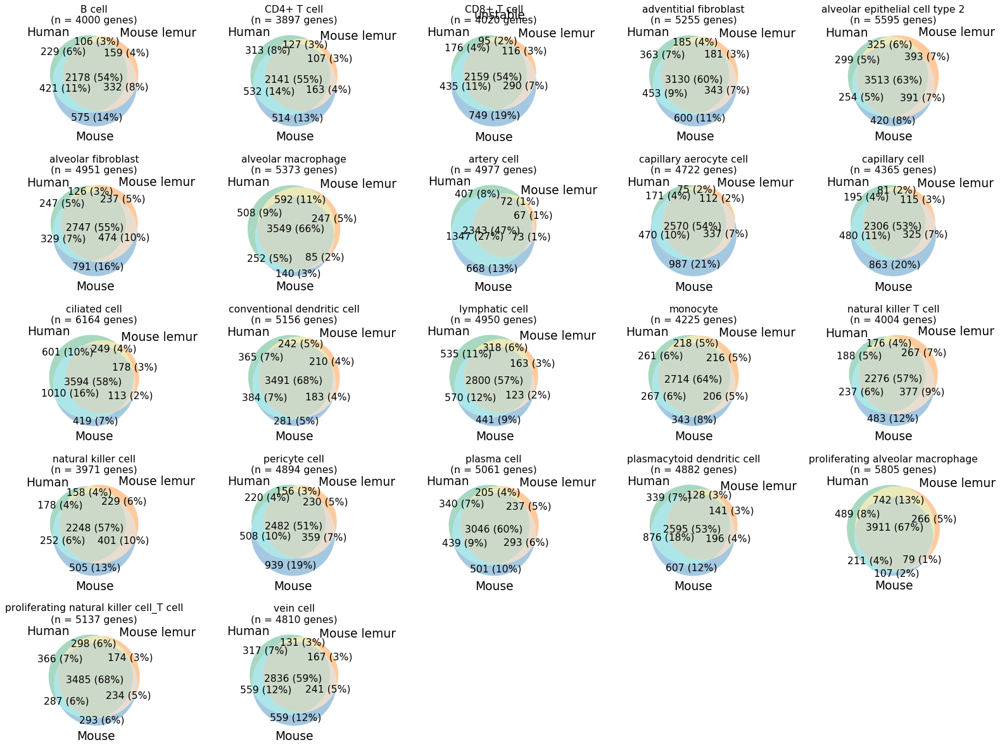

In [12]:
stability.do_stability_analysis(thresholds=np.arange(0.01, 0.4, 0.01))

Saving figures: 100%|██████████| 2/2 [00:15<00:00,  7.63s/it]


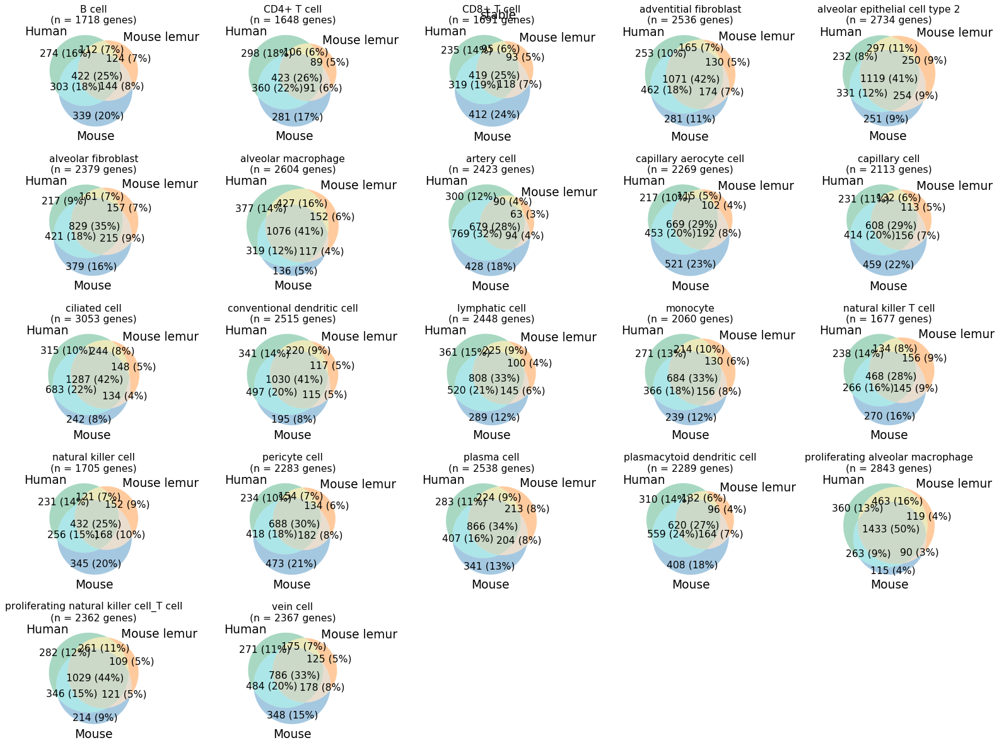

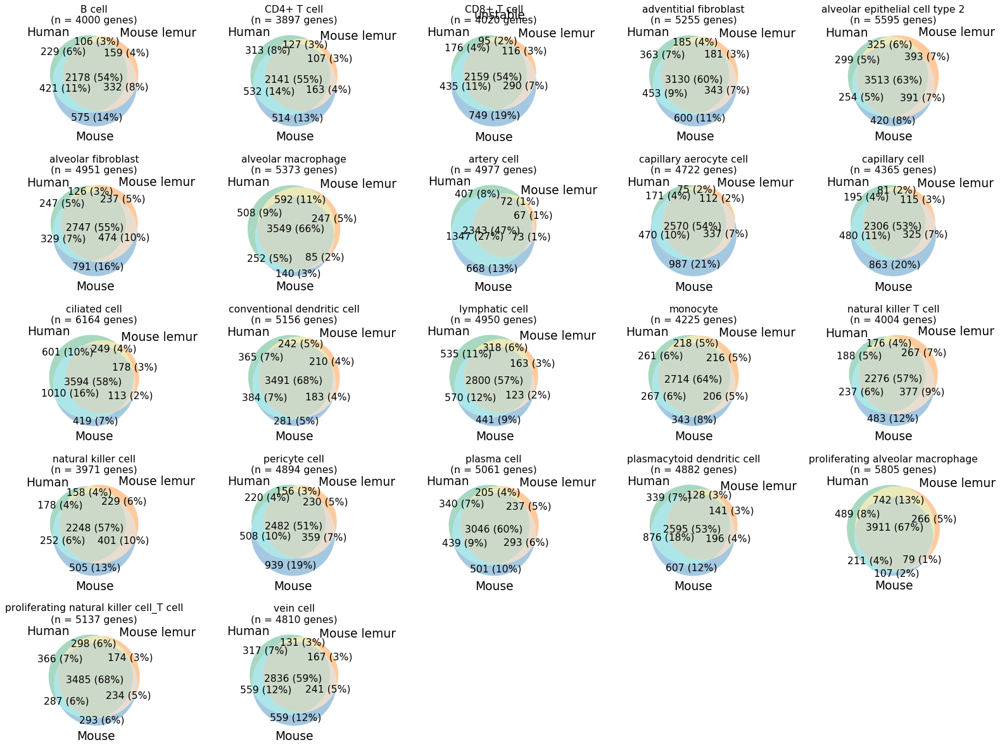

In [13]:
stability.plot_venns()
figure_folder = os.path.join(figure_folder_base, "stable-genes")

save_figures(figure_folder)

In [14]:
adata.obs.narrow_group.nunique()

22

Saving figures: 100%|██████████| 1/1 [00:07<00:00,  7.34s/it]


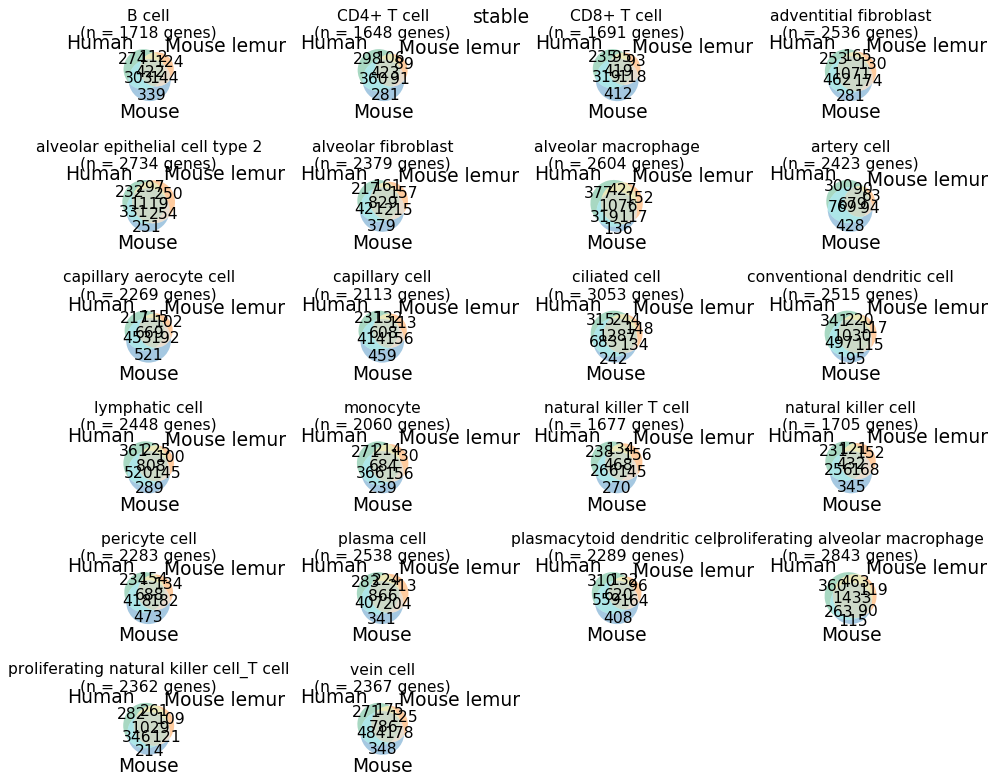

In [15]:
stability.venn('stable', n_row=6, n_col=4, figsize=(12, 10), annotate=False)
figure_folder = os.path.join(figure_folder_base, "stable-genes")

save_figures(figure_folder)

### Skip GO enrichment for now --> need to install `gprofiler-official`

In [16]:
# stability.do_go_enrichment(plot=True, write=True)

## Plot enrichment, groupby enrichment database source

In [17]:
# stability.plot_go_enrichment(groupby_source=True)

In [18]:
# cross_species.dotplots(
#     ,
# #     save=f"__binary__{col_name_sanitized}",
# #     select_group=compartment_narrow_col,
# #     save_format="pdf",
# #     max_genes=32,
# )

# Do primate enrichment

In [19]:
species

'species'

-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:03:39,243 INFO: Computing fraction cells expressing genes per narrow_group
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:03:39,244 INFO: Filtering adata for only narrow_group shared across all 3 species
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:03:39,248 INFO: Starting number of narrow_group: 22
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:03:39,328 INFO: After removing groups not in all species narrow_group: 22
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:03:39,413 INFO: After cell groups with too few cells in narrow_group: 22
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/

CPU times: user 43.5 s, sys: 16.2 s, total: 59.7 s
Wall time: 2min 7s


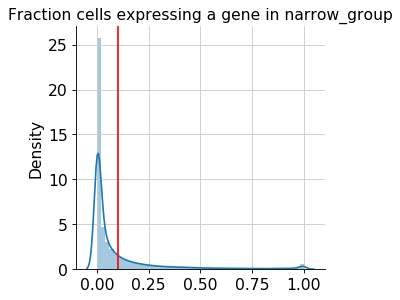

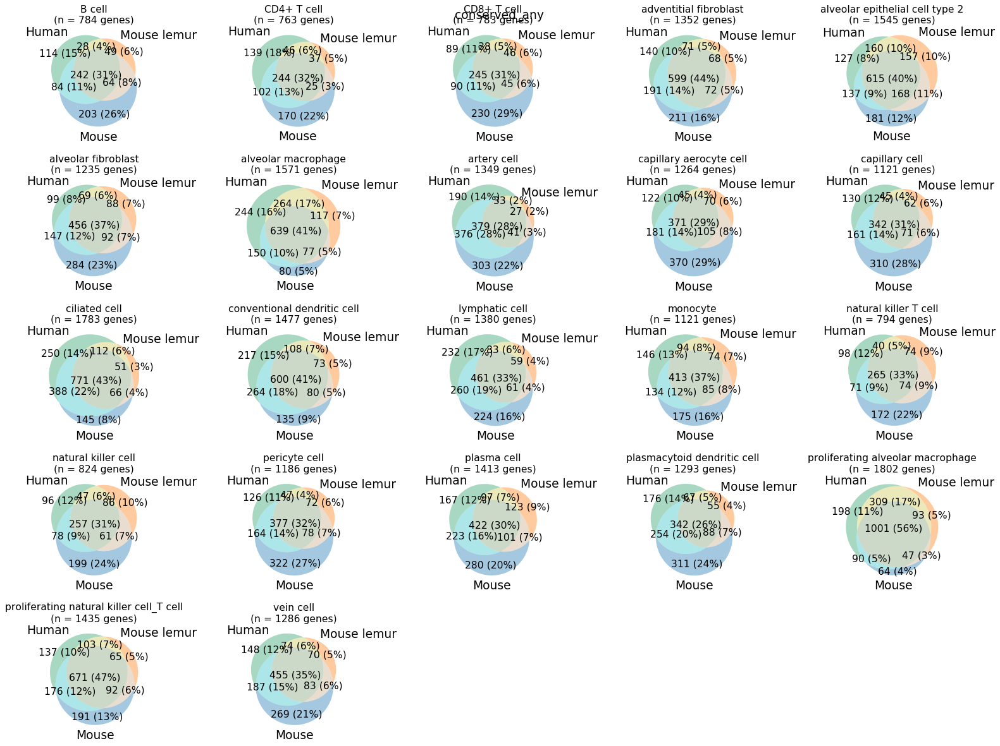

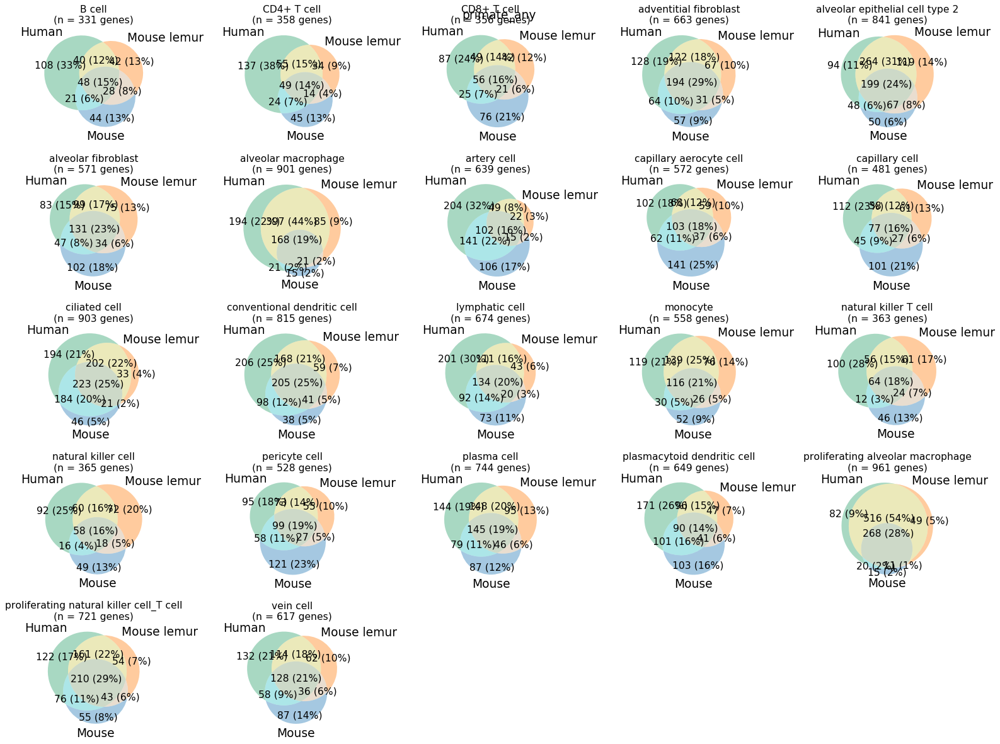

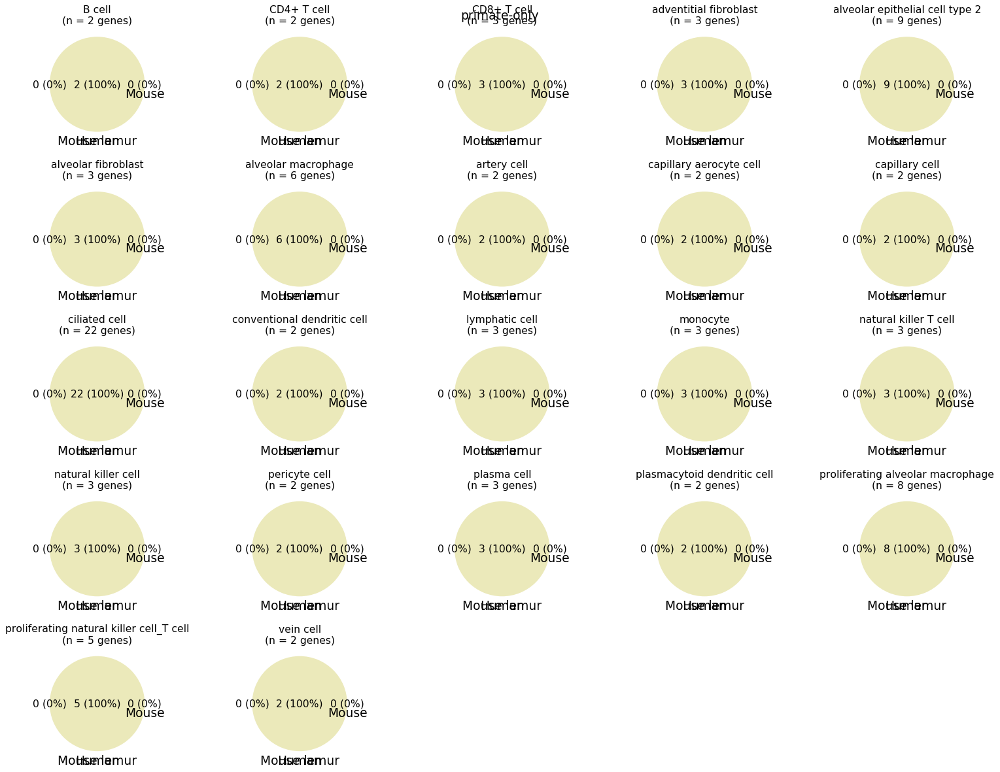

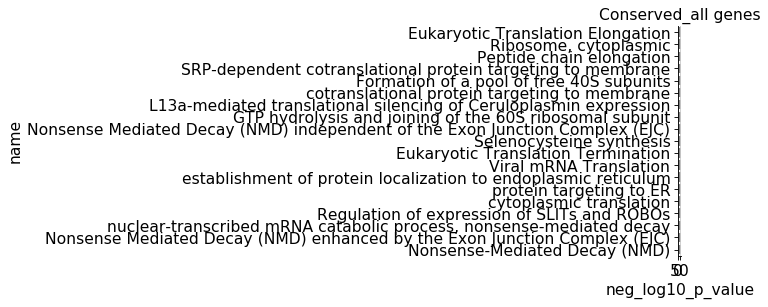

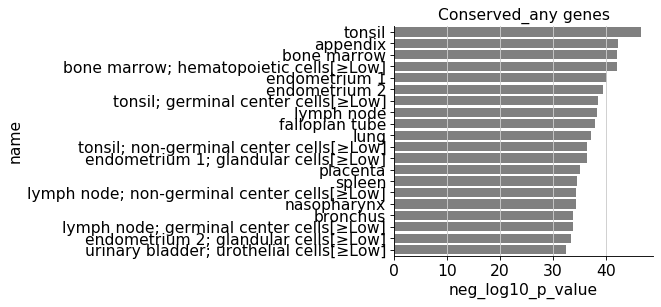

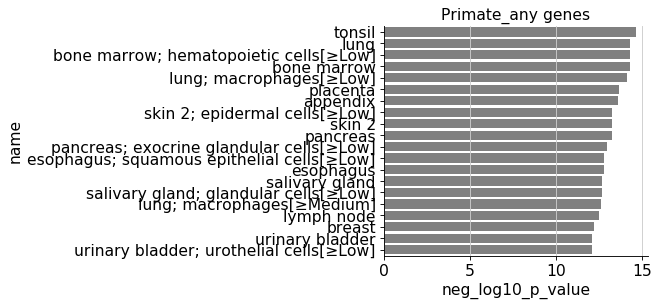

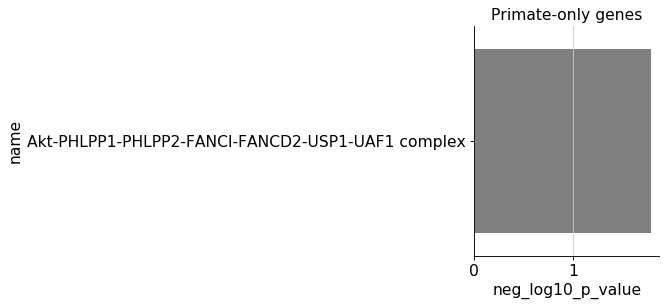

In [20]:
%%time

import binarized

primate = binarized.BinarizedPrimateAnalyses(
    adata,
    groupby,
    species,
    stable_genes=stability.stable_gene_names,
    debug=True,
    primates=["Human", "Mouse lemur"],
    species_order=["Human", "Mouse lemur", "Mouse"],
)
primate.find_primate_enriched_genes()

figure_folder = os.path.join(FIGURE_FOLDER, tissue, "primate")

save_figures(figure_folder)

## Save Primate_any to a file

## Get p value of overlap of binary groups

In [21]:
lines = []

for celltype, df in primate.binarized.groupby(level=1):
    #     print(df.head())
    for species1, species2 in itertools.combinations(primate.species_order, 2):
        pvalue = -binarized.overlap_pvalue_sf(
            df.loc[(species1, celltype)], df.loc[(species2, celltype)], log=True
        )

        species_pair = primate.separator.join([species1, species2])
        line = [celltype, species1, species2, species_pair, pvalue]
        lines.append(line)

pvalue_df = pd.DataFrame(
    lines, columns=["celltype", "species1", "species2", "species_pair", "neg_log_pvalue"]
)
pvalue_df["neg_log_pvalue_adjusted"] = pvalue_df["neg_log_pvalue"] - np.log(len(pvalue_df))

pvalue_df

,celltype,species1,species2,species_pair,neg_log_pvalue,neg_log_pvalue_adjusted
0,B cell,Human,Mouse lemur,Human--Mouse lemur,380.377537,376.187882
1,B cell,Human,Mouse,Human--Mouse,399.724061,395.534406
2,B cell,Mouse lemur,Mouse,Mouse lemur--Mouse,406.813195,402.623540
3,CD4+ T cell,Human,Mouse lemur,Human--Mouse lemur,426.207265,422.017610
4,CD4+ T cell,Human,Mouse,Human--Mouse,465.150042,460.960387
...,...,...,...,...,...,...
61,proliferating natural killer cell_T cell,Human,Mouse,Human--Mouse,678.403030,674.213375
62,proliferating natural killer cell_T cell,Mouse lemur,Mouse,Mouse lemur--Mouse,540.601943,536.412288
63,vein cell,Human,Mouse lemur,Human--Mouse lemur,482.072642,477.882987
64,vein cell,Human,Mouse,Human--Mouse,480.322351,476.132696


## Find cell types where the human-lemur overlap is larger than human-mouse

In [22]:
pvalue_df_species_pair_index = pvalue_df.set_index("species_pair")
pvalue_df_species_pair_index.head()

,celltype,species1,species2,neg_log_pvalue,neg_log_pvalue_adjusted
species_pair,,,,,
Human--Mouse lemur,B cell,Human,Mouse lemur,380.377537,376.187882
Human--Mouse,B cell,Human,Mouse,399.724061,395.534406
Mouse lemur--Mouse,B cell,Mouse lemur,Mouse,406.813195,402.623540
Human--Mouse lemur,CD4+ T cell,Human,Mouse lemur,426.207265,422.017610
Human--Mouse,CD4+ T cell,Human,Mouse,465.150042,460.960387


In [23]:
pvalue_df_species_pair_index

,celltype,species1,species2,neg_log_pvalue,neg_log_pvalue_adjusted
species_pair,,,,,
Human--Mouse lemur,B cell,Human,Mouse lemur,380.377537,376.187882
Human--Mouse,B cell,Human,Mouse,399.724061,395.534406
Mouse lemur--Mouse,B cell,Mouse lemur,Mouse,406.813195,402.623540
Human--Mouse lemur,CD4+ T cell,Human,Mouse lemur,426.207265,422.017610
Human--Mouse,CD4+ T cell,Human,Mouse,465.150042,460.960387
...,...,...,...,...,...
Human--Mouse,proliferating natural killer cell_T cell,Human,Mouse,678.403030,674.213375
Mouse lemur--Mouse,proliferating natural killer cell_T cell,Mouse lemur,Mouse,540.601943,536.412288
Human--Mouse lemur,vein cell,Human,Mouse lemur,482.072642,477.882987


## Plot difference in p-value of overlap between binarized genes in cell types

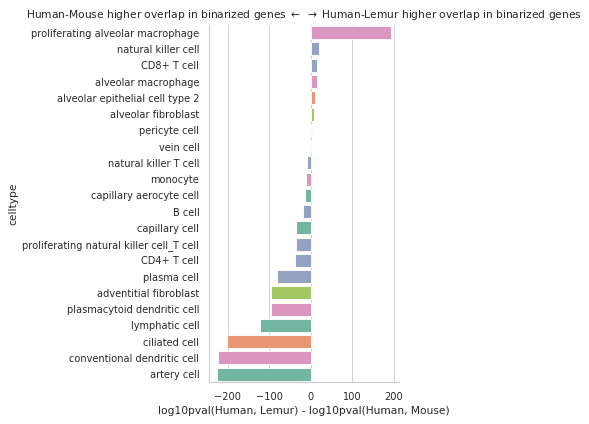

In [24]:
pvalue_diff = pvalue_df_species_pair_index.groupby("celltype").apply(
    lambda x: x.loc["Human--Mouse lemur", "neg_log_pvalue"]
    - x.loc["Human--Mouse", "neg_log_pvalue"]
)
pvalue_diff = pvalue_diff.reset_index()
pvalue_diff = pvalue_diff.rename(columns={0: "diff_log_pvalue"})
pvalue_diff = pvalue_diff.sort_values("diff_log_pvalue", ascending=False)
pvalue_diff.head()

narrow_to_compartment = adata.obs[["narrow_group", "compartment_group"]].set_index(
    "narrow_group"
)
narrow_to_compartment = narrow_to_compartment.loc[
    ~narrow_to_compartment.index.duplicated(), "compartment_group"
]
narrow_to_compartment

pvalue_diff["compartment"] = pvalue_diff.celltype.map(narrow_to_compartment)
pvalue_diff.head()

colors = {
    x: xspecies.compartment_to_color[y]
    for i, (x, y) in pvalue_diff[["celltype", "compartment"]].iterrows()
}


sns.set(context="paper", style="whitegrid")

g = sns.catplot(
    data=pvalue_diff, y="celltype", x="diff_log_pvalue", kind="bar", palette=colors
)
g.set(xlabel="log10pval(Human, Lemur) - log10pval(Human, Mouse)")
pdf = os.path.join(
    figure_folder_base,
    f"binarized__{tissue}__pvalue_diff_overlap__human-lemur_vs_human-mouse.pdf",
)
g.set(
    title=r"Human-Mouse higher overlap in binarized genes $\leftarrow$ $\rightarrow$ Human-Lemur higher overlap in binarized genes"
)
g.savefig(pdf)

In [25]:
pdf

'/home/olga/googledrive/TabulaMicrocebus/analysis/cross-species--bladder-blood-lung-muscle/lung/binarized/binarized__lung__pvalue_diff_overlap__human-lemur_vs_human-mouse.pdf'

## Make table of primate enriched genes

### Make (genes, celltype) table where the values are `"Human-Mouse Lemur"`

In [26]:
1+1

2

In [27]:
primate_any = primate.primate_any[primate.primate_any == primate.primates_string]
print(primate_any.shape)
primate_any = primate_any.dropna(how='all')
print(primate_any.shape)


xlsx = os.path.join(
    figure_folder_base, f"binarized_expression__stable_genes__primate_only__narrow_group__{tissue}.xlsx"
)
primate_any.to_excel(xlsx)

(1170, 22)
(1170, 22)


### Make a table where all the genes that primate enriched in that cell type are shown

In [28]:
genes_in_primate_enriched_celltypes = primate.primate_any#[primate_enriched_celltypes]
genes_in_primate_enriched_celltypes = genes_in_primate_enriched_celltypes[
    genes_in_primate_enriched_celltypes == primate.primates_string
]
genes_in_primate_enriched_celltypes = genes_in_primate_enriched_celltypes.dropna(
    how="all"
)

df_components = {}

for celltype, col in genes_in_primate_enriched_celltypes.iteritems():
    print(f"--- {celltype} ---")
    celltype_primate_genes = col[col == primate.primates_string].dropna(how="all")
    df_components[celltype] = sorted(celltype_primate_genes.index.tolist())

max_n_genes = max(len(v) for v in df_components.values())
df_components = {
    k: v + [None] * (max_n_genes - len(v)) for k, v in df_components.items()
}
primate_enriched_genes_per_celltype = pd.DataFrame(df_components)
primate_enriched_genes_per_celltype

--- B cell ---
--- CD4+ T cell ---
--- CD8+ T cell ---
--- adventitial fibroblast ---
--- alveolar epithelial cell type 2 ---
--- alveolar fibroblast ---
--- alveolar macrophage ---
--- artery cell ---
--- capillary aerocyte cell ---
--- capillary cell ---
--- ciliated cell ---
--- conventional dendritic cell ---
--- lymphatic cell ---
--- monocyte ---
--- natural killer T cell ---
--- natural killer cell ---
--- pericyte cell ---
--- plasma cell ---
--- plasmacytoid dendritic cell ---
--- proliferating alveolar macrophage ---
--- proliferating natural killer cell_T cell ---
--- vein cell ---


,B cell,CD4+ T cell,CD8+ T cell,adventitial fibroblast,alveolar epithelial cell type 2,alveolar fibroblast,alveolar macrophage,artery cell,capillary aerocyte cell,capillary cell,...,lymphatic cell,monocyte,natural killer T cell,natural killer cell,pericyte cell,plasma cell,plasmacytoid dendritic cell,proliferating alveolar macrophage,proliferating natural killer cell_T cell,vein cell
0,ALOX5AP,ALOX5AP,ALOX5AP,ABCA5,ABHD14A,ABCA5,ABHD2,AGPAT2,ACSL3,AKR1B1,...,ACP2,ABHD2,ALOX5AP,ACSS1,ABCC9,ABHD3,ABHD2,ABCD3,ABHD2,AGPAT2
1,AP1B1,AP1S2,AP1S2,ABCA8,ABHD2,ABCA8,ABHD3,ATP6V0C,ADA,ANGPTL4,...,ACSL3,ABHD3,AMD1,ALOX5AP,ADAMTS8,ACAP1,ADA,ABHD14A,ACTN1,AHI1
2,AP1S2,AQP3,ATP2B4,ABCA9,ACP5,ACP5,ABI3,BEX4,AKR1B1,AP1S2,...,ADA,ACSL4,AP1S2,AP1S2,AGTR1,ACSL3,ANKRD28,ABHD2,AIF1,AKR1B1
3,ATP6V0C,ATP2B4,ATP6V0C,ACSL3,ACSF2,ACSL3,ACER3,BTG3,AMIGO2,ARRDC3,...,AGPAT2,ADAM19,ATP6V0C,ATP6V0C,AHI1,ACYP2,AP1S2,ABHD3,ALKBH7,ALCAM
4,BZW2,ATP6V0C,BID,AHI1,ACSL1,AGPAT2,ACSF2,C1QB,ARL1,ASS1,...,AHI1,ADAMTSL4,BID,BID,AKR1B1,AGPAT2,AQP3,ACER3,AMD1,ALG2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
511,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,ZNF580,None,None
512,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,ZNF652,None,None
513,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,ZNF664,None,None
514,None,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,ZNF791,None,None


#### Write primate-specific gene enrichement to file

In [29]:
xlsx = os.path.join(
    figure_folder_base, "genes_in_primate_enriched_celltypes.xlsx"
)
primate_enriched_genes_per_celltype.to_excel(xlsx)

In [30]:
genes_in_primate_enriched_celltypes

narrow_group,B cell,CD4+ T cell,CD8+ T cell,adventitial fibroblast,alveolar epithelial cell type 2,alveolar fibroblast,alveolar macrophage,artery cell,capillary aerocyte cell,capillary cell,...,lymphatic cell,monocyte,natural killer T cell,natural killer cell,pericyte cell,plasma cell,plasmacytoid dendritic cell,proliferating alveolar macrophage,proliferating natural killer cell_T cell,vein cell
A4GALT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ABCA5,NaN,NaN,NaN,Human--Mouse lemur,NaN,Human--Mouse lemur,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ABCA8,NaN,NaN,NaN,Human--Mouse lemur,NaN,Human--Mouse lemur,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ABCA9,NaN,NaN,NaN,Human--Mouse lemur,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ABCC9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,Human--Mouse lemur,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF791,NaN,NaN,NaN,NaN,NaN,Human--Mouse lemur,NaN,Human--Mouse lemur,Human--Mouse lemur,NaN,...,Human--Mouse lemur,NaN,NaN,NaN,NaN,Human--Mouse lemur,Human--Mouse lemur,Human--Mouse lemur,Human--Mouse lemur,NaN
ZNHIT3,NaN,NaN,NaN,NaN,NaN,NaN,Human--Mouse lemur,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ZNRF2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ZSCAN18,NaN,NaN,NaN,Human--Mouse lemur,Human--Mouse lemur,Human--Mouse lemur,NaN,NaN,NaN,NaN,...,Human--Mouse lemur,NaN,NaN,NaN,Human--Mouse lemur,NaN,NaN,NaN,NaN,NaN


In [31]:
genes_in_primate_enriched_celltypes_binary = genes_in_primate_enriched_celltypes.fillna(
    False
).replace(primate.primates_string, True)
genes_in_primate_enriched_celltypes_binary

narrow_group,B cell,CD4+ T cell,CD8+ T cell,adventitial fibroblast,alveolar epithelial cell type 2,alveolar fibroblast,alveolar macrophage,artery cell,capillary aerocyte cell,capillary cell,...,lymphatic cell,monocyte,natural killer T cell,natural killer cell,pericyte cell,plasma cell,plasmacytoid dendritic cell,proliferating alveolar macrophage,proliferating natural killer cell_T cell,vein cell
A4GALT,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ABCA5,False,False,False,True,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ABCA8,False,False,False,True,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ABCA9,False,False,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ABCC9,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF791,False,False,False,False,False,True,False,True,True,False,...,True,False,False,False,False,True,True,True,True,False
ZNHIT3,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ZNRF2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ZSCAN18,False,False,False,True,True,True,False,False,False,False,...,True,False,False,False,True,False,False,False,False,False


## 

## Make dotplots of binary-enriched genes

In [32]:
cross_species = xspecies.CrossSpeciesComparison(adata, 'compartment_narrow')
# cross_species.plot_shared_cell_types()

compartment_narrow                    species    
endothelial: artery cell              Mouse            95
                                      Mouse lemur     143
                                      Human          1306
endothelial: capillary aerocyte cell  Mouse           512
                                      Mouse lemur     900
                                                     ... 
stromal: alveolar fibroblast          Mouse lemur     997
                                      Human          1048
stromal: pericyte cell                Mouse            59
                                      Mouse lemur      71
                                      Human          1350
Length: 66, dtype: int64


In [33]:
cross_species.make_subset_adatas(do_pca_umap=False)


------- group: endothelial: artery cell -------
number of cells: 1544

------- group: endothelial: capillary aerocyte cell -------
number of cells: 5124

------- group: endothelial: capillary cell -------
number of cells: 8833

------- group: endothelial: lymphatic cell -------
number of cells: 720

------- group: endothelial: vein cell -------
number of cells: 1408

------- group: epithelial: alveolar epithelial cell type 2 -------
number of cells: 5255

------- group: epithelial: ciliated cell -------
number of cells: 1370

------- group: lymphoid: B cell -------
number of cells: 1925

------- group: lymphoid: CD4+ T cell -------
number of cells: 4089

------- group: lymphoid: CD8+ T cell -------
number of cells: 3184

------- group: lymphoid: natural killer T cell -------
number of cells: 1220

------- group: lymphoid: natural killer cell -------
number of cells: 7994

------- group: lymphoid: plasma cell -------
number of cells: 305

------- group: lymphoid: proliferating natural 

In [34]:
narrow_to_compartment_narrrow = dict(zip(adata.obs.narrow_group, adata.obs.compartment_narrow))
narrow_to_compartment_narrrow

{'B cell': 'lymphoid: B cell',
 'monocyte': 'myeloid: monocyte',
 'natural killer cell': 'lymphoid: natural killer cell',
 'alveolar macrophage': 'myeloid: alveolar macrophage',
 'conventional dendritic cell': 'myeloid: conventional dendritic cell',
 'CD8+ T cell': 'lymphoid: CD8+ T cell',
 'capillary cell': 'endothelial: capillary cell',
 'natural killer T cell': 'lymphoid: natural killer T cell',
 'capillary aerocyte cell': 'endothelial: capillary aerocyte cell',
 'adventitial fibroblast': 'stromal: adventitial fibroblast',
 'CD4+ T cell': 'lymphoid: CD4+ T cell',
 'vein cell': 'endothelial: vein cell',
 'alveolar fibroblast': 'stromal: alveolar fibroblast',
 'pericyte cell': 'stromal: pericyte cell',
 'plasma cell': 'lymphoid: plasma cell',
 'artery cell': 'endothelial: artery cell',
 'alveolar epithelial cell type 2': 'epithelial: alveolar epithelial cell type 2',
 'proliferating alveolar macrophage': 'myeloid: proliferating alveolar macrophage',
 'ciliated cell': 'epithelial: cili

In [35]:
figure_folder

'/home/olga/googledrive/TabulaMicrocebus/analysis/cross-species--bladder-blood-lung-muscle/lung/primate'

In [36]:
figure_folder_base

'/home/olga/googledrive/TabulaMicrocebus/analysis/cross-species--bladder-blood-lung-muscle/lung/binarized'

In [37]:
dotplot_dir = os.path.join(figure_folder_base, 'dotplots')

In [38]:
scanpy.settings.figdir = dotplot_dir
! mkdir -p $dotplot_dir

## Dotplots of primate-enriched genes by binary analyses

gene subset #1

------- group: lymphoid: B cell -------


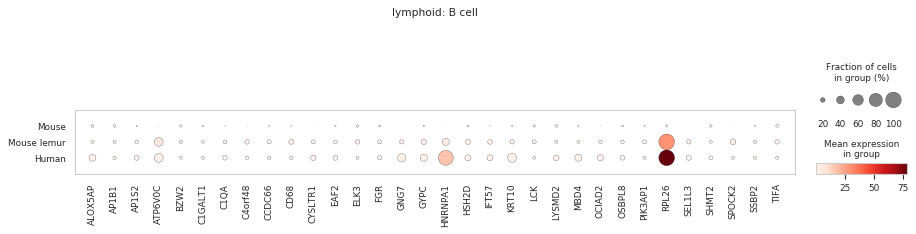

gene subset #2

------- group: lymphoid: B cell -------


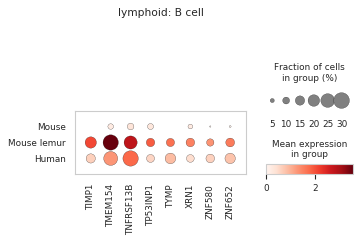

gene subset #1

------- group: lymphoid: CD4+ T cell -------


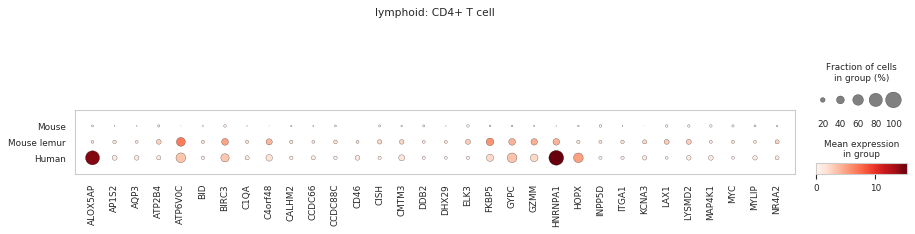

gene subset #2

------- group: lymphoid: CD4+ T cell -------


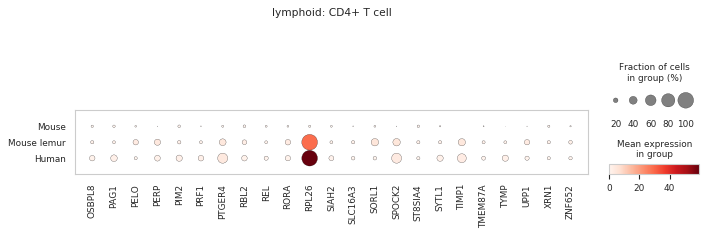

gene subset #1

------- group: lymphoid: CD8+ T cell -------


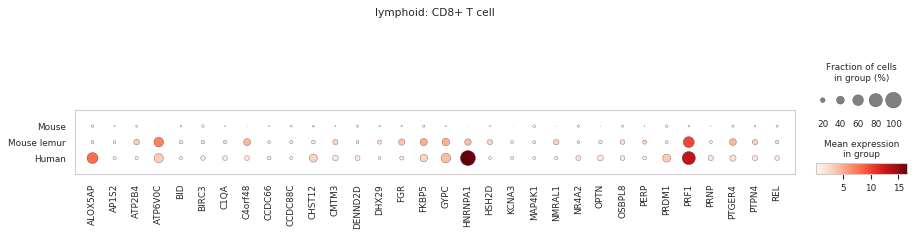

gene subset #2

------- group: lymphoid: CD8+ T cell -------


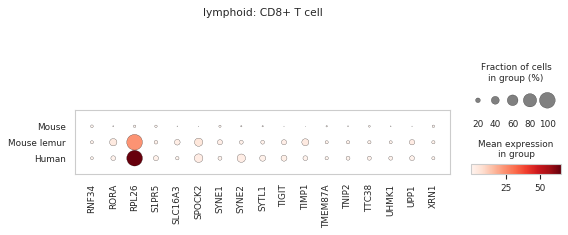

gene subset #1

------- group: stromal: adventitial fibroblast -------


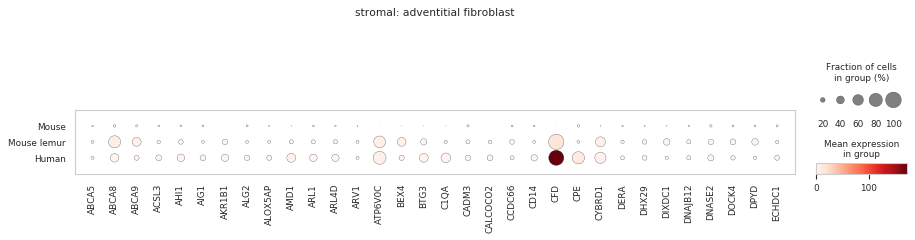

gene subset #2

------- group: stromal: adventitial fibroblast -------


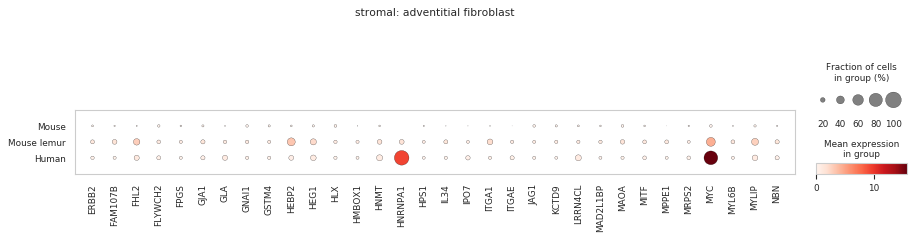

gene subset #3

------- group: stromal: adventitial fibroblast -------


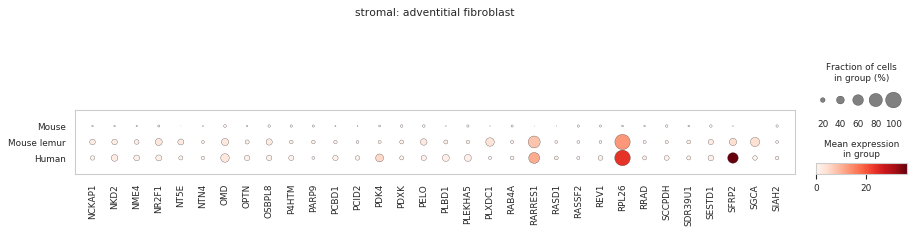

gene subset #4

------- group: stromal: adventitial fibroblast -------


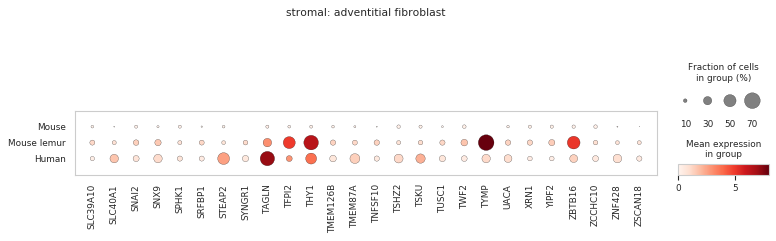

gene subset #1

------- group: epithelial: alveolar epithelial cell type 2 -------


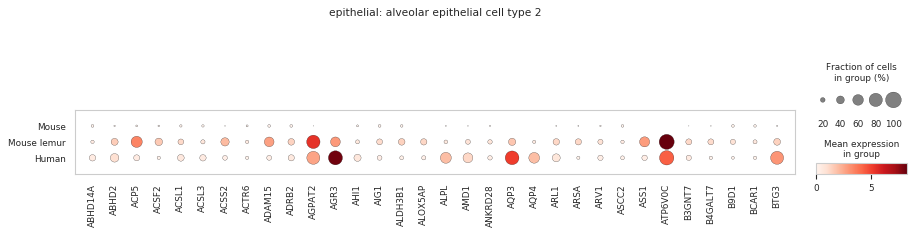

gene subset #2

------- group: epithelial: alveolar epithelial cell type 2 -------


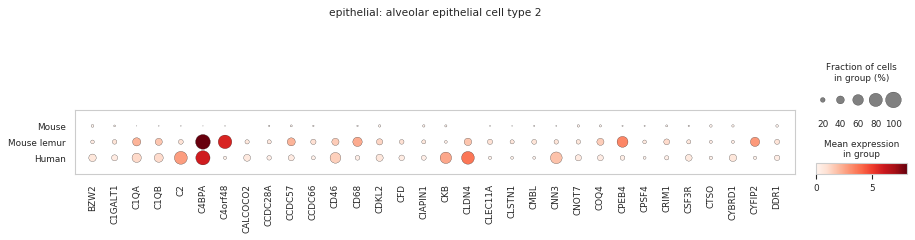

gene subset #3

------- group: epithelial: alveolar epithelial cell type 2 -------


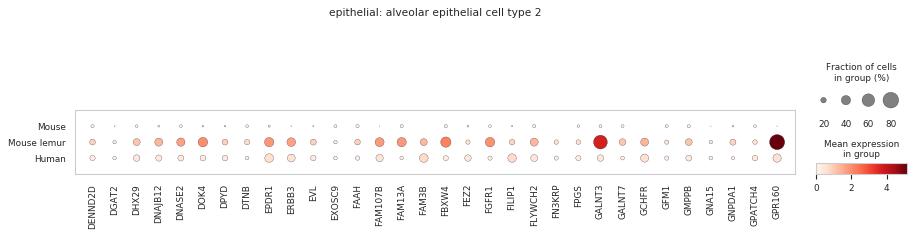

gene subset #4

------- group: epithelial: alveolar epithelial cell type 2 -------


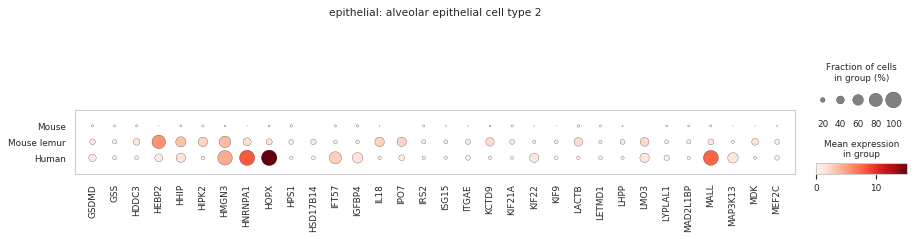

gene subset #5

------- group: epithelial: alveolar epithelial cell type 2 -------


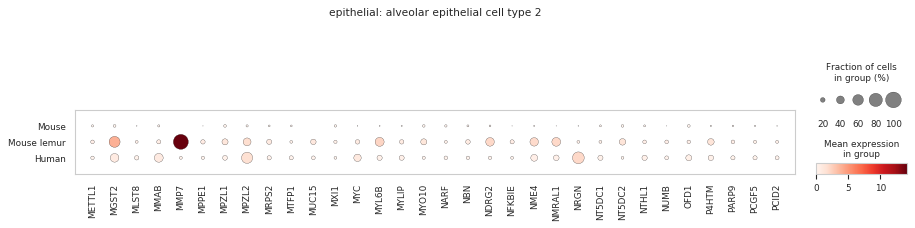

gene subset #6

------- group: epithelial: alveolar epithelial cell type 2 -------


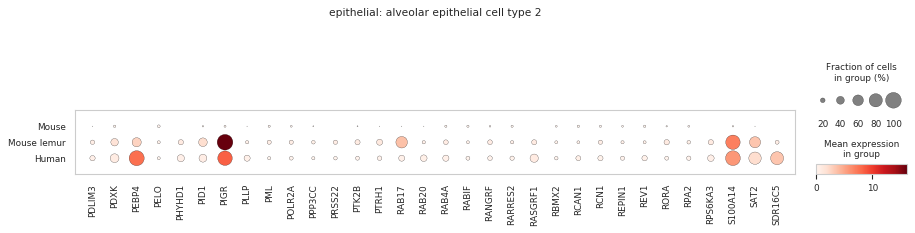

gene subset #7

------- group: epithelial: alveolar epithelial cell type 2 -------


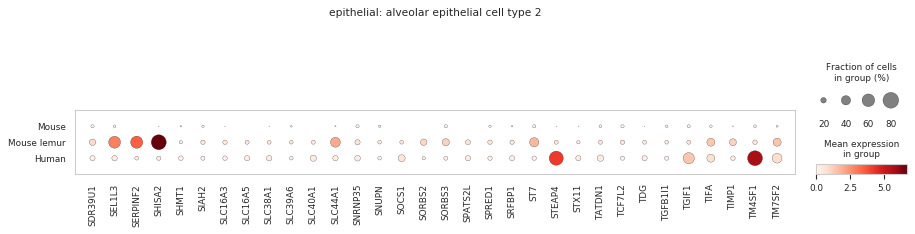

gene subset #8

------- group: epithelial: alveolar epithelial cell type 2 -------


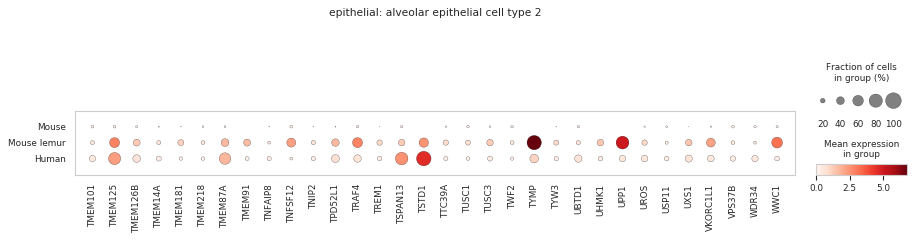

gene subset #9

------- group: epithelial: alveolar epithelial cell type 2 -------


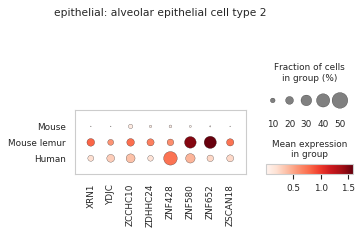

gene subset #1

------- group: stromal: alveolar fibroblast -------


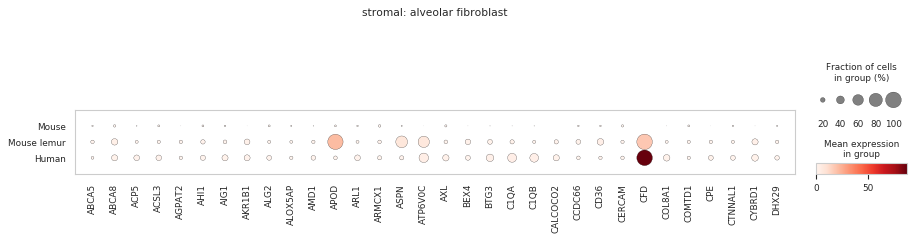

gene subset #2

------- group: stromal: alveolar fibroblast -------


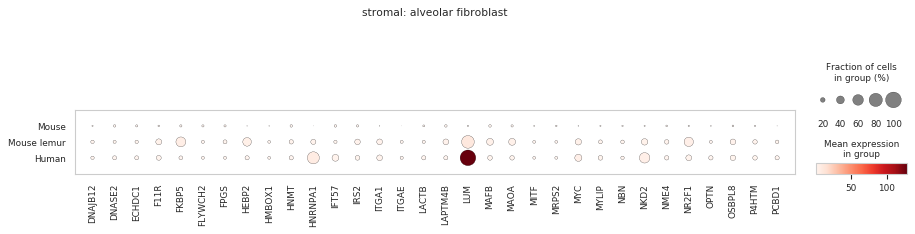

gene subset #3

------- group: stromal: alveolar fibroblast -------


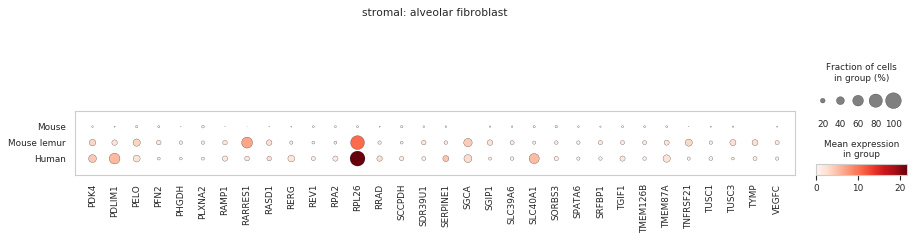

gene subset #4

------- group: stromal: alveolar fibroblast -------


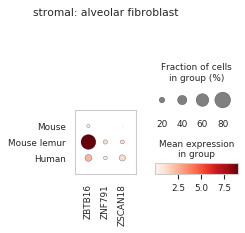

gene subset #1

------- group: myeloid: alveolar macrophage -------


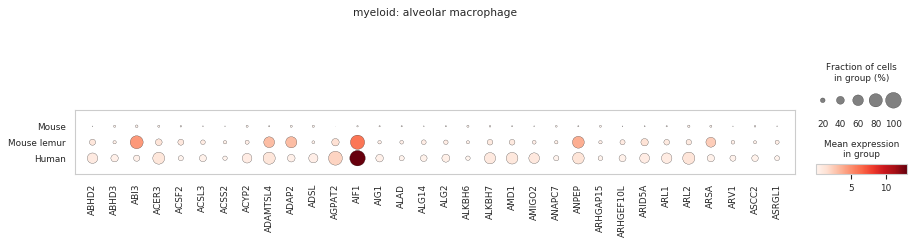

gene subset #2

------- group: myeloid: alveolar macrophage -------


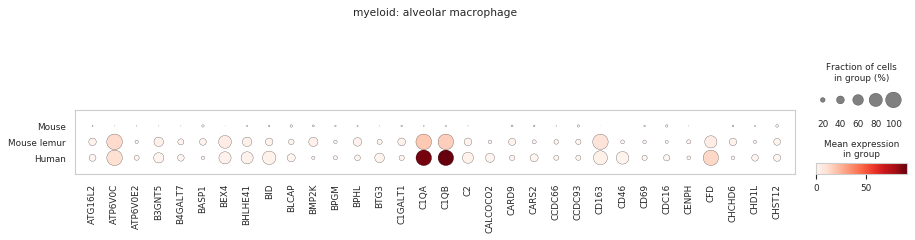

gene subset #3

------- group: myeloid: alveolar macrophage -------


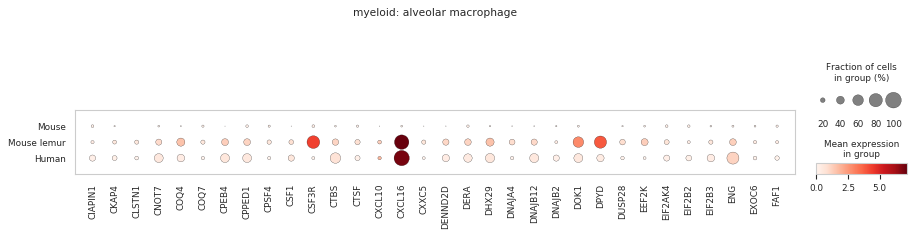

gene subset #4

------- group: myeloid: alveolar macrophage -------


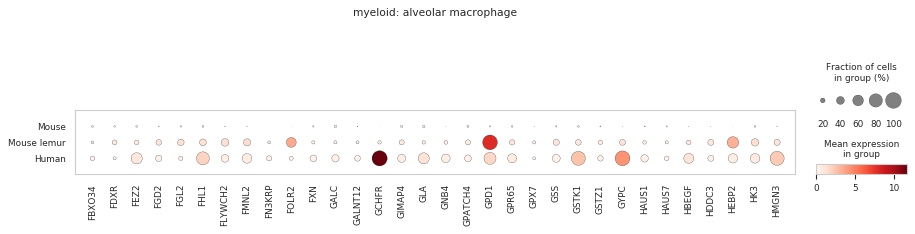

gene subset #5

------- group: myeloid: alveolar macrophage -------


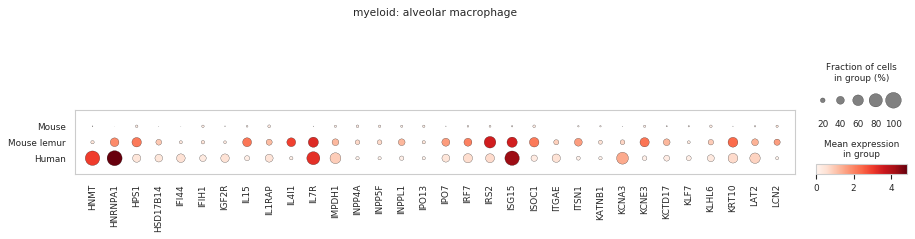

gene subset #6

------- group: myeloid: alveolar macrophage -------


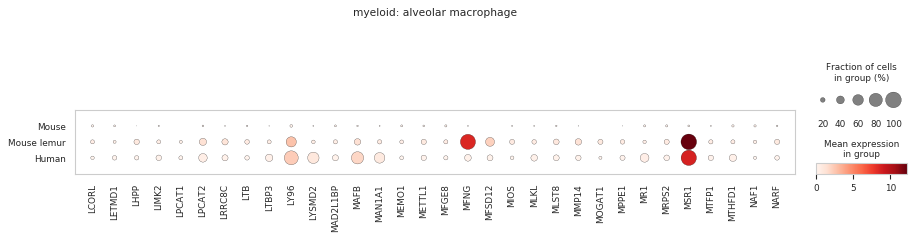

gene subset #7

------- group: myeloid: alveolar macrophage -------


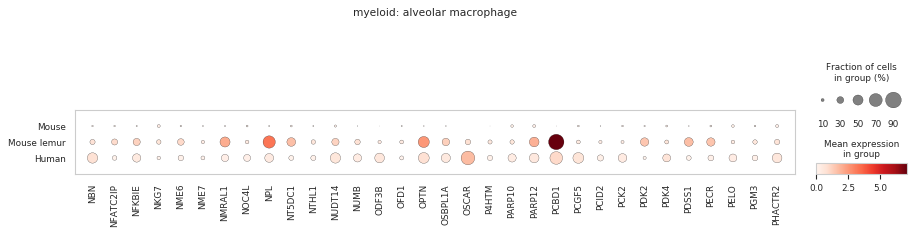

gene subset #8

------- group: myeloid: alveolar macrophage -------


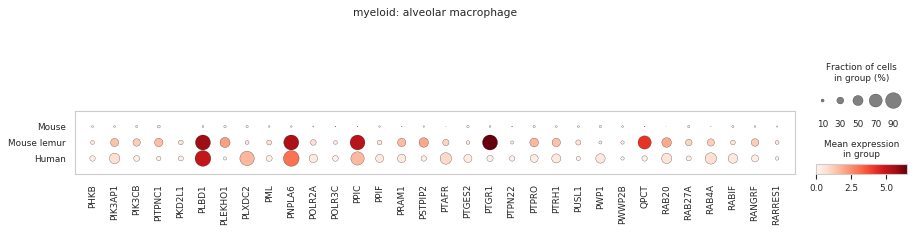

gene subset #9

------- group: myeloid: alveolar macrophage -------


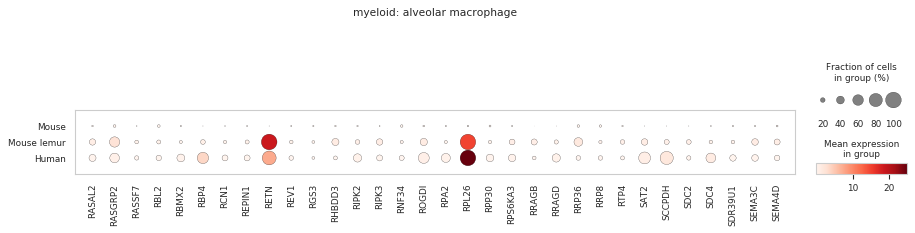

gene subset #10

------- group: myeloid: alveolar macrophage -------


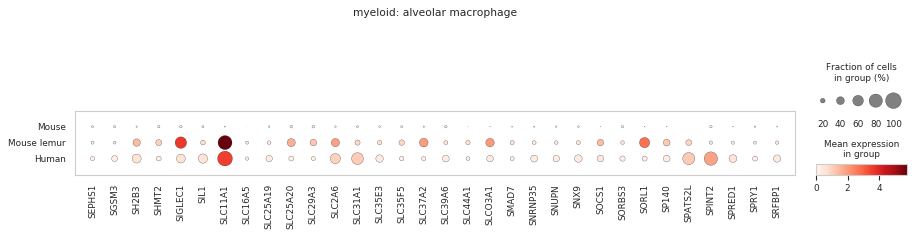

gene subset #11

------- group: myeloid: alveolar macrophage -------


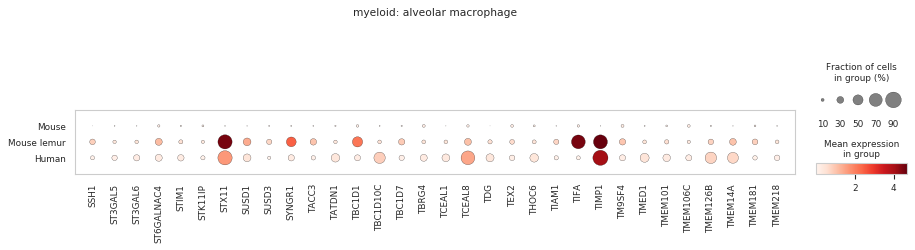

gene subset #12

------- group: myeloid: alveolar macrophage -------


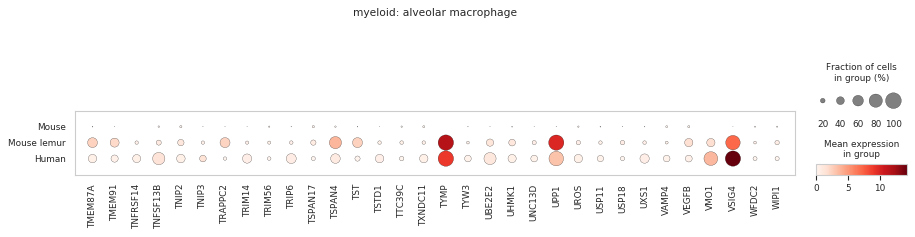

gene subset #13

------- group: myeloid: alveolar macrophage -------


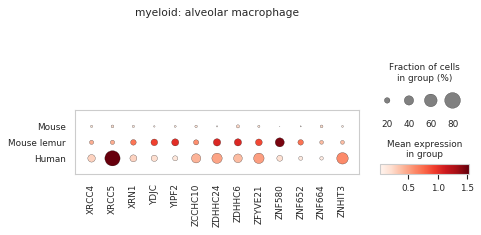

gene subset #1

------- group: endothelial: artery cell -------


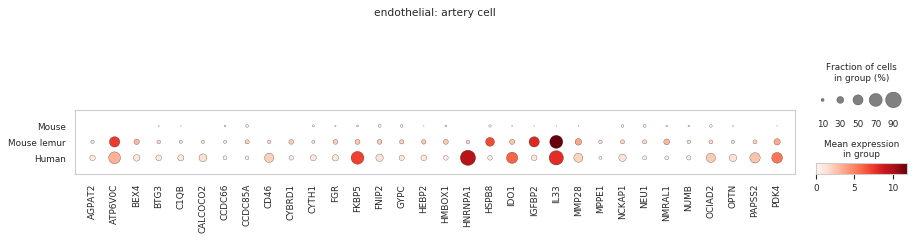

gene subset #2

------- group: endothelial: artery cell -------


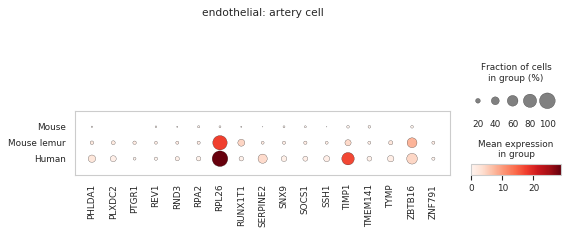

gene subset #1

------- group: endothelial: capillary aerocyte cell -------


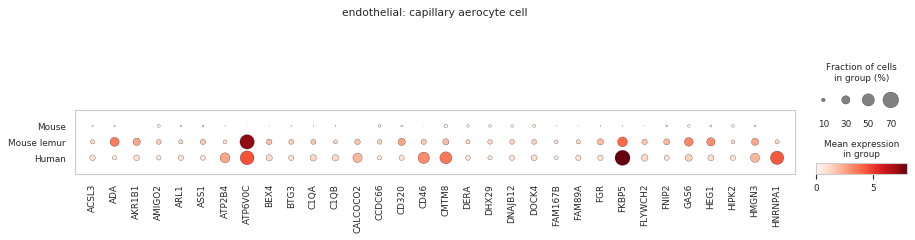

gene subset #2

------- group: endothelial: capillary aerocyte cell -------


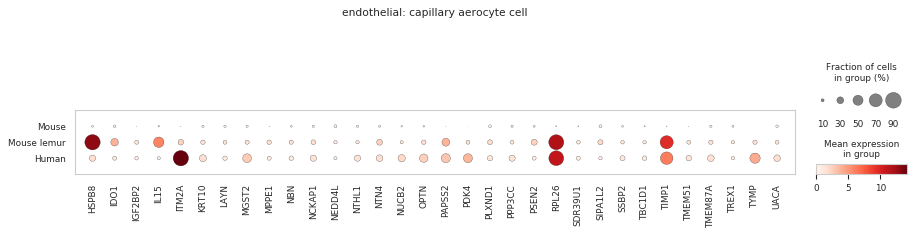

gene subset #3

------- group: endothelial: capillary aerocyte cell -------


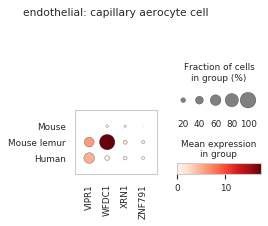

gene subset #1

------- group: endothelial: capillary cell -------


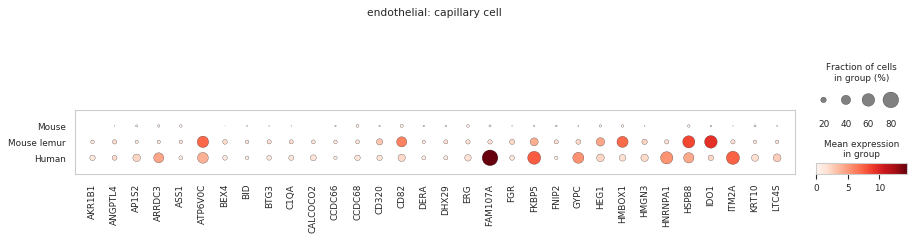

gene subset #2

------- group: endothelial: capillary cell -------


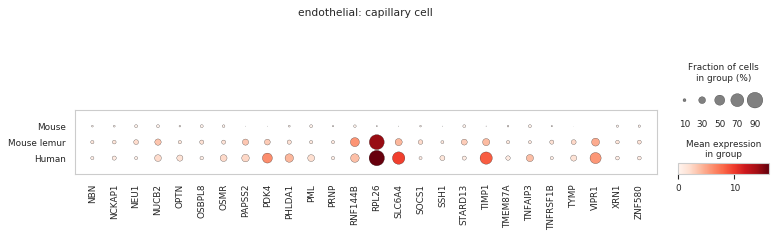

gene subset #1

------- group: epithelial: ciliated cell -------


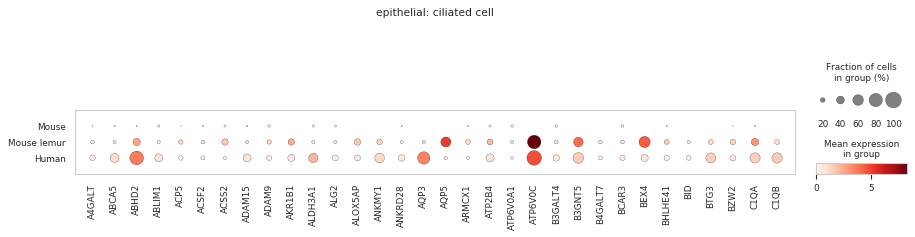

gene subset #2

------- group: epithelial: ciliated cell -------


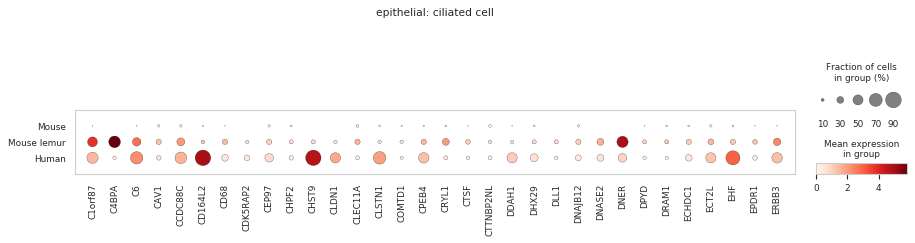

gene subset #3

------- group: epithelial: ciliated cell -------


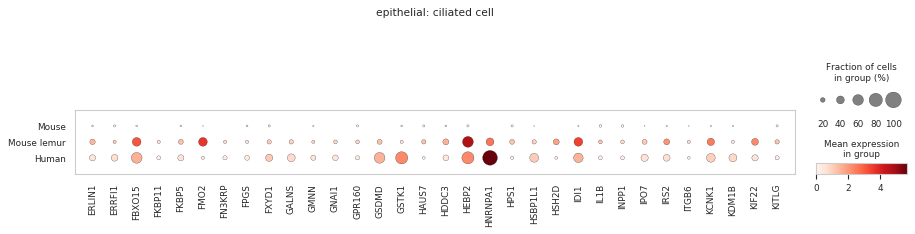

gene subset #4

------- group: epithelial: ciliated cell -------


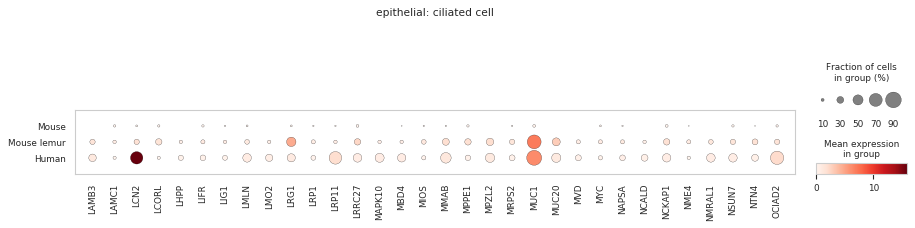

gene subset #5

------- group: epithelial: ciliated cell -------


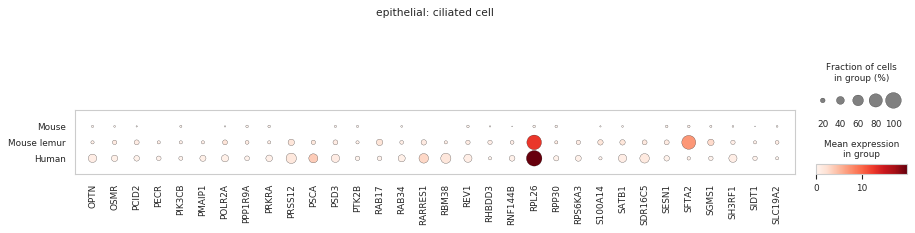

gene subset #6

------- group: epithelial: ciliated cell -------


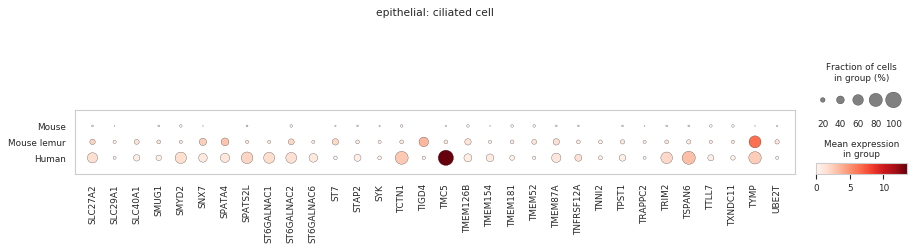

gene subset #7

------- group: epithelial: ciliated cell -------


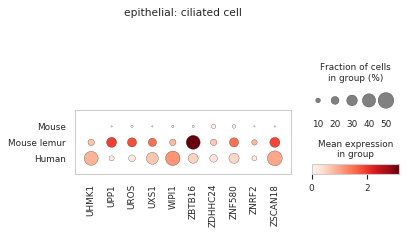

gene subset #1

------- group: myeloid: conventional dendritic cell -------


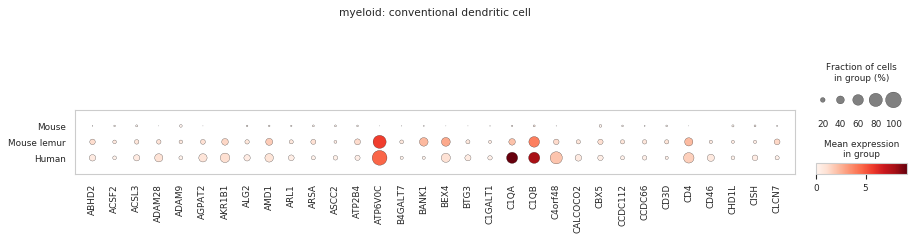

gene subset #2

------- group: myeloid: conventional dendritic cell -------


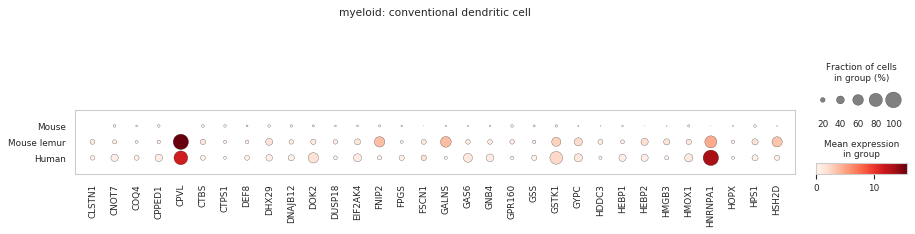

gene subset #3

------- group: myeloid: conventional dendritic cell -------


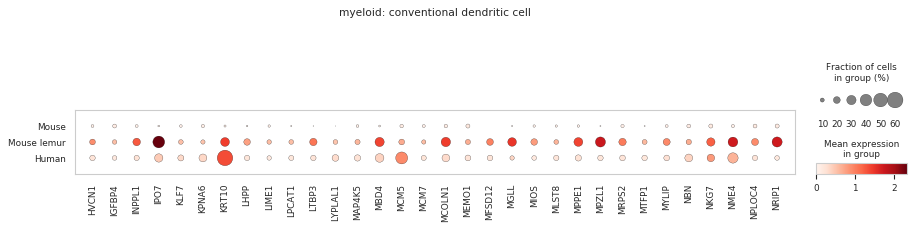

gene subset #4

------- group: myeloid: conventional dendritic cell -------


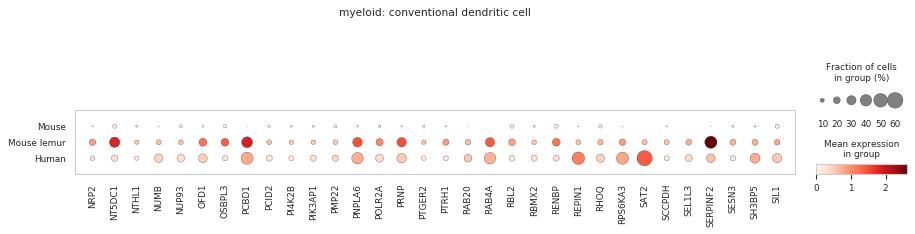

gene subset #5

------- group: myeloid: conventional dendritic cell -------


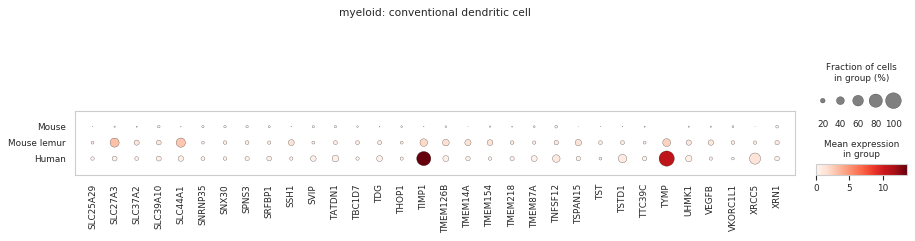

gene subset #6

------- group: myeloid: conventional dendritic cell -------


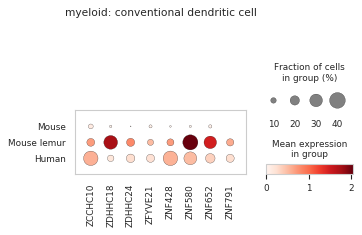

gene subset #1

------- group: endothelial: lymphatic cell -------


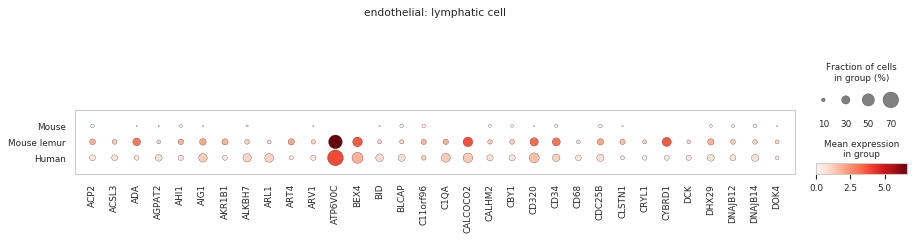

gene subset #2

------- group: endothelial: lymphatic cell -------


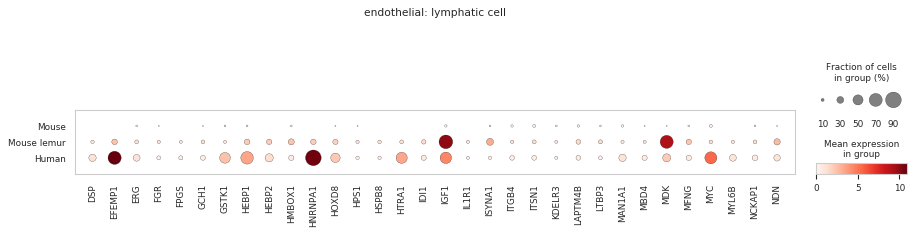

gene subset #3

------- group: endothelial: lymphatic cell -------


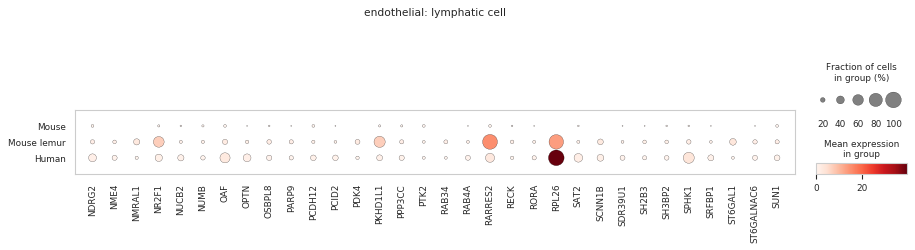

gene subset #4

------- group: endothelial: lymphatic cell -------


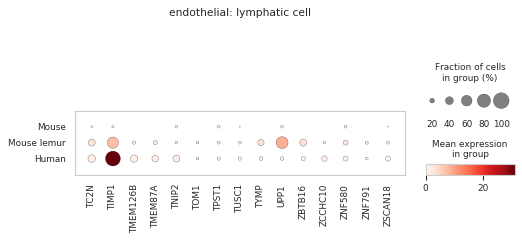

gene subset #1

------- group: myeloid: monocyte -------


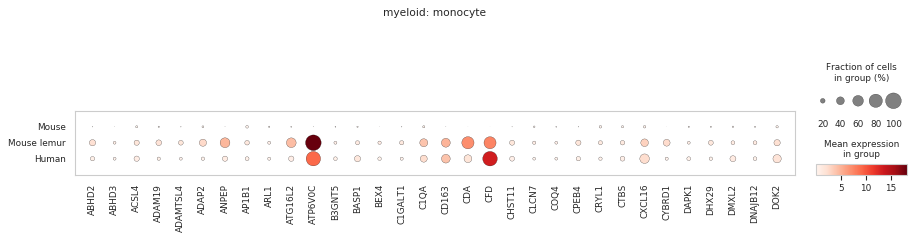

gene subset #2

------- group: myeloid: monocyte -------


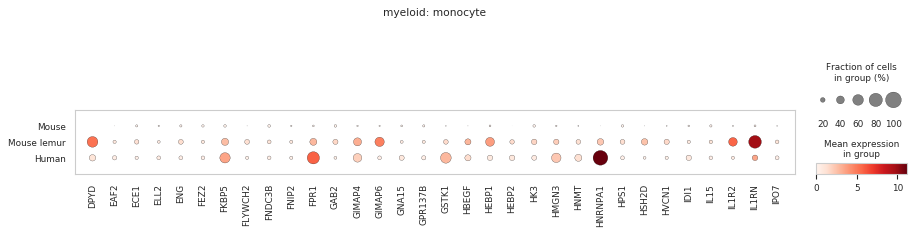

gene subset #3

------- group: myeloid: monocyte -------


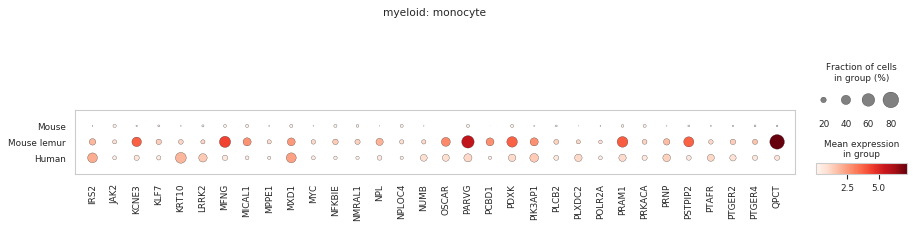

gene subset #4

------- group: myeloid: monocyte -------


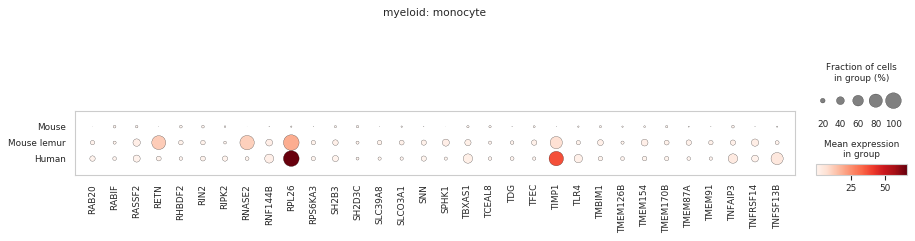

gene subset #5

------- group: myeloid: monocyte -------


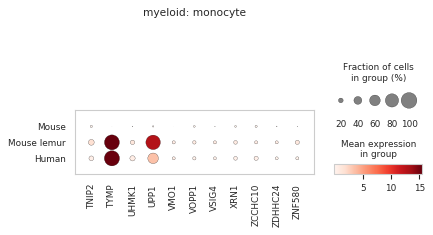

gene subset #1

------- group: lymphoid: natural killer T cell -------


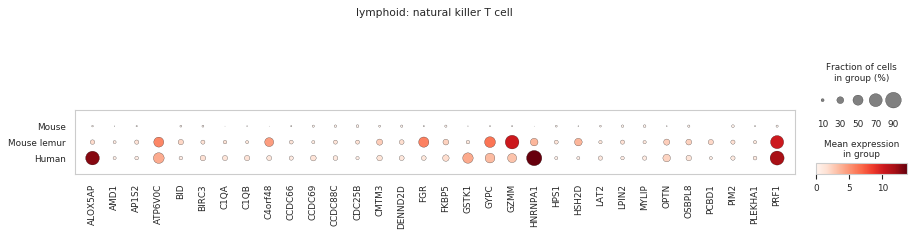

gene subset #2

------- group: lymphoid: natural killer T cell -------


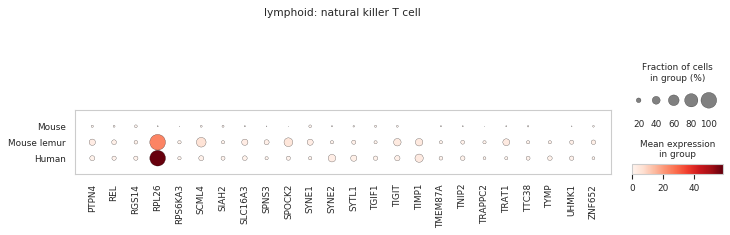

gene subset #1

------- group: lymphoid: natural killer cell -------


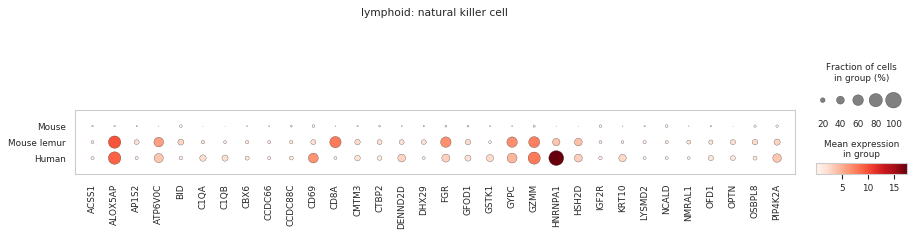

gene subset #2

------- group: lymphoid: natural killer cell -------


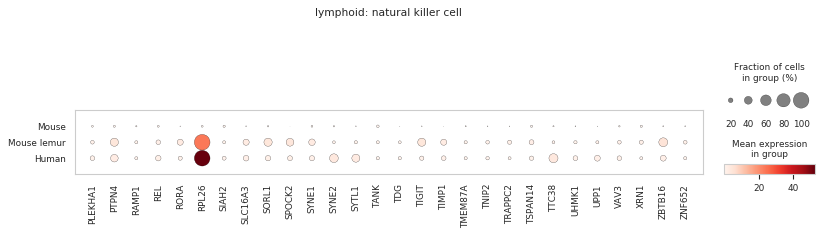

gene subset #1

------- group: stromal: pericyte cell -------


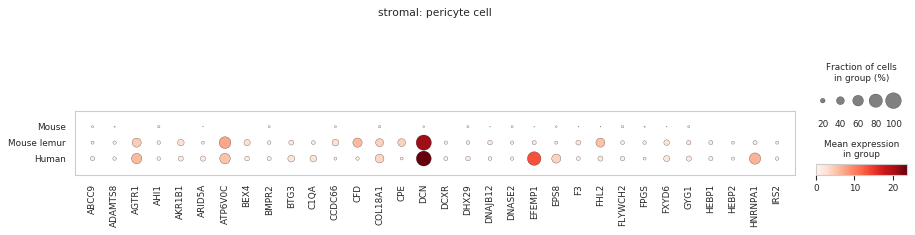

gene subset #2

------- group: stromal: pericyte cell -------


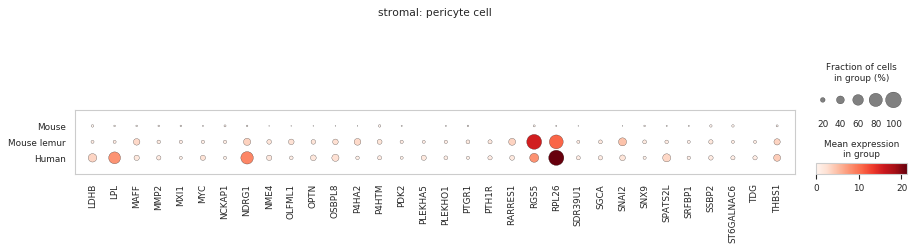

gene subset #3

------- group: stromal: pericyte cell -------


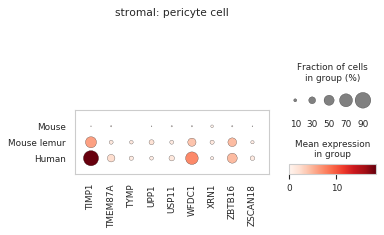

gene subset #1

------- group: lymphoid: plasma cell -------


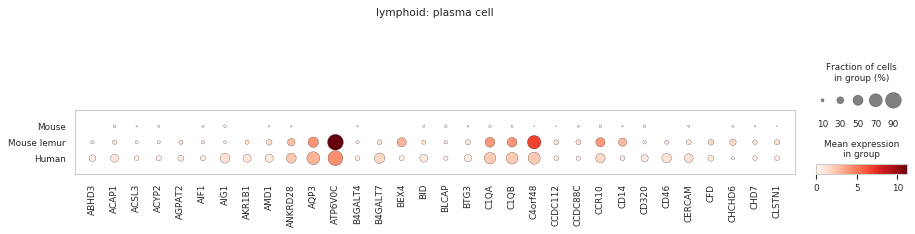

gene subset #2

------- group: lymphoid: plasma cell -------


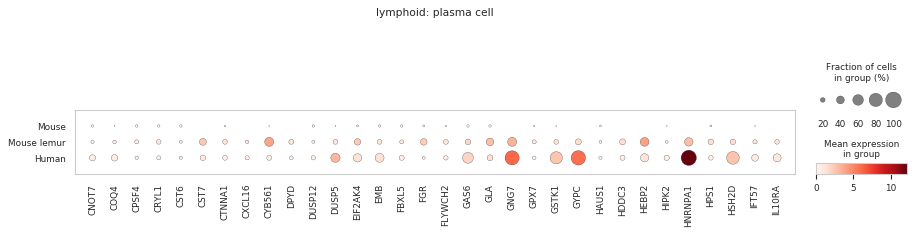

gene subset #3

------- group: lymphoid: plasma cell -------


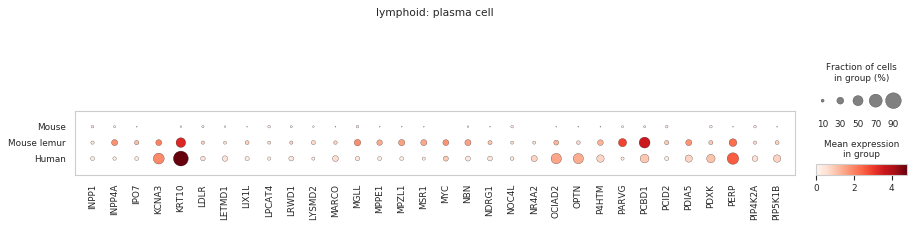

gene subset #4

------- group: lymphoid: plasma cell -------


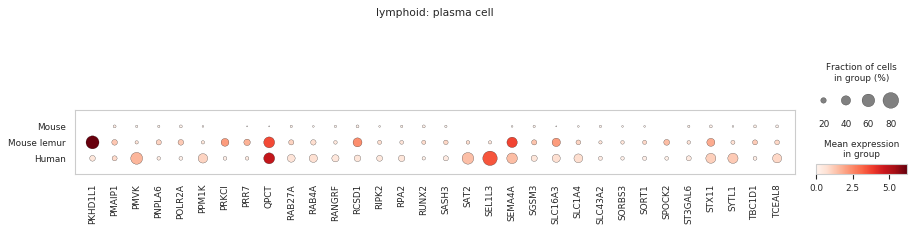

gene subset #5

------- group: lymphoid: plasma cell -------


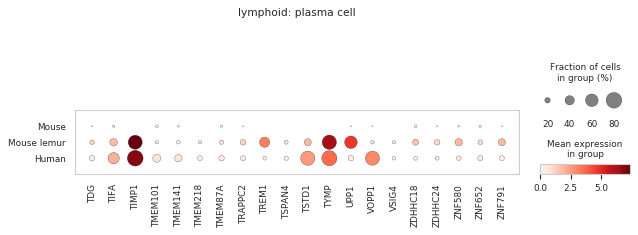

gene subset #1

------- group: myeloid: plasmacytoid dendritic cell -------


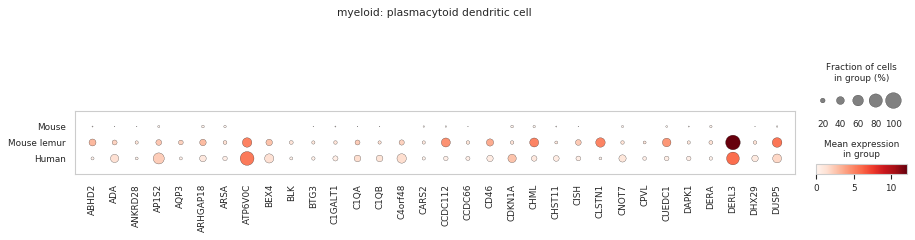

gene subset #2

------- group: myeloid: plasmacytoid dendritic cell -------


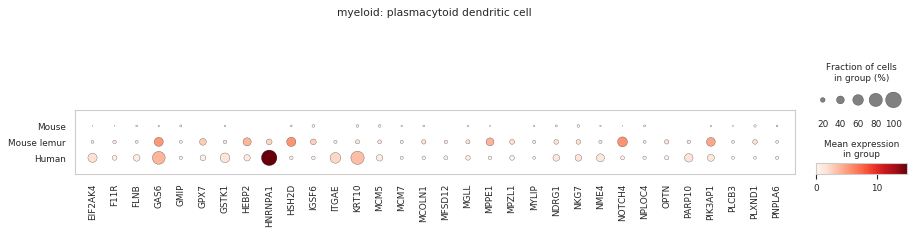

gene subset #3

------- group: myeloid: plasmacytoid dendritic cell -------


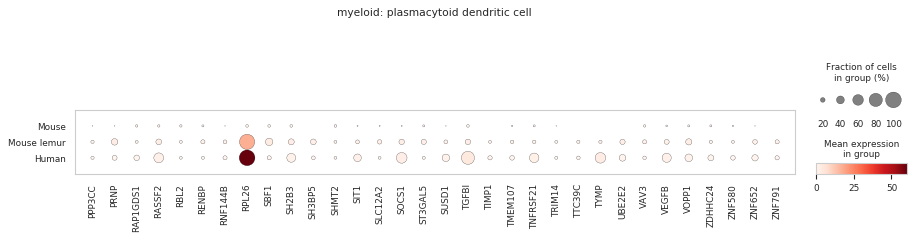

gene subset #1

------- group: myeloid: proliferating alveolar macrophage -------


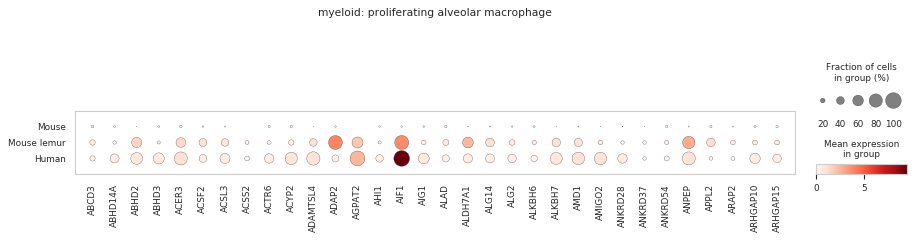

gene subset #2

------- group: myeloid: proliferating alveolar macrophage -------


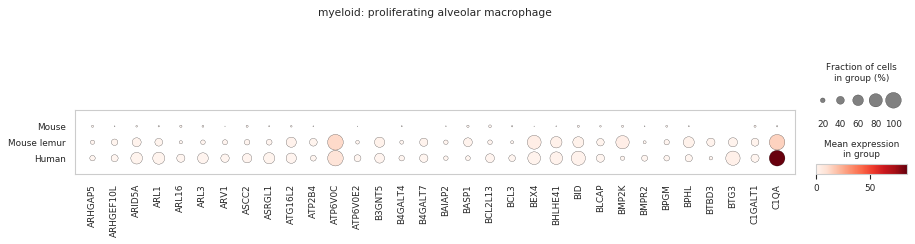

gene subset #3

------- group: myeloid: proliferating alveolar macrophage -------


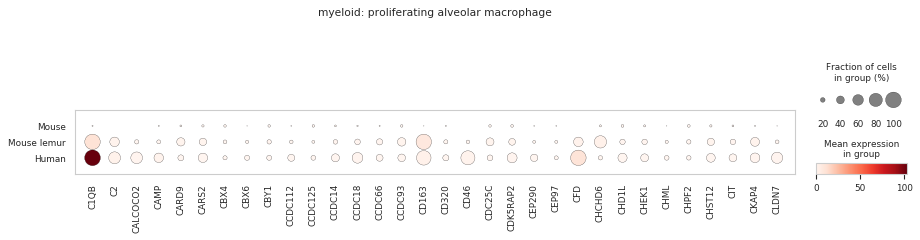

gene subset #4

------- group: myeloid: proliferating alveolar macrophage -------


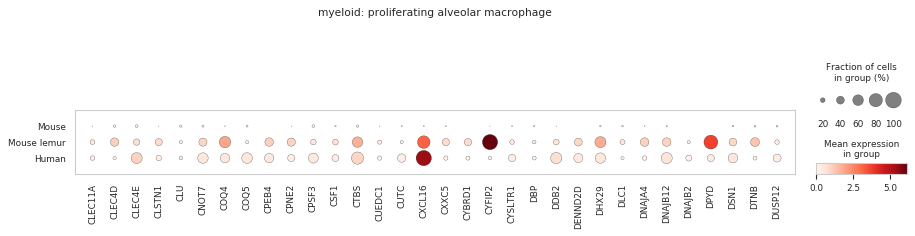

gene subset #5

------- group: myeloid: proliferating alveolar macrophage -------


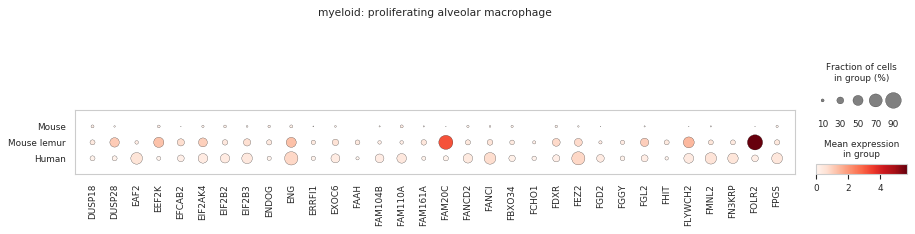

gene subset #6

------- group: myeloid: proliferating alveolar macrophage -------


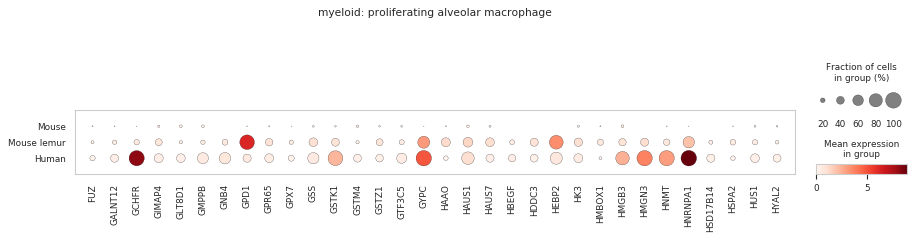

gene subset #7

------- group: myeloid: proliferating alveolar macrophage -------


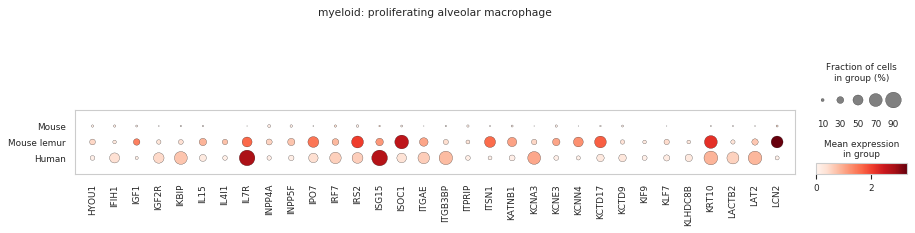

gene subset #8

------- group: myeloid: proliferating alveolar macrophage -------


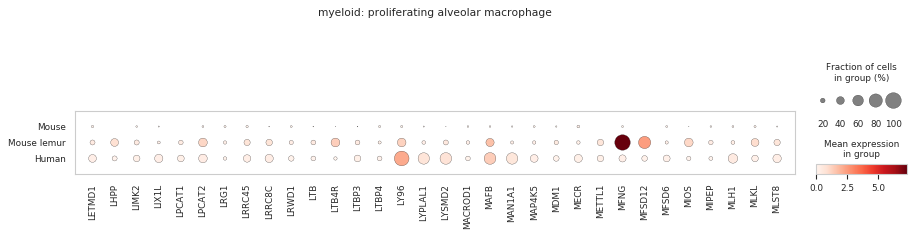

gene subset #9

------- group: myeloid: proliferating alveolar macrophage -------


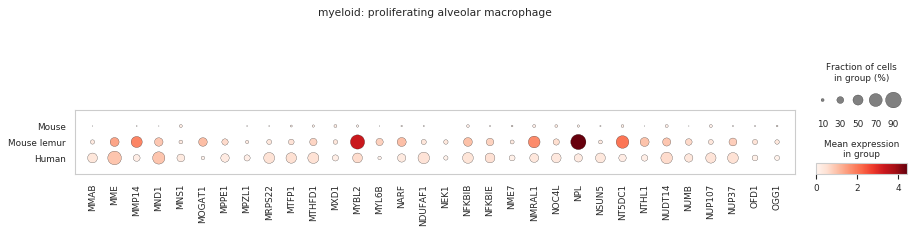

gene subset #10

------- group: myeloid: proliferating alveolar macrophage -------


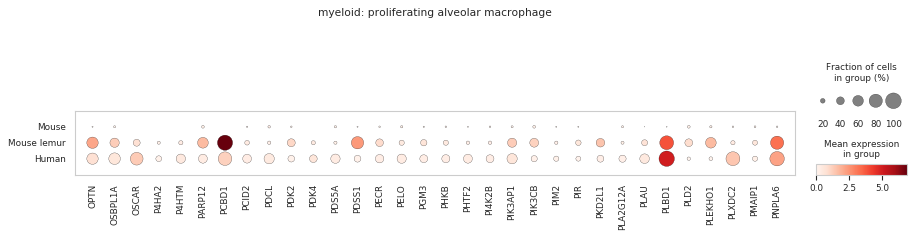

gene subset #11

------- group: myeloid: proliferating alveolar macrophage -------


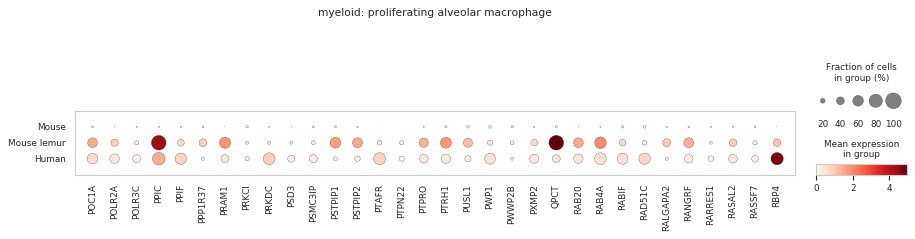

gene subset #12

------- group: myeloid: proliferating alveolar macrophage -------


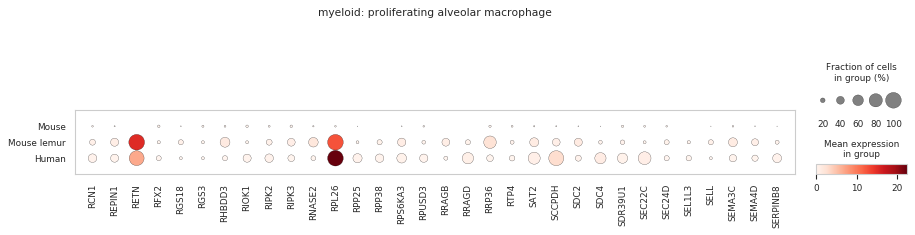

gene subset #13

------- group: myeloid: proliferating alveolar macrophage -------


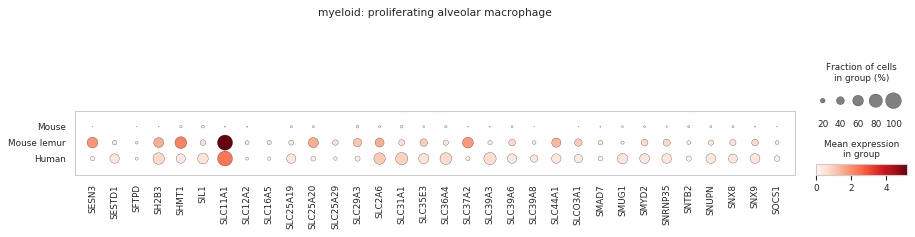

gene subset #14

------- group: myeloid: proliferating alveolar macrophage -------


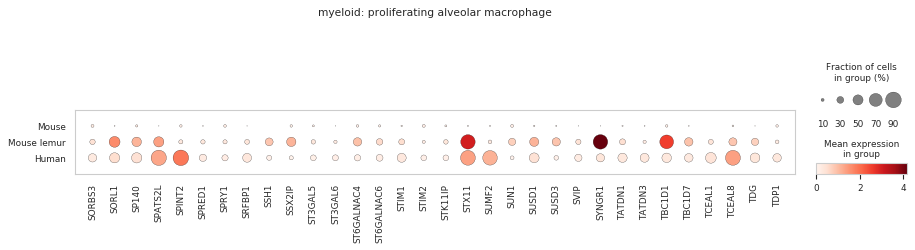

gene subset #15

------- group: myeloid: proliferating alveolar macrophage -------


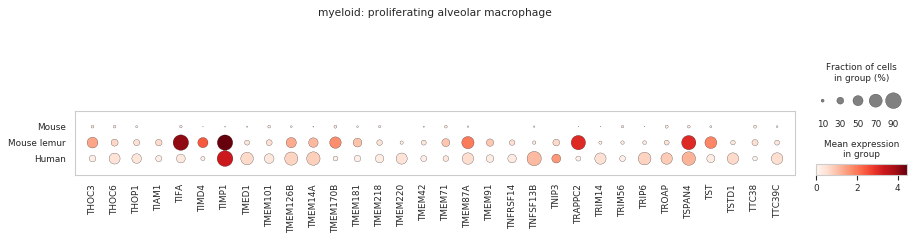

gene subset #16

------- group: myeloid: proliferating alveolar macrophage -------


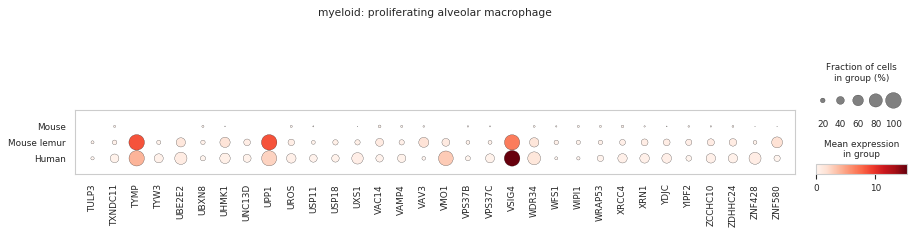

gene subset #17

------- group: myeloid: proliferating alveolar macrophage -------


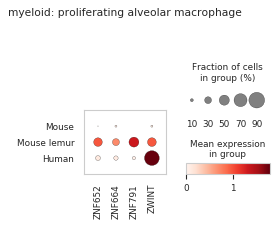

gene subset #1

------- group: lymphoid: proliferating natural killer cell_T cell -------


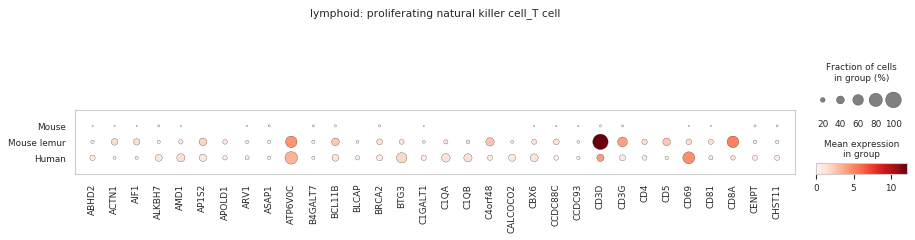

gene subset #2

------- group: lymphoid: proliferating natural killer cell_T cell -------


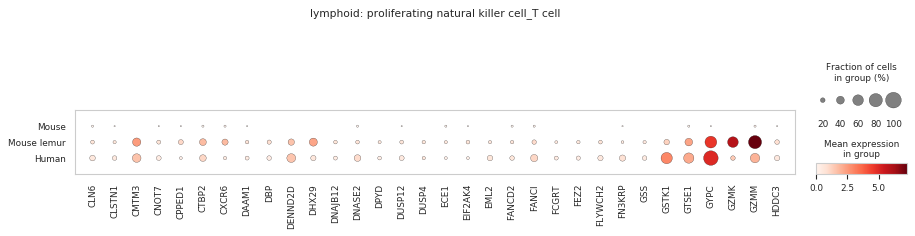

gene subset #3

------- group: lymphoid: proliferating natural killer cell_T cell -------


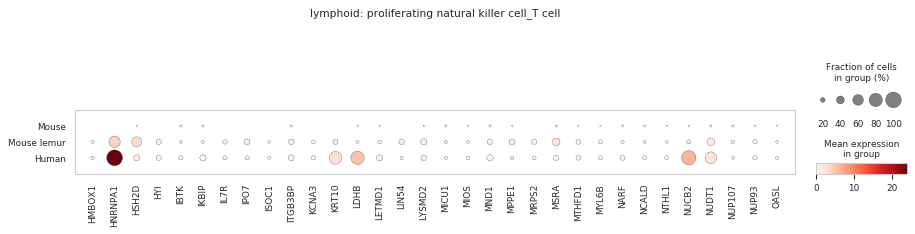

gene subset #4

------- group: lymphoid: proliferating natural killer cell_T cell -------


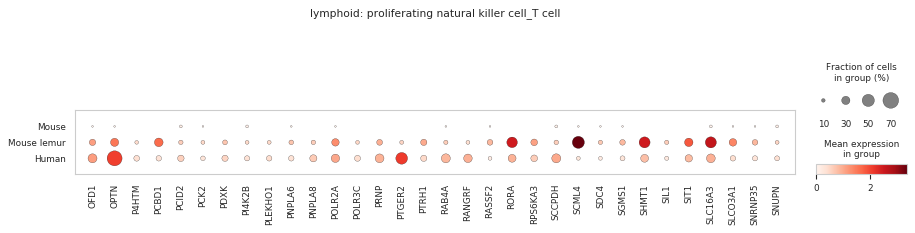

gene subset #5

------- group: lymphoid: proliferating natural killer cell_T cell -------


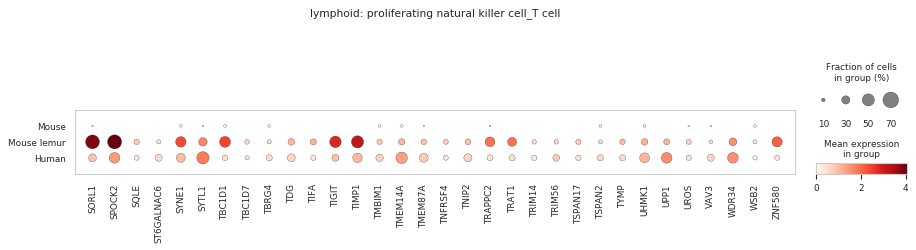

gene subset #6

------- group: lymphoid: proliferating natural killer cell_T cell -------


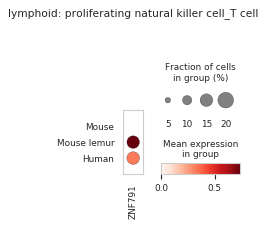

gene subset #1

------- group: endothelial: vein cell -------


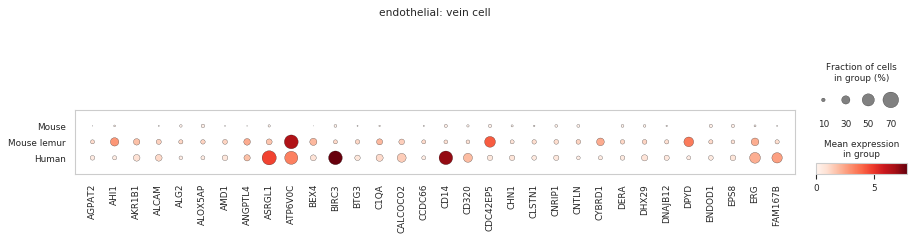

gene subset #2

------- group: endothelial: vein cell -------


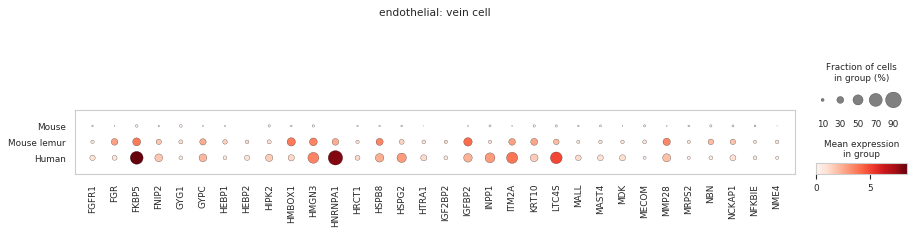

gene subset #3

------- group: endothelial: vein cell -------


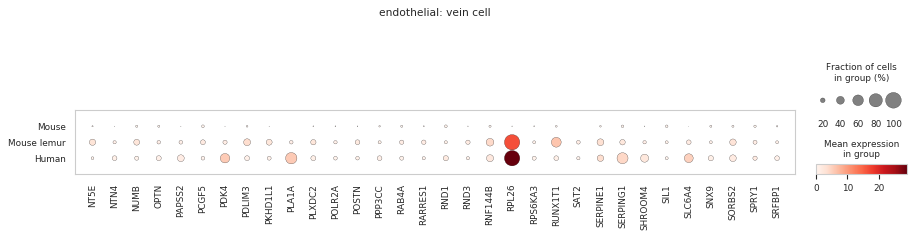

gene subset #4

------- group: endothelial: vein cell -------


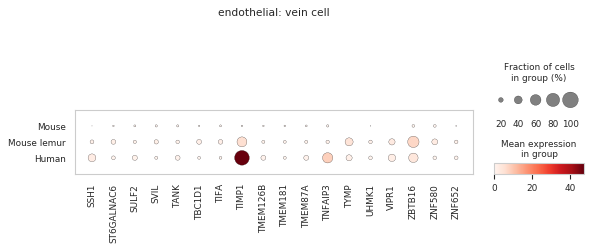

In [39]:
for col_name, col_values in genes_in_primate_enriched_celltypes_binary.iteritems():
    gene_names = col_values[col_values].index
    col_name_sanitized = xspecies.sanitize(col_name)
    
    compartment_narrow_col = narrow_to_compartment_narrrow[col_name]
    cross_species.dotplots(
        gene_names,
        save=f"__binary__{col_name_sanitized}",
        select_group=compartment_narrow_col,
        save_format="pdf",
        max_genes=32,
    )

## Dotplots of primate-enriched genes, no dissociation genes

### Get list of dissociation genes

In [40]:
dissociation_genes = set(pd.read_csv('/home/olga/data_lg/data_sm_copy/immune-evolution/databases/nuisance-genes/dissociation_genes_3Nov2020.csv', index_col=0, squeeze=True))
len(dissociation_genes)

1880

### Primate-enriched genes from binarized analyses, minus dissocaition genes

gene subset #1

------- group: lymphoid: B cell -------


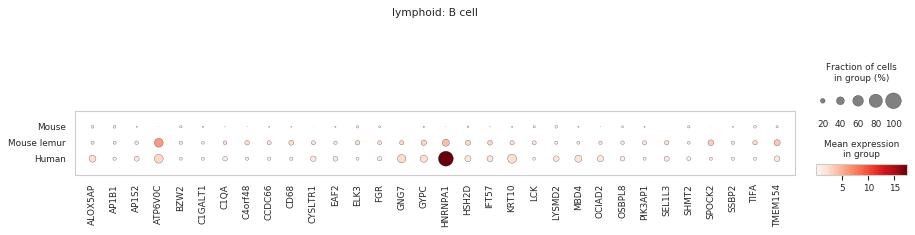

gene subset #2

------- group: lymphoid: B cell -------


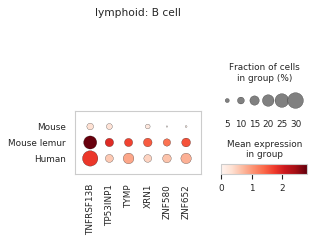

gene subset #1

------- group: lymphoid: CD4+ T cell -------


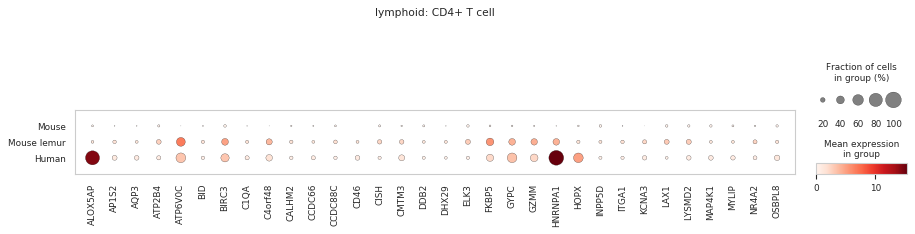

gene subset #2

------- group: lymphoid: CD4+ T cell -------


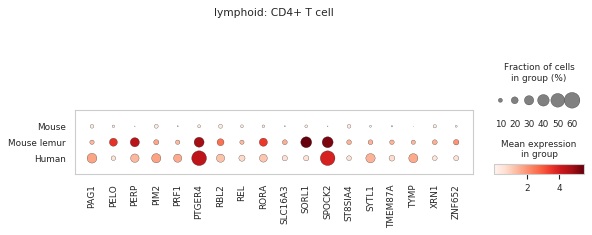

gene subset #1

------- group: lymphoid: CD8+ T cell -------


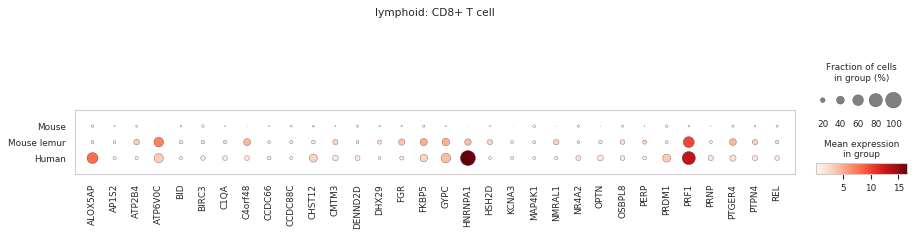

gene subset #2

------- group: lymphoid: CD8+ T cell -------


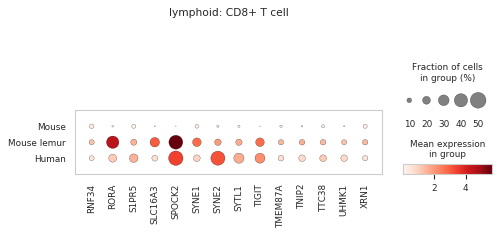

gene subset #1

------- group: stromal: adventitial fibroblast -------


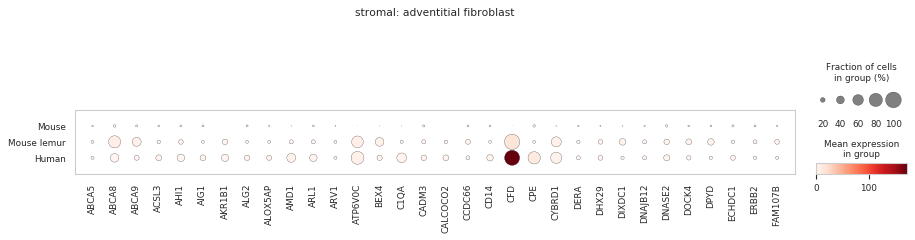

gene subset #2

------- group: stromal: adventitial fibroblast -------


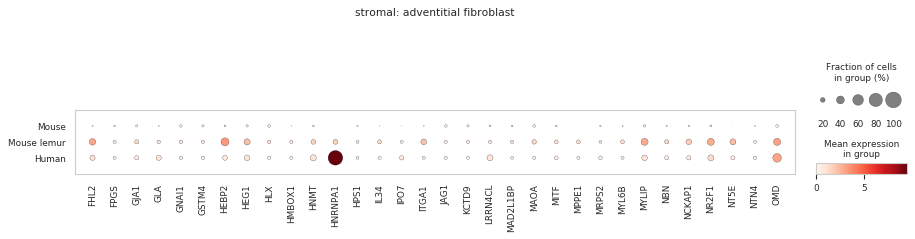

gene subset #3

------- group: stromal: adventitial fibroblast -------


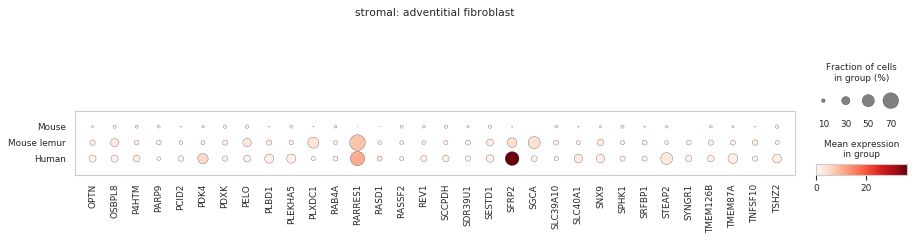

gene subset #4

------- group: stromal: adventitial fibroblast -------


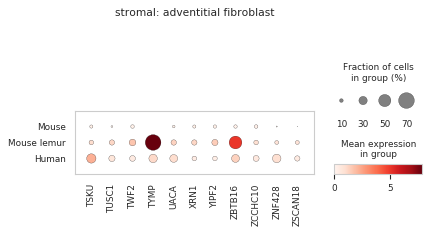

gene subset #1

------- group: epithelial: alveolar epithelial cell type 2 -------


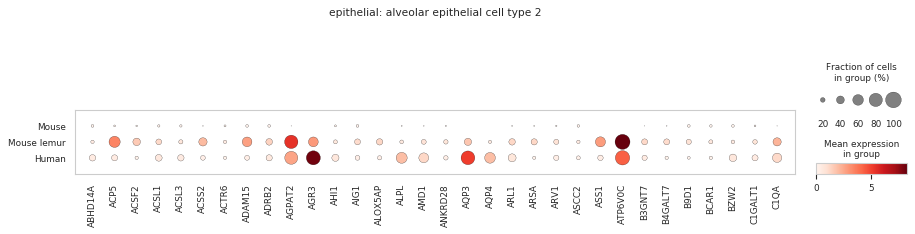

gene subset #2

------- group: epithelial: alveolar epithelial cell type 2 -------


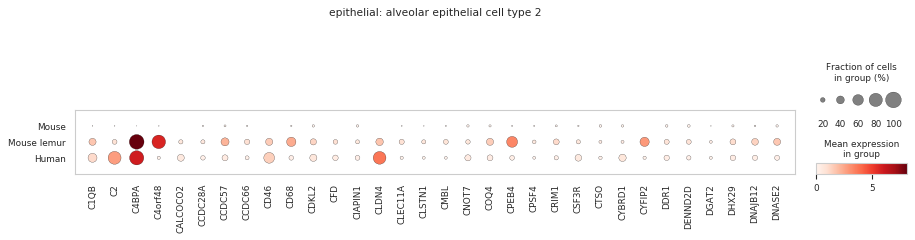

gene subset #3

------- group: epithelial: alveolar epithelial cell type 2 -------


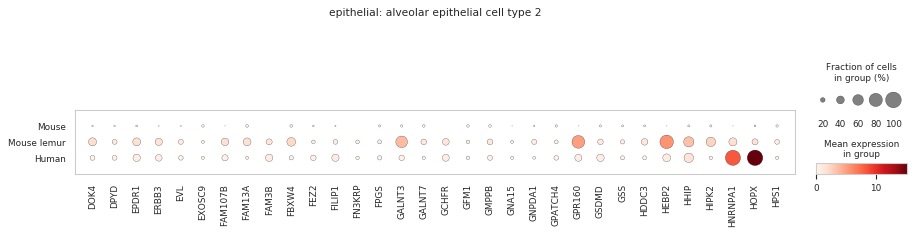

gene subset #4

------- group: epithelial: alveolar epithelial cell type 2 -------


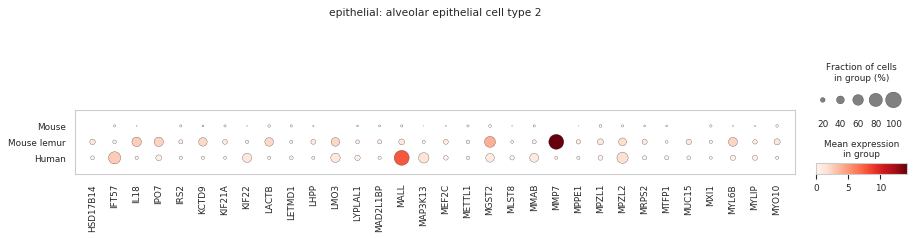

gene subset #5

------- group: epithelial: alveolar epithelial cell type 2 -------


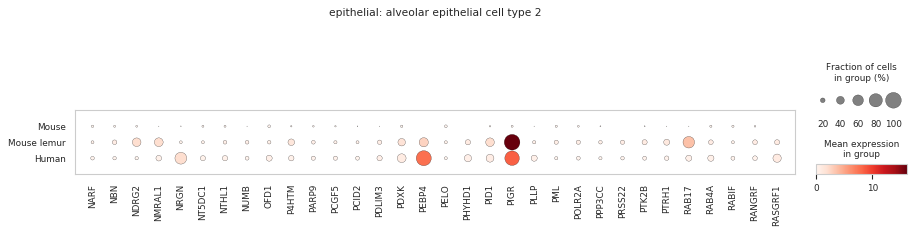

gene subset #6

------- group: epithelial: alveolar epithelial cell type 2 -------


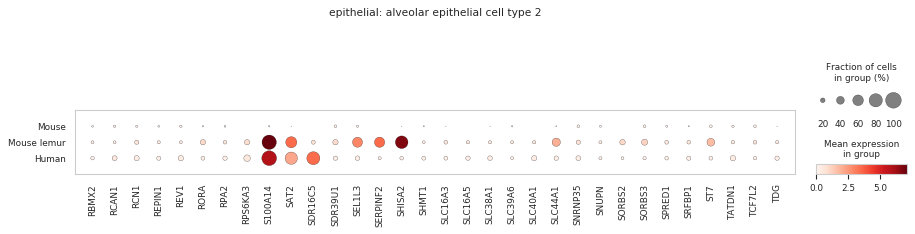

gene subset #7

------- group: epithelial: alveolar epithelial cell type 2 -------


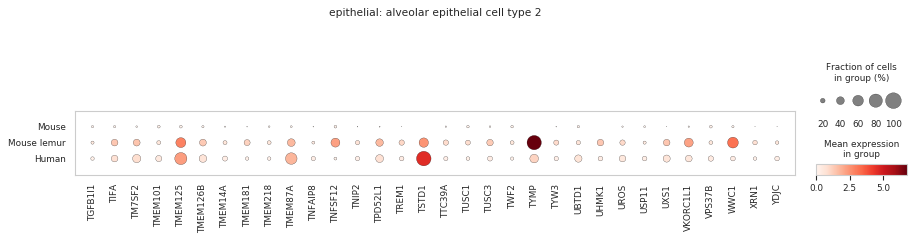

gene subset #8

------- group: epithelial: alveolar epithelial cell type 2 -------


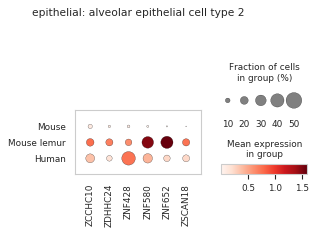

gene subset #1

------- group: stromal: alveolar fibroblast -------


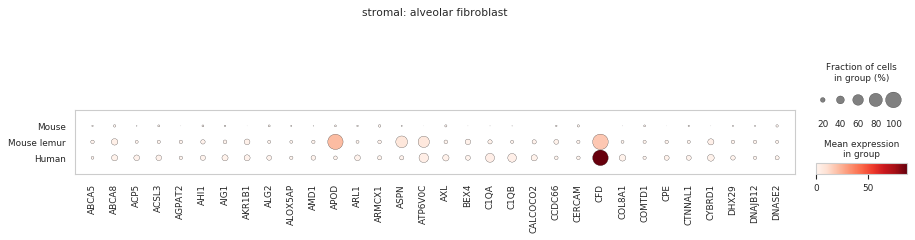

gene subset #2

------- group: stromal: alveolar fibroblast -------


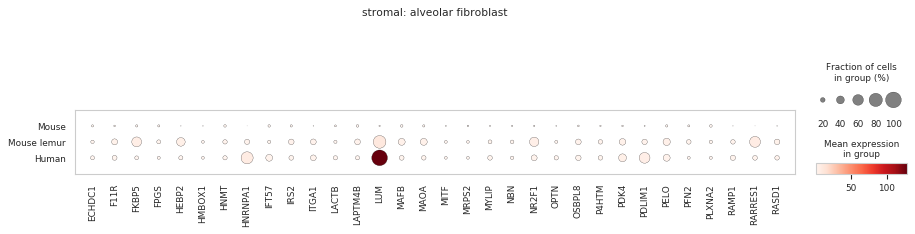

gene subset #3

------- group: stromal: alveolar fibroblast -------


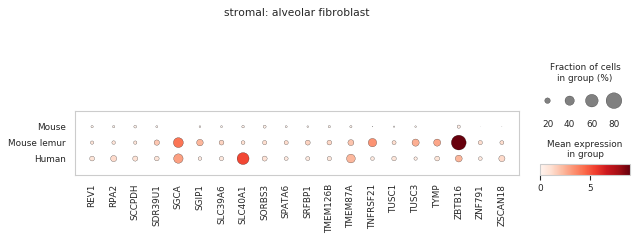

gene subset #1

------- group: myeloid: alveolar macrophage -------


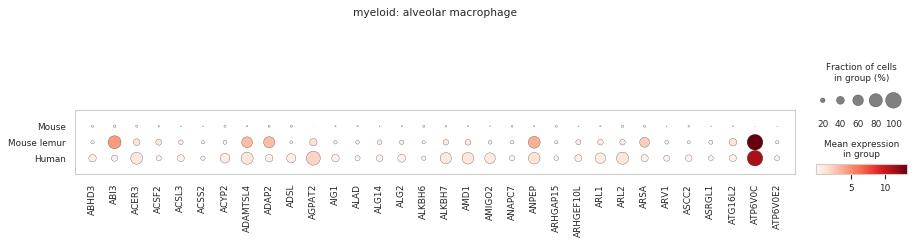

gene subset #2

------- group: myeloid: alveolar macrophage -------


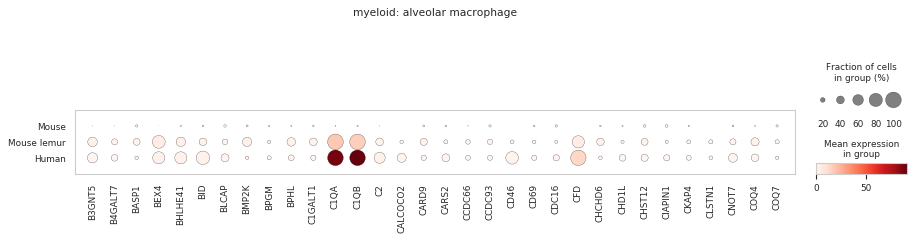

gene subset #3

------- group: myeloid: alveolar macrophage -------


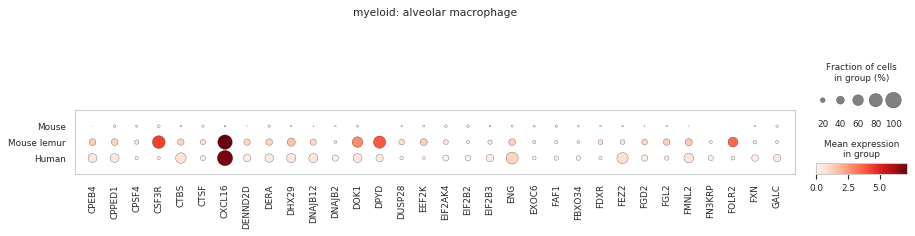

gene subset #4

------- group: myeloid: alveolar macrophage -------


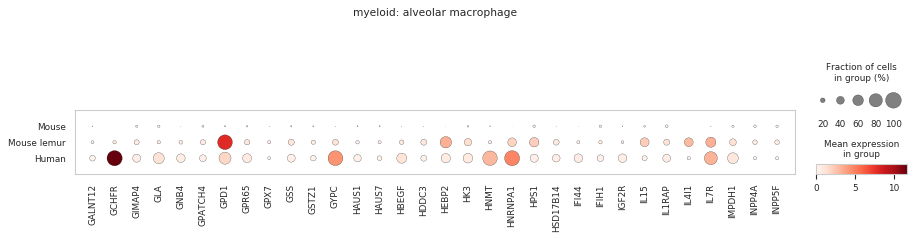

gene subset #5

------- group: myeloid: alveolar macrophage -------


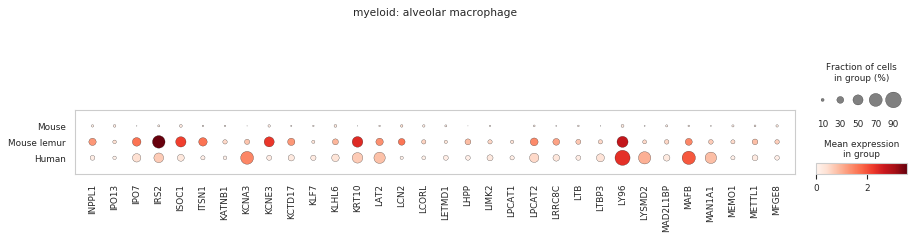

gene subset #6

------- group: myeloid: alveolar macrophage -------


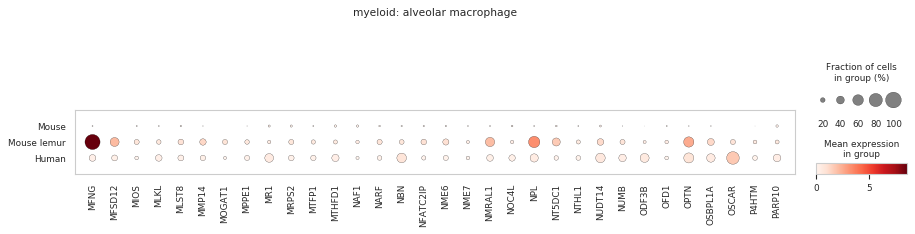

gene subset #7

------- group: myeloid: alveolar macrophage -------


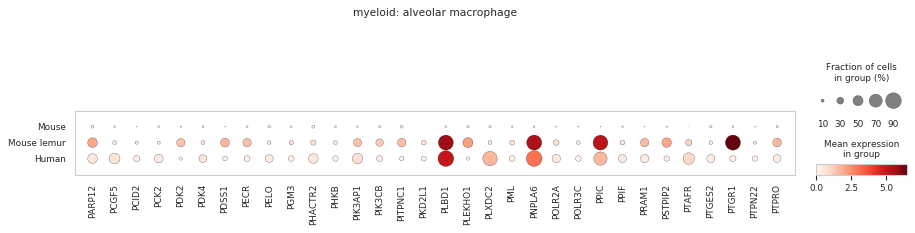

gene subset #8

------- group: myeloid: alveolar macrophage -------


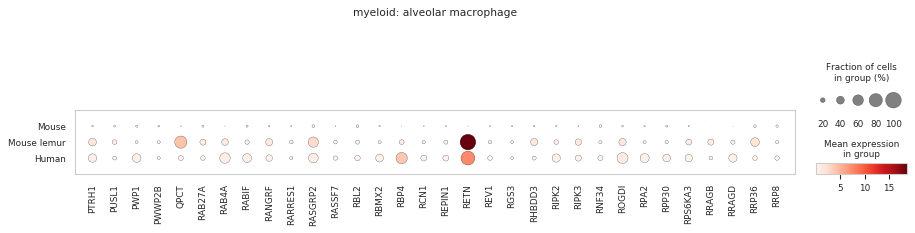

gene subset #9

------- group: myeloid: alveolar macrophage -------


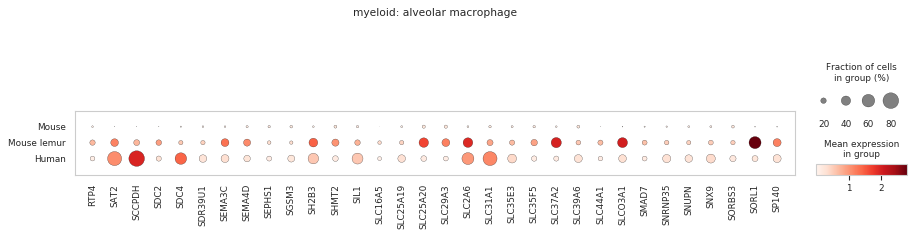

gene subset #10

------- group: myeloid: alveolar macrophage -------


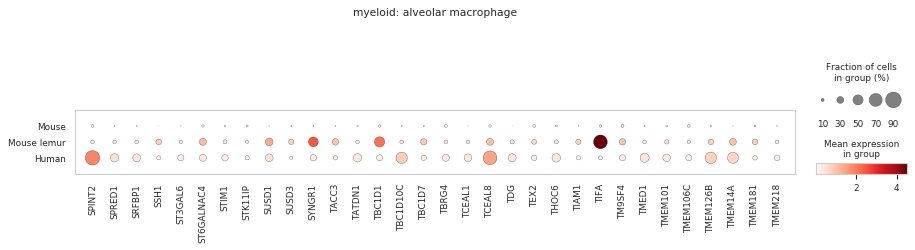

gene subset #11

------- group: myeloid: alveolar macrophage -------


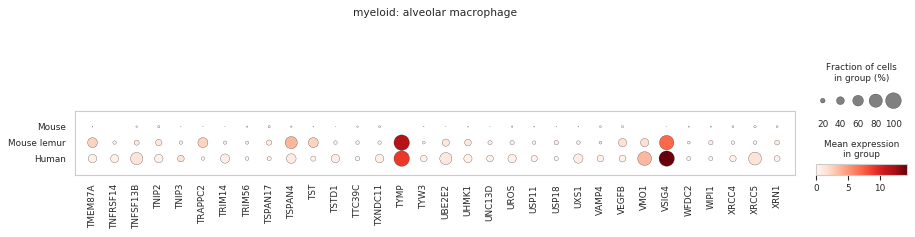

gene subset #12

------- group: myeloid: alveolar macrophage -------


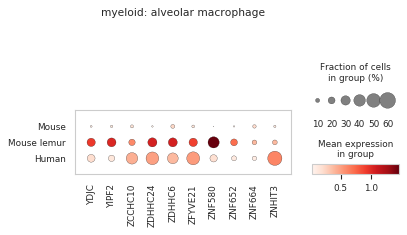

gene subset #1

------- group: endothelial: artery cell -------


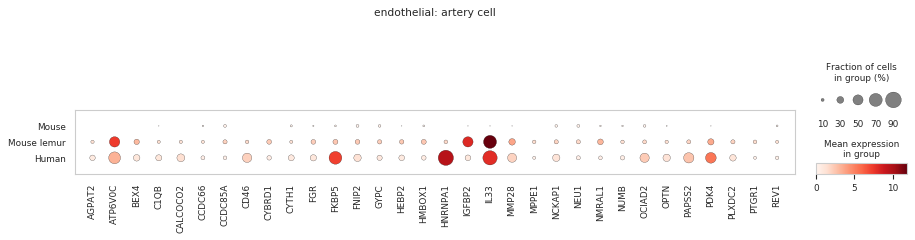

gene subset #2

------- group: endothelial: artery cell -------


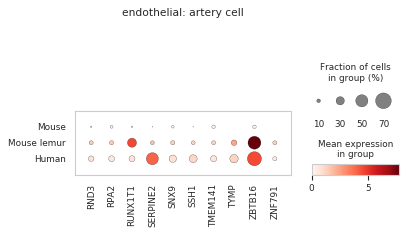

gene subset #1

------- group: endothelial: capillary aerocyte cell -------


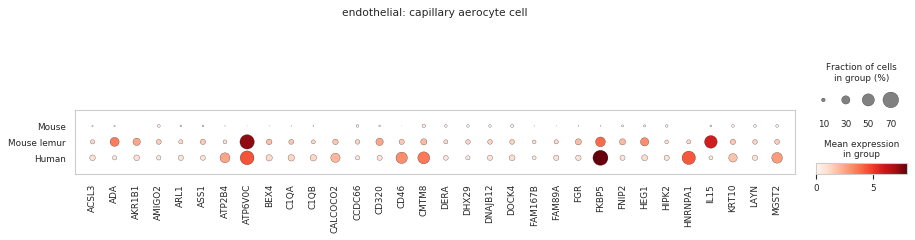

gene subset #2

------- group: endothelial: capillary aerocyte cell -------


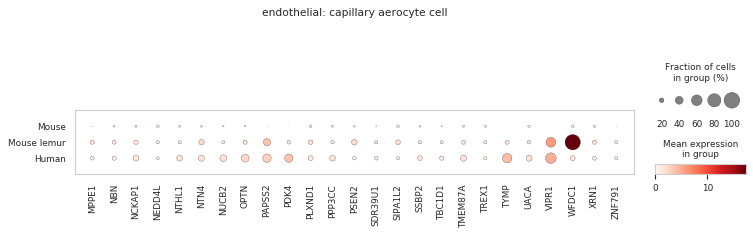

gene subset #1

------- group: endothelial: capillary cell -------


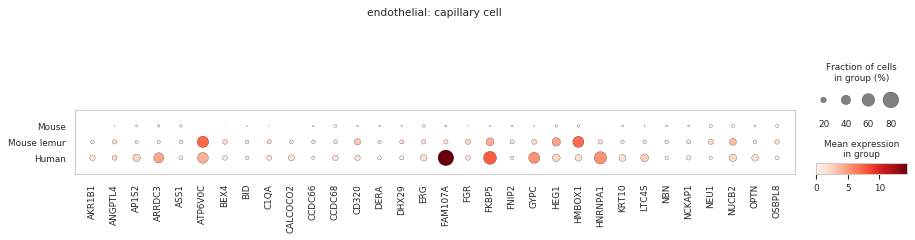

gene subset #2

------- group: endothelial: capillary cell -------


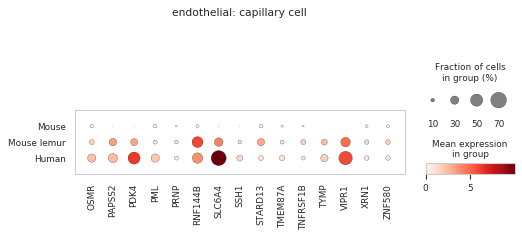

gene subset #1

------- group: epithelial: ciliated cell -------


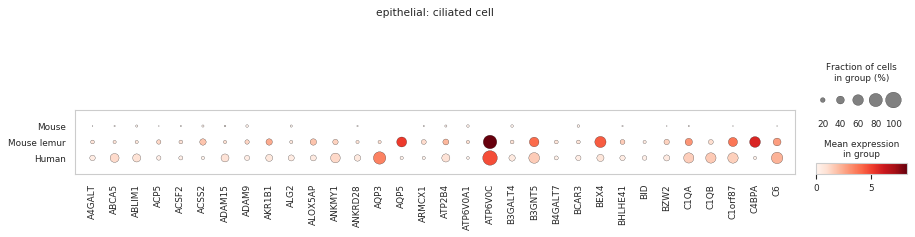

gene subset #2

------- group: epithelial: ciliated cell -------


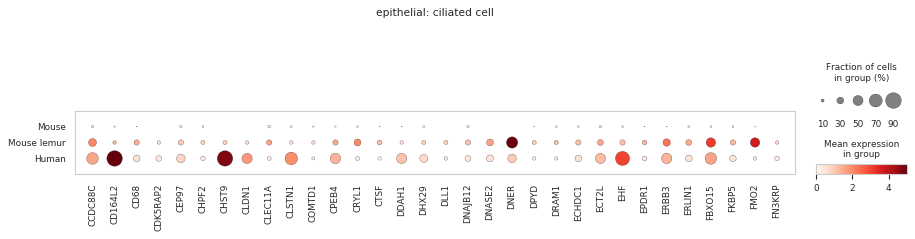

gene subset #3

------- group: epithelial: ciliated cell -------


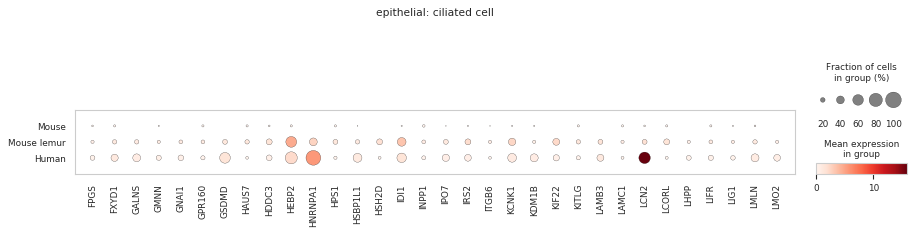

gene subset #4

------- group: epithelial: ciliated cell -------


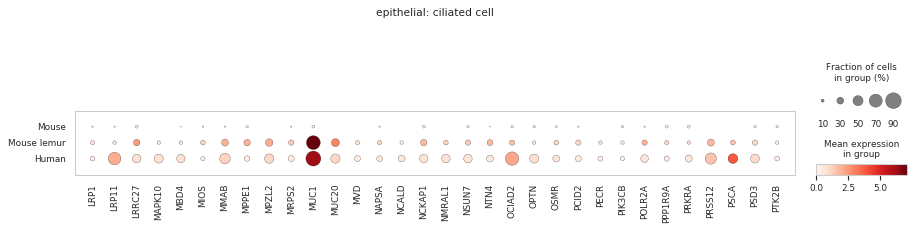

gene subset #5

------- group: epithelial: ciliated cell -------


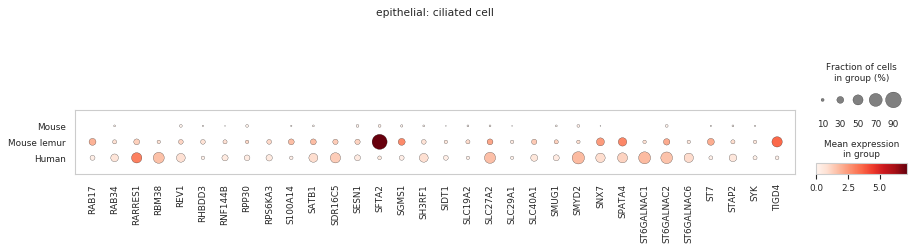

gene subset #6

------- group: epithelial: ciliated cell -------


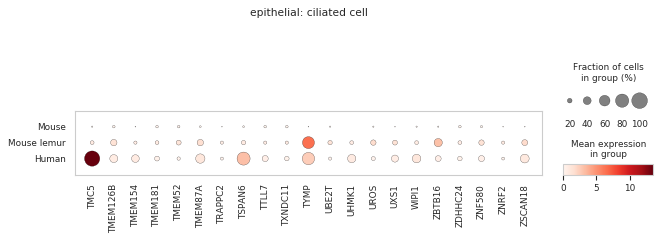

gene subset #1

------- group: myeloid: conventional dendritic cell -------


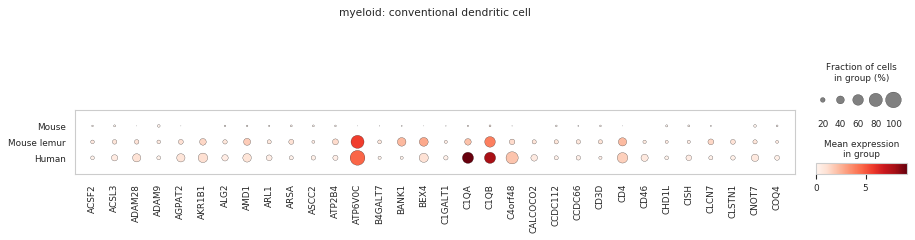

gene subset #2

------- group: myeloid: conventional dendritic cell -------


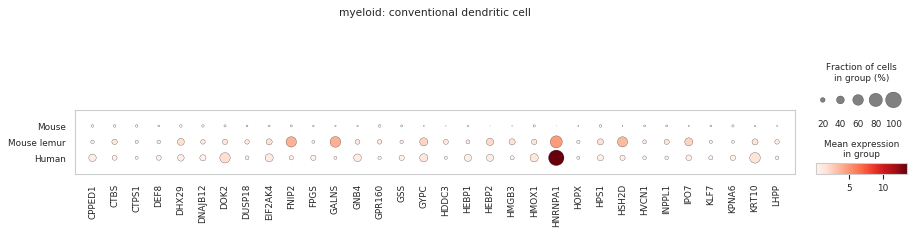

gene subset #3

------- group: myeloid: conventional dendritic cell -------


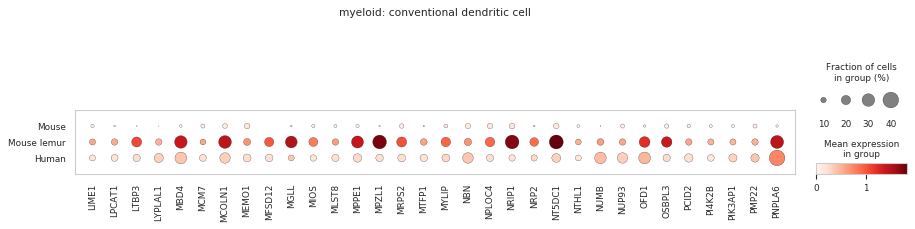

gene subset #4

------- group: myeloid: conventional dendritic cell -------


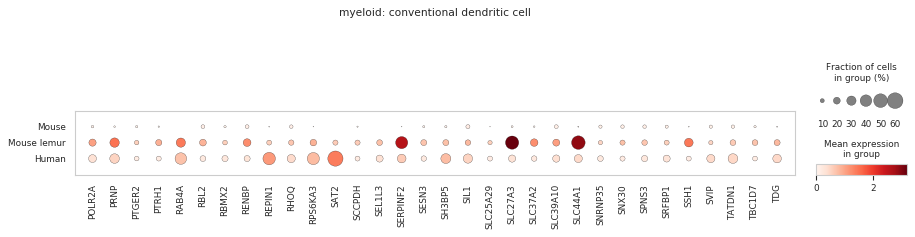

gene subset #5

------- group: myeloid: conventional dendritic cell -------


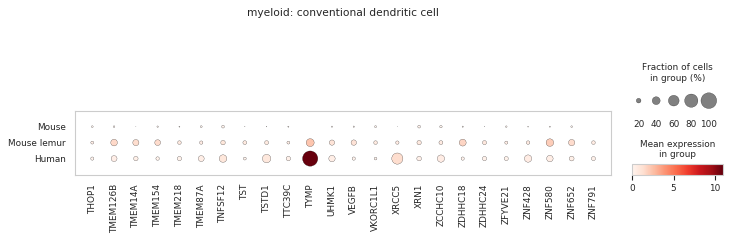

gene subset #1

------- group: endothelial: lymphatic cell -------


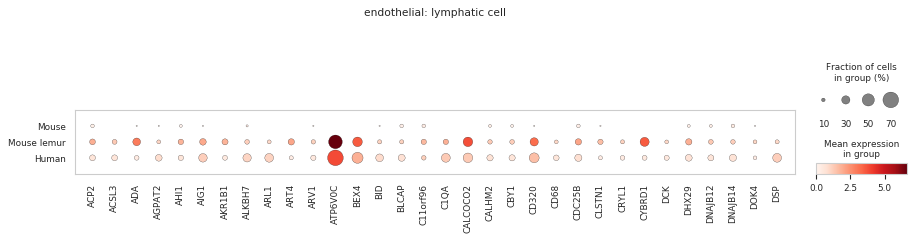

gene subset #2

------- group: endothelial: lymphatic cell -------


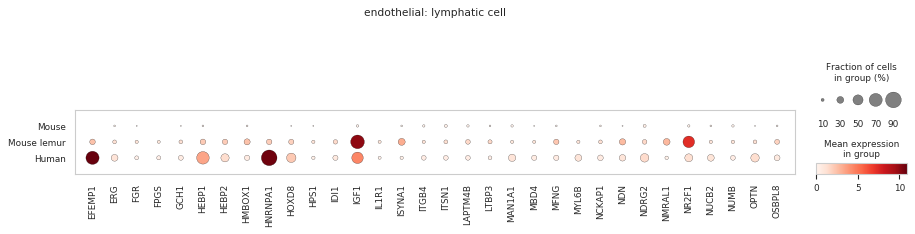

gene subset #3

------- group: endothelial: lymphatic cell -------


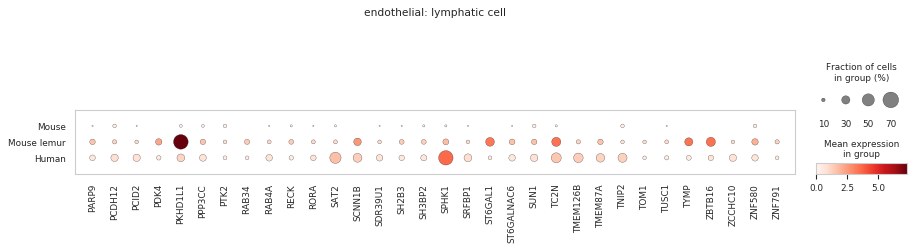

gene subset #4

------- group: endothelial: lymphatic cell -------


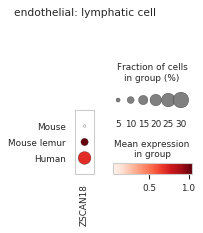

gene subset #1

------- group: myeloid: monocyte -------


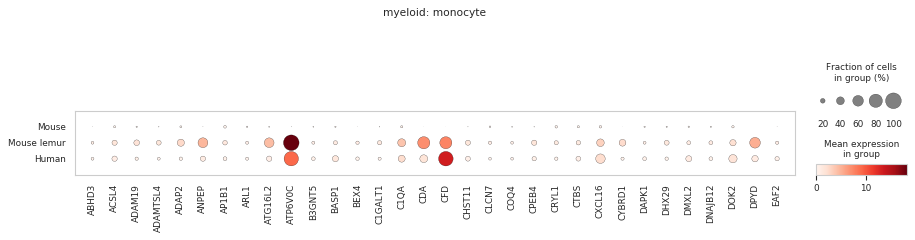

gene subset #2

------- group: myeloid: monocyte -------


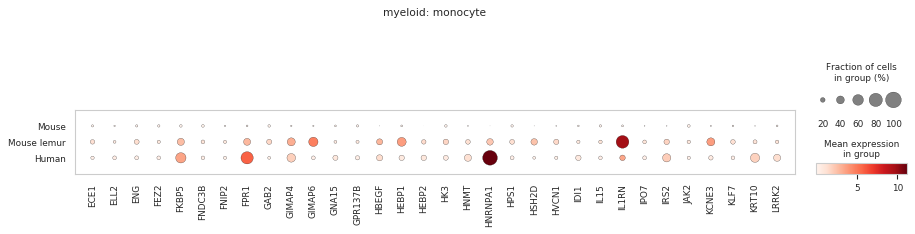

gene subset #3

------- group: myeloid: monocyte -------


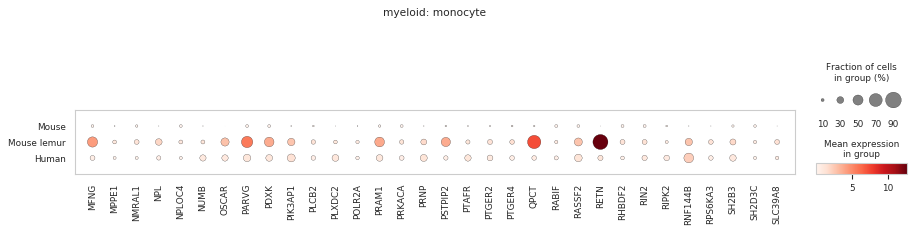

gene subset #4

------- group: myeloid: monocyte -------


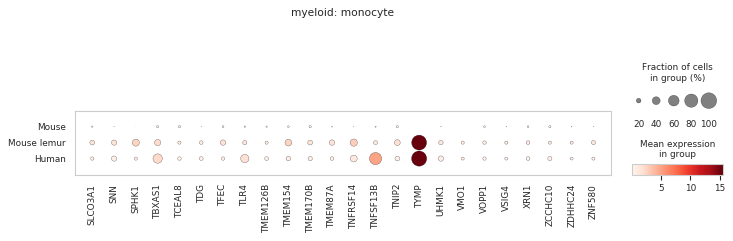

gene subset #1

------- group: lymphoid: natural killer T cell -------


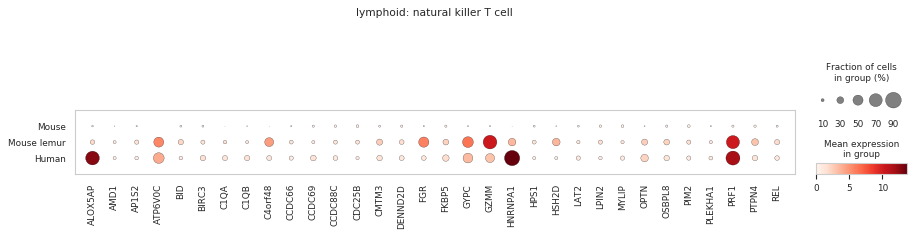

gene subset #2

------- group: lymphoid: natural killer T cell -------


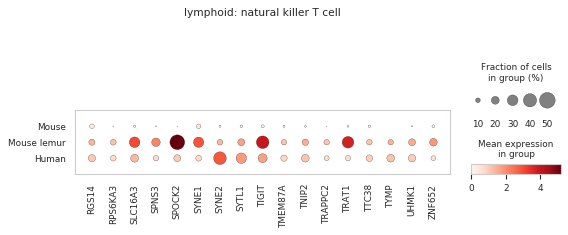

gene subset #1

------- group: lymphoid: natural killer cell -------


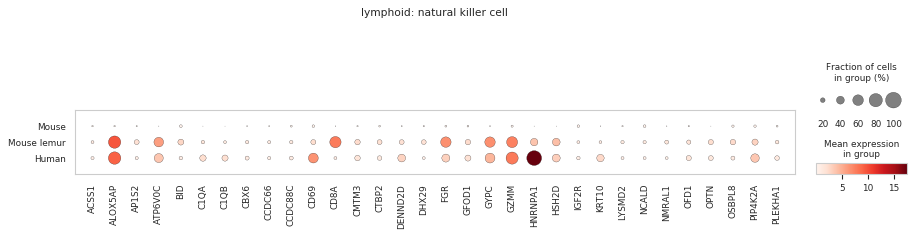

gene subset #2

------- group: lymphoid: natural killer cell -------


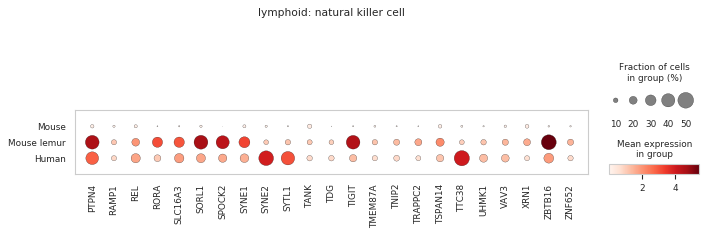

gene subset #1

------- group: stromal: pericyte cell -------


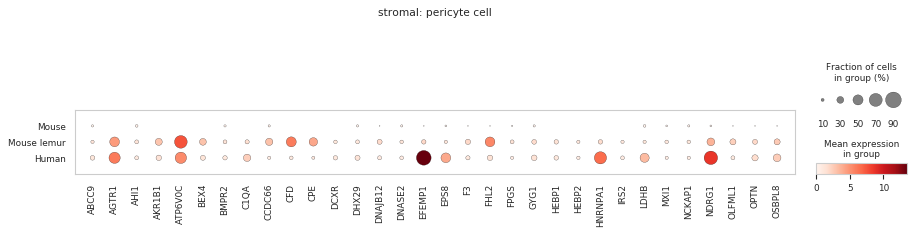

gene subset #2

------- group: stromal: pericyte cell -------


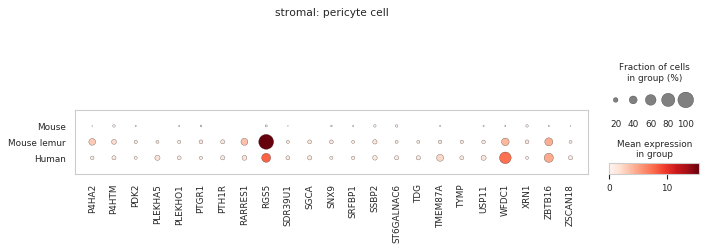

gene subset #1

------- group: lymphoid: plasma cell -------


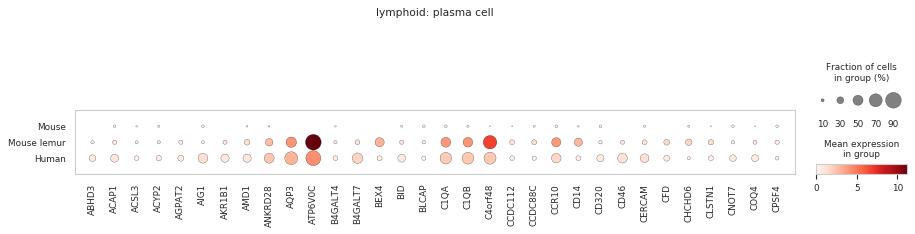

gene subset #2

------- group: lymphoid: plasma cell -------


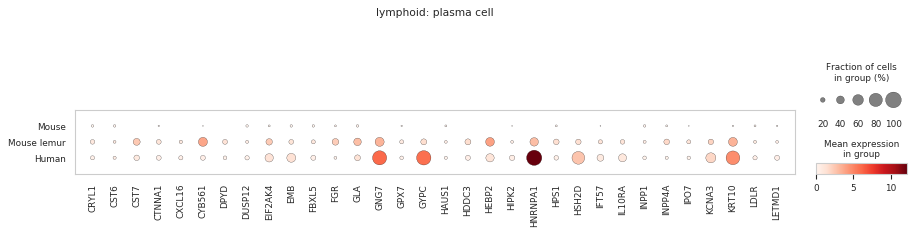

gene subset #3

------- group: lymphoid: plasma cell -------


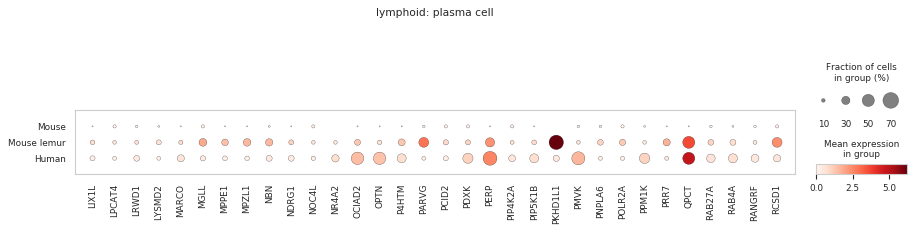

gene subset #4

------- group: lymphoid: plasma cell -------


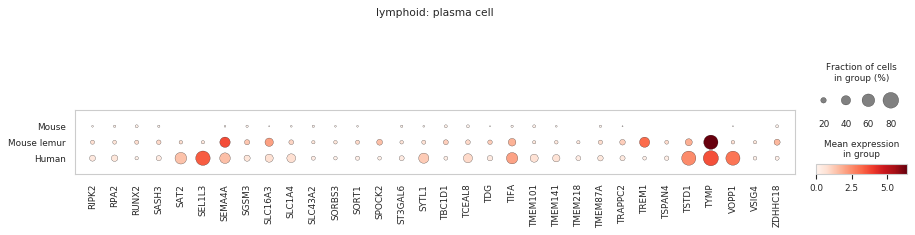

gene subset #5

------- group: lymphoid: plasma cell -------


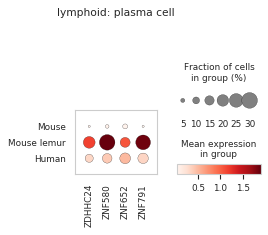

gene subset #1

------- group: myeloid: plasmacytoid dendritic cell -------


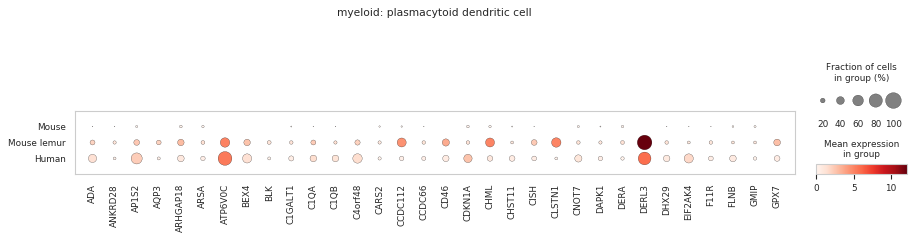

gene subset #2

------- group: myeloid: plasmacytoid dendritic cell -------


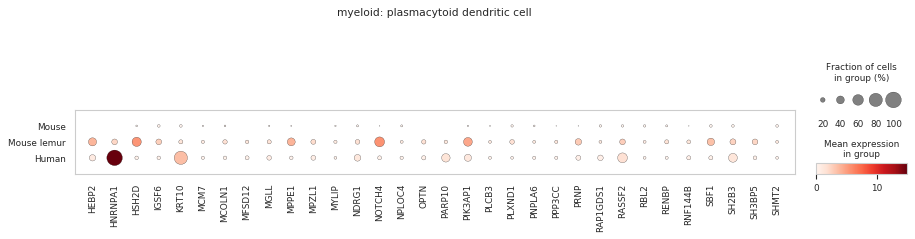

gene subset #3

------- group: myeloid: plasmacytoid dendritic cell -------


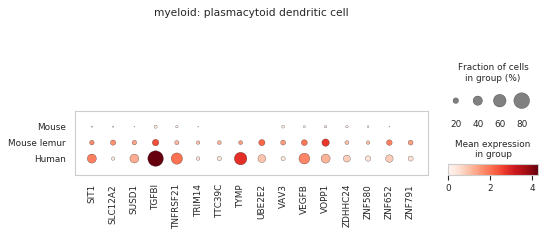

gene subset #1

------- group: myeloid: proliferating alveolar macrophage -------


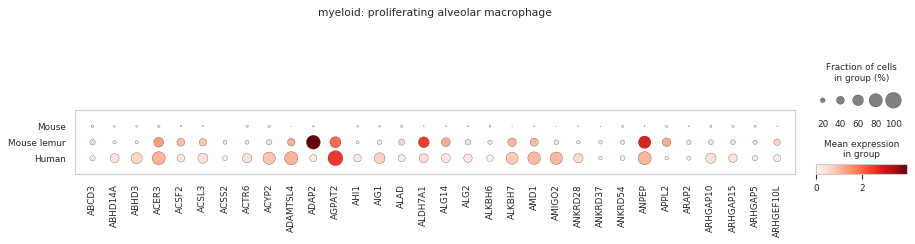

gene subset #2

------- group: myeloid: proliferating alveolar macrophage -------


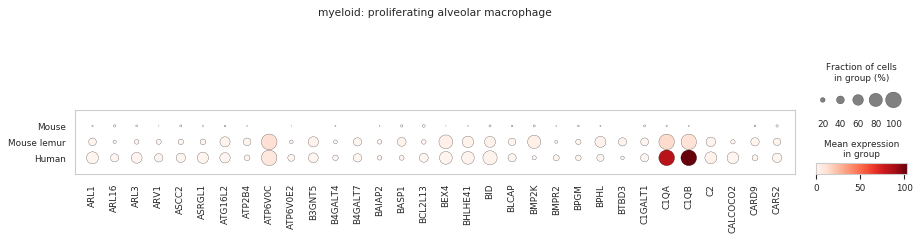

gene subset #3

------- group: myeloid: proliferating alveolar macrophage -------


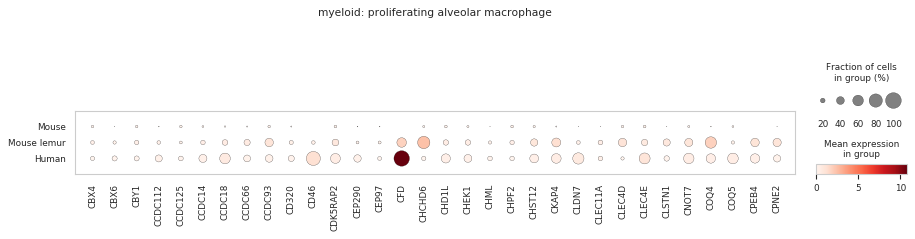

gene subset #4

------- group: myeloid: proliferating alveolar macrophage -------


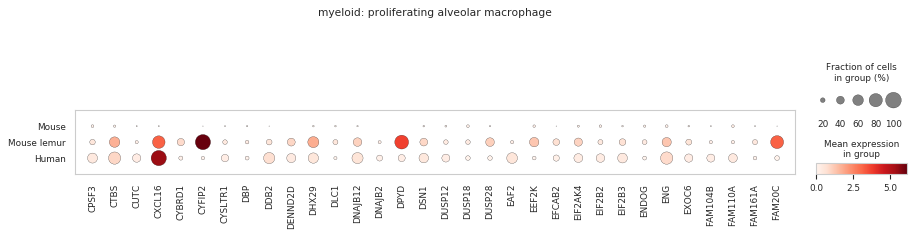

gene subset #5

------- group: myeloid: proliferating alveolar macrophage -------


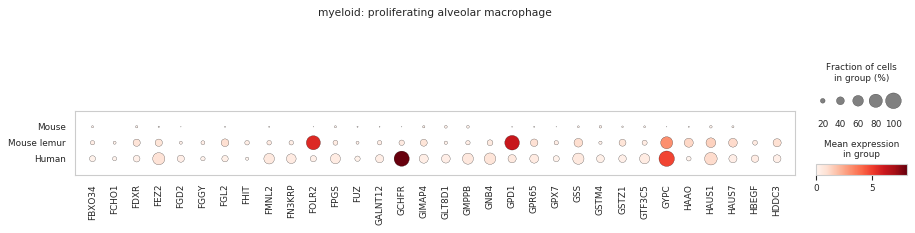

gene subset #6

------- group: myeloid: proliferating alveolar macrophage -------


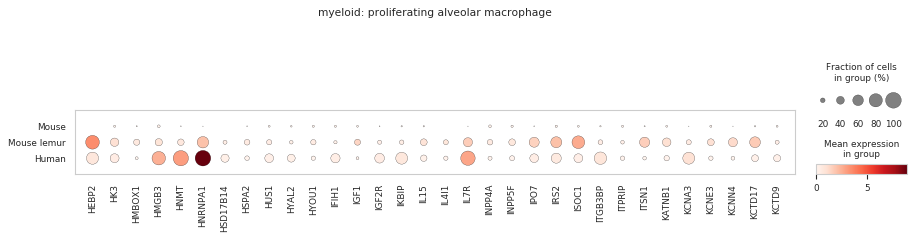

gene subset #7

------- group: myeloid: proliferating alveolar macrophage -------


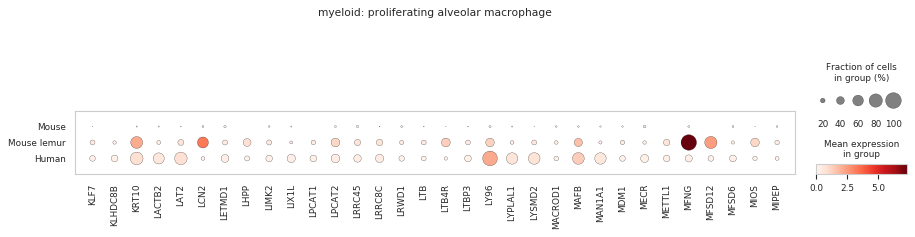

gene subset #8

------- group: myeloid: proliferating alveolar macrophage -------


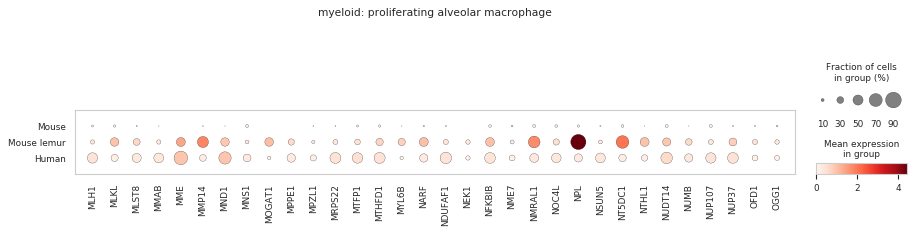

gene subset #9

------- group: myeloid: proliferating alveolar macrophage -------


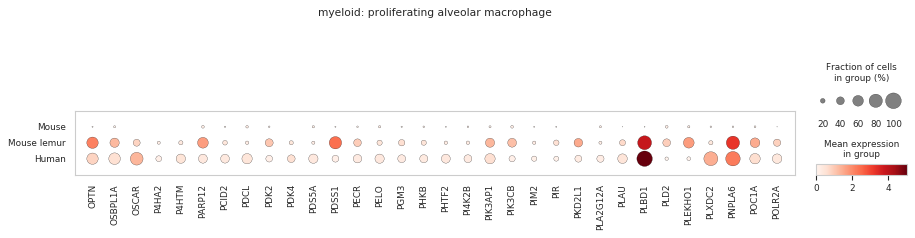

gene subset #10

------- group: myeloid: proliferating alveolar macrophage -------


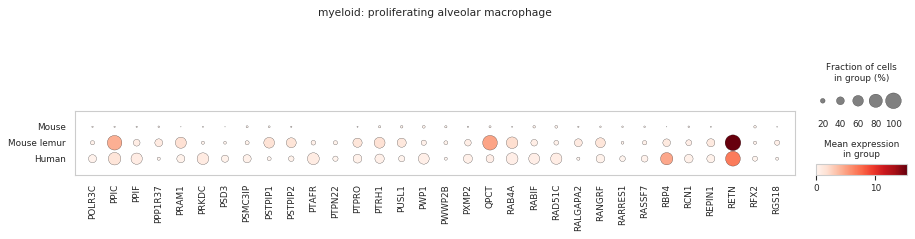

gene subset #11

------- group: myeloid: proliferating alveolar macrophage -------


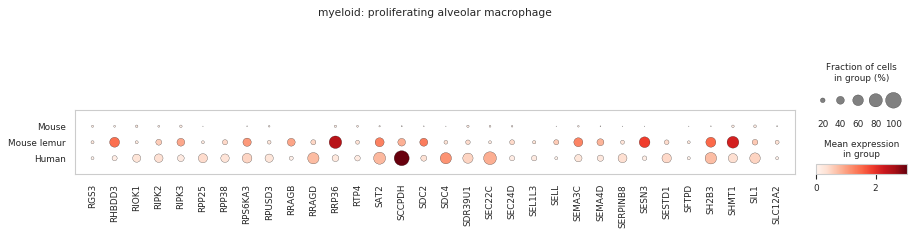

gene subset #12

------- group: myeloid: proliferating alveolar macrophage -------


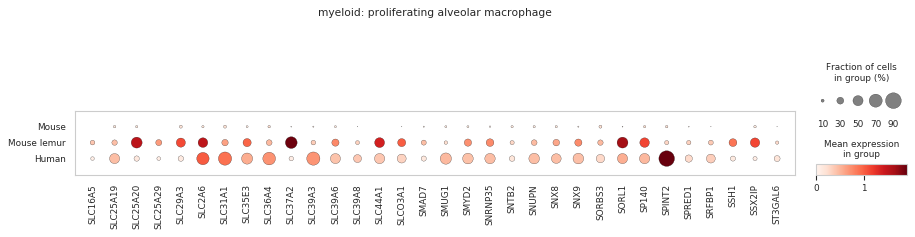

gene subset #13

------- group: myeloid: proliferating alveolar macrophage -------


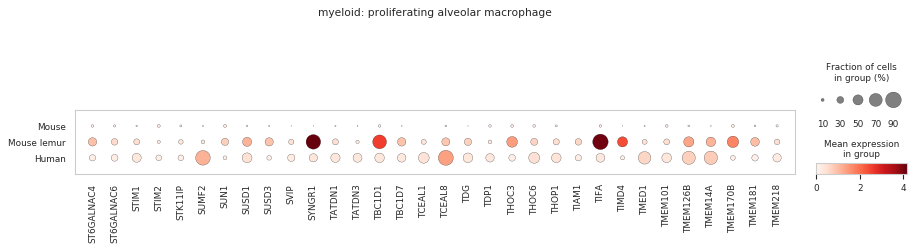

gene subset #14

------- group: myeloid: proliferating alveolar macrophage -------


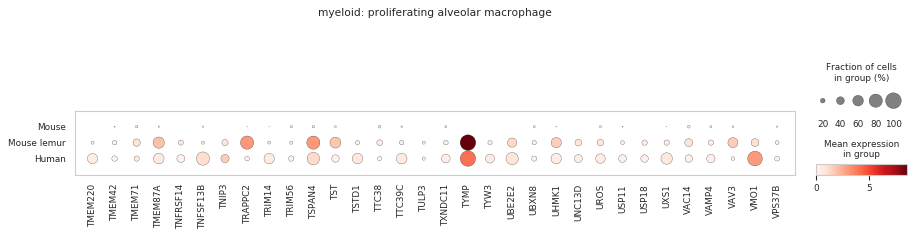

gene subset #15

------- group: myeloid: proliferating alveolar macrophage -------


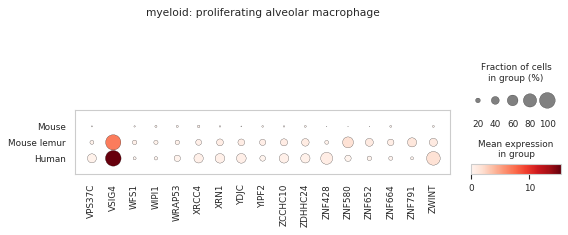

gene subset #1

------- group: lymphoid: proliferating natural killer cell_T cell -------


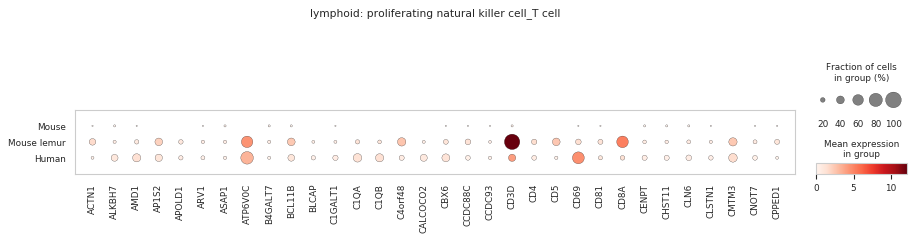

gene subset #2

------- group: lymphoid: proliferating natural killer cell_T cell -------


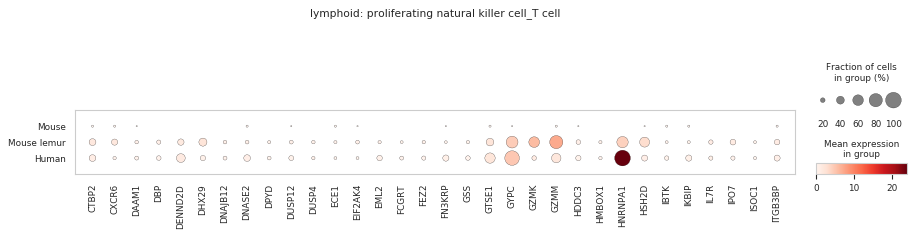

gene subset #3

------- group: lymphoid: proliferating natural killer cell_T cell -------


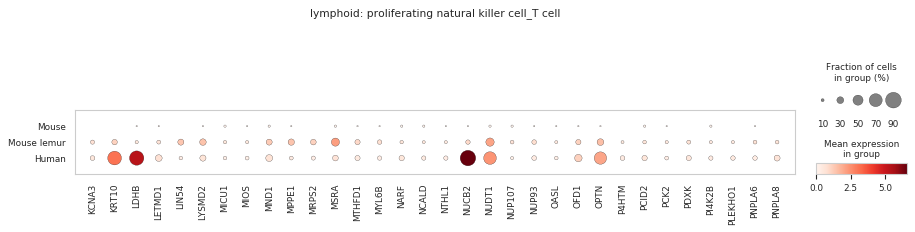

gene subset #4

------- group: lymphoid: proliferating natural killer cell_T cell -------


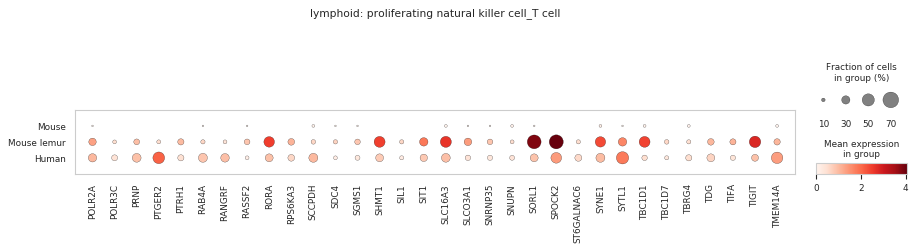

gene subset #5

------- group: lymphoid: proliferating natural killer cell_T cell -------


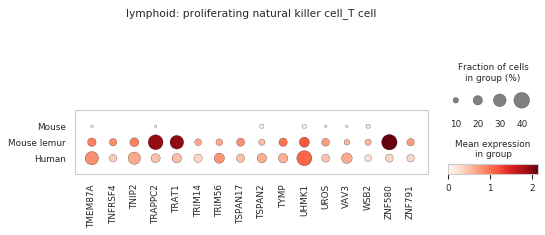

gene subset #1

------- group: endothelial: vein cell -------


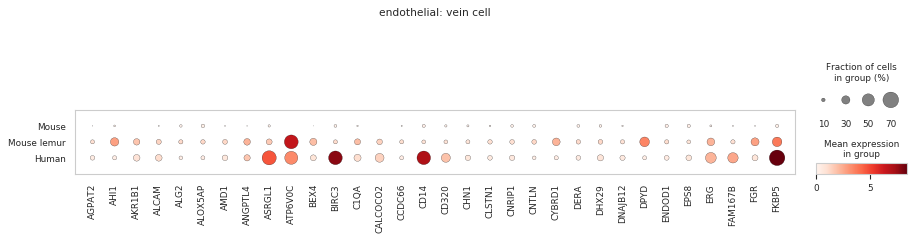

gene subset #2

------- group: endothelial: vein cell -------


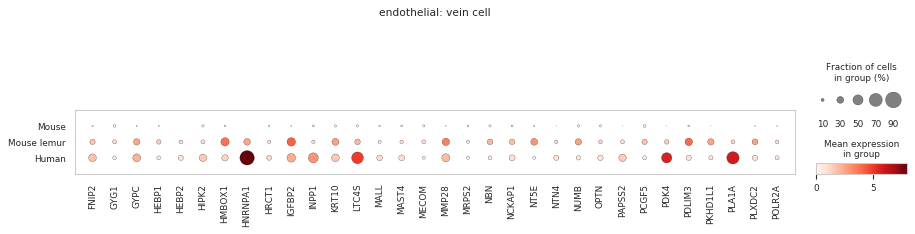

gene subset #3

------- group: endothelial: vein cell -------


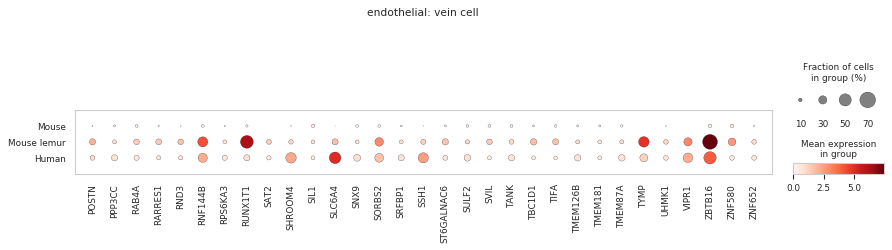

In [41]:
for col_name, col_values in genes_in_primate_enriched_celltypes_binary.iteritems():
    gene_names = col_values[col_values].index
    gene_names = [x for x in gene_names if x not in dissociation_genes]
    col_name_sanitized = xspecies.sanitize(col_name)
    
    compartment_narrow_col = narrow_to_compartment_narrrow[col_name]
    cross_species.dotplots(
        gene_names,
        save=f"__binary__no_dissociation_genes__{col_name_sanitized}",
        select_group=compartment_narrow_col,
        save_format="pdf",
        max_genes=32,
    )

#### Write primate-specific gene enrichement to file

In [42]:
xlsx = os.path.join(
    figure_folder_base, "genes_in_primate_enriched_celltypes_binary.xlsx"
)
genes_in_primate_enriched_celltypes_binary.to_excel(xlsx)

### Heatmap of primate enriched genes per celltype

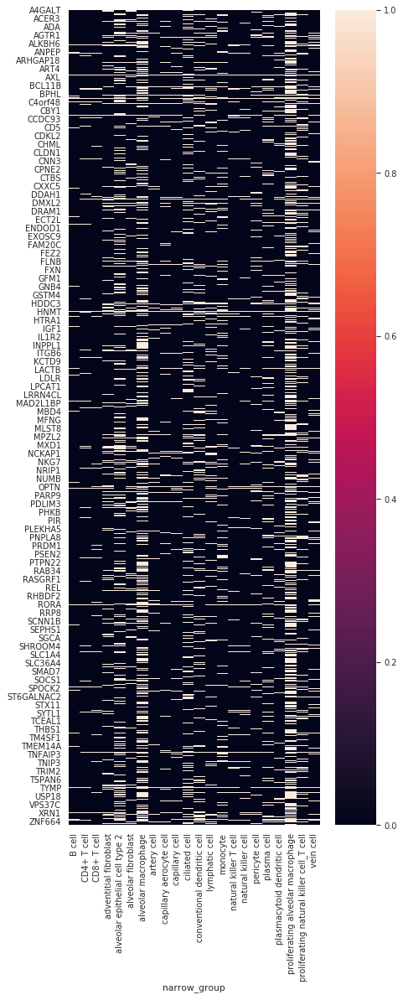

In [43]:
sns.set(context='paper', style='white')
fig, ax = plt.subplots(figsize=(6, 16))
sns.heatmap(genes_in_primate_enriched_celltypes_binary)

In [44]:
genes_in_primate_enriched_celltypes_binary.head()

narrow_group,B cell,CD4+ T cell,CD8+ T cell,adventitial fibroblast,alveolar epithelial cell type 2,alveolar fibroblast,alveolar macrophage,artery cell,capillary aerocyte cell,capillary cell,...,lymphatic cell,monocyte,natural killer T cell,natural killer cell,pericyte cell,plasma cell,plasmacytoid dendritic cell,proliferating alveolar macrophage,proliferating natural killer cell_T cell,vein cell
A4GALT,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ABCA5,False,False,False,True,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ABCA8,False,False,False,True,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ABCA9,False,False,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
ABCC9,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False


#### Write primate-specific gene enrichement to file

In [45]:
xlsx = os.path.join(
    figure_folder_base, "genes_in_primate_enriched_celltypes_from_binarized.xlsx"
)
genes_in_primate_enriched_celltypes_binary.to_excel(xlsx)

/home/olga/miniconda3/envs/tabula-microcebus-jan2021/lib/python3.7/site-packages/seaborn/matrix.py:649: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


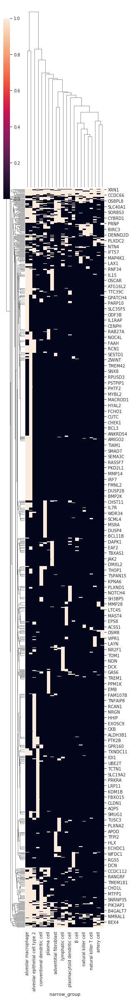

In [46]:
sns.clustermap(genes_in_primate_enriched_celltypes_binary, figsize=(4, 30))

In [47]:
def get_celltypes_with_primate_enrichment_per_gene(row):
    n_total_celltypes = len(row)
    gene_name = row.name
    primate_celltypes = sorted(row[row == primate.primates_string].index.tolist())

    list_to_return = primate_celltypes + [None] * (
        n_total_celltypes - len(primate_celltypes)
    )
    return list_to_return


per_gene_primate_celltype_enrichment = pd.DataFrame(
    list(
        genes_in_primate_enriched_celltypes.apply(
            get_celltypes_with_primate_enrichment_per_gene, axis=1
        ).values
    ),
    index=genes_in_primate_enriched_celltypes.index,
)
per_gene_primate_celltype_enrichment

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
A4GALT,ciliated cell,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
ABCA5,adventitial fibroblast,alveolar fibroblast,ciliated cell,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
ABCA8,adventitial fibroblast,alveolar fibroblast,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
ABCA9,adventitial fibroblast,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
ABCC9,pericyte cell,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF791,alveolar fibroblast,artery cell,capillary aerocyte cell,conventional dendritic cell,lymphatic cell,plasma cell,plasmacytoid dendritic cell,proliferating alveolar macrophage,proliferating natural killer cell_T cell,None,...,None,None,None,None,None,None,None,None,None,None
ZNHIT3,alveolar macrophage,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
ZNRF2,ciliated cell,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
ZSCAN18,adventitial fibroblast,alveolar epithelial cell type 2,alveolar fibroblast,ciliated cell,lymphatic cell,pericyte cell,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


### Venn diagrams of conserved vs primate

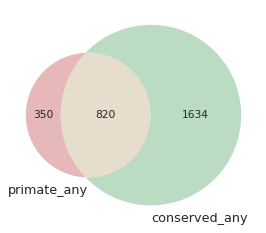

In [48]:
set_list = [set(primate.primate_any.index), set(primate.conserved_any.index)]
labels = ["primate_any", "conserved_any"]

matplotlib_venn.venn2(set_list, set_labels=labels)

In [49]:
has_mouse = primate.species_sharing_2d.applymap(
    lambda x: "mouse" in x if isinstance(x, str) else x
)
rows = has_mouse.any(axis=1)
mouse_any = primate.species_sharing_2d.loc[rows]
print(mouse_any.shape)
mouse_any.head()

(0, 22)


narrow_group,B cell,CD4+ T cell,CD8+ T cell,adventitial fibroblast,alveolar epithelial cell type 2,alveolar fibroblast,alveolar macrophage,artery cell,capillary aerocyte cell,capillary cell,...,lymphatic cell,monocyte,natural killer T cell,natural killer cell,pericyte cell,plasma cell,plasmacytoid dendritic cell,proliferating alveolar macrophage,proliferating natural killer cell_T cell,vein cell


/home/olga/miniconda3/envs/tabula-microcebus-jan2021/lib/python3.7/site-packages/matplotlib_venn/_venn3.py:61: UserWarning: Circle C has zero area
  warnings.warn("Circle C has zero area")


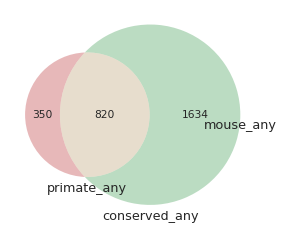

In [50]:
set_list = [
    set(primate.primate_any.index),
    set(primate.conserved_any.index),
    set(mouse_any.index),
]
labels = ["primate_any", "conserved_any", "mouse_any"]

matplotlib_venn.venn3(set_list, set_labels=labels)

In [51]:
len(primate.primate_any.index.intersection(primate.primate_all.index))

33

In [52]:
len(primate.primate_any.index.intersection(primate.conserved_any.index))

820

In [53]:
# compartment_primate.dotplot("HHIP")

In [54]:
rows = (
    (primate.species_sharing_2d == "human-lemur") | primate.species_sharing_2d.isnull()
).all(axis=1)
df = primate.species_sharing_2d.loc[rows]
df = df.dropna(how="all")
df

narrow_group,B cell,CD4+ T cell,CD8+ T cell,adventitial fibroblast,alveolar epithelial cell type 2,alveolar fibroblast,alveolar macrophage,artery cell,capillary aerocyte cell,capillary cell,...,lymphatic cell,monocyte,natural killer T cell,natural killer cell,pericyte cell,plasma cell,plasmacytoid dendritic cell,proliferating alveolar macrophage,proliferating natural killer cell_T cell,vein cell


### Plot all-conserved or all-primate, groupby source

In [55]:
## this is empty, skip
# primate.do_go_enrichment(groupby_source=True, write=True)

### Do per-compartment enrichment, overall

In [56]:
# primate.do_per_group_enrichment()

### Do per-compartment enrichment, per-source

In [57]:
primate.do_per_group_enrichment?

Signature:
primate.do_per_group_enrichment(
    plot=True,
    groupby_source=False,
    write=False,
)
Docstring: Compute per-group (e.g. per-epithelial) GO enrichment
File:      ~/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py
Type:      method


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:20:29,896 INFO: Wrote:
/home/olga/data_lg/data_sm_copy/tabula-microcebus/data-objects/cross-species/binarized/binarized_expression__stable_genes__conserved_any__narrow_group__b_cell__functional_enrichment.csv
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:20:35,016 INFO: Wrote:
/home/olga/googledrive/TabulaMicrocebus/data/cross-species/binarized/binarized_expression__stable_genes__conserved_any__narrow_group__b_cell__functional_enrichment.csv
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 15:21:13,371 INFO: Wrote:
/home/olga/data_lg/data_sm_copy/tabula-microcebus/data-objects/cross-species/binarized/binarized_expression__stable_genes__conserved_any__narrow_group__cd4+_t_cell__functional_enrichment.csv
-- /home/olga/code/tabula-microcebus--olgabo

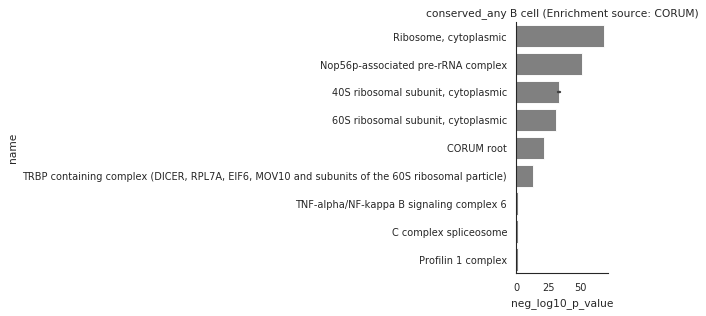

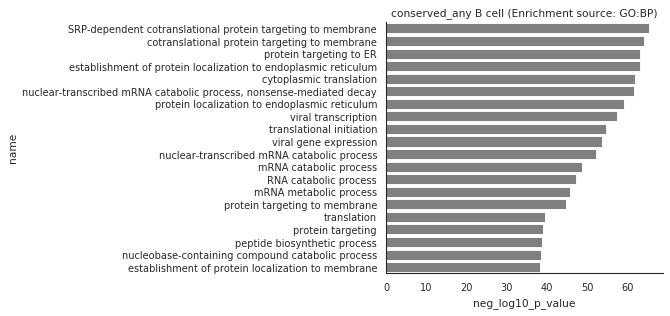

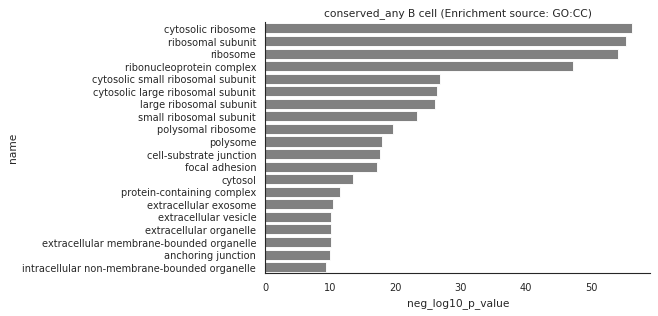

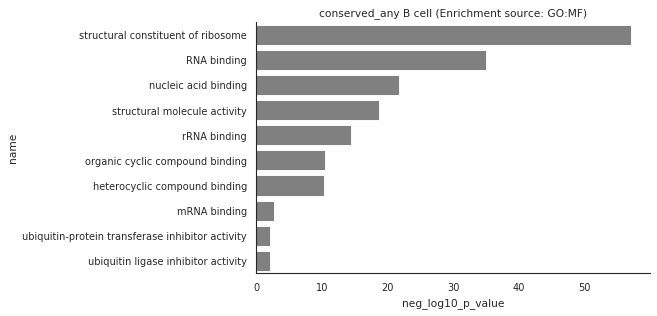

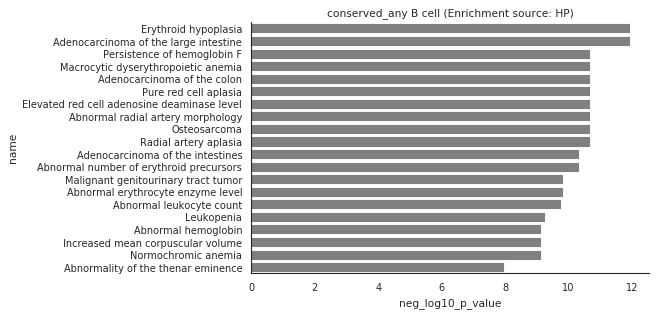

...

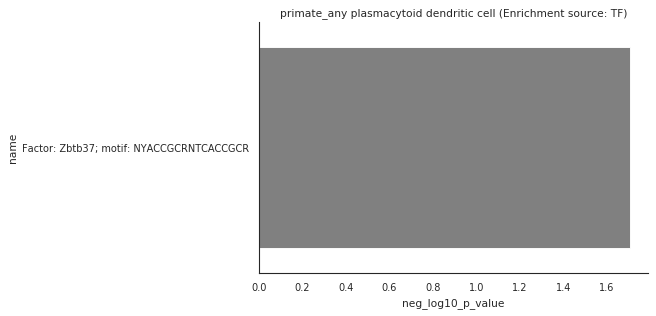

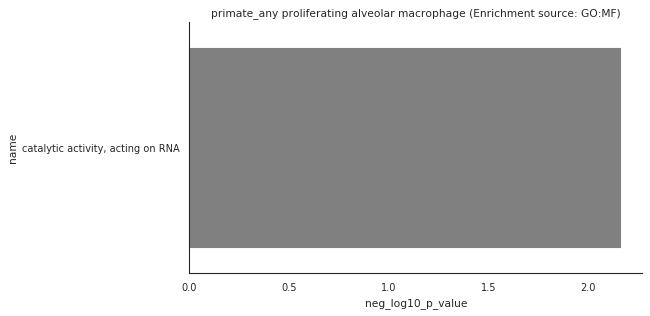

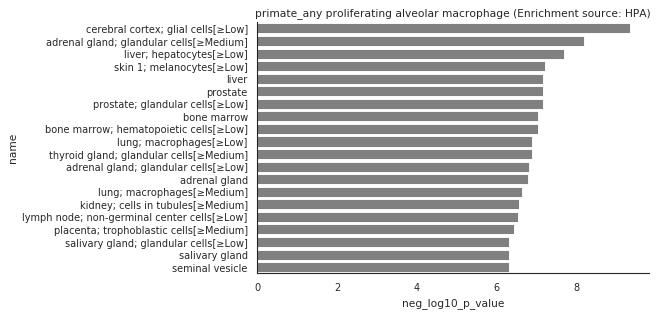

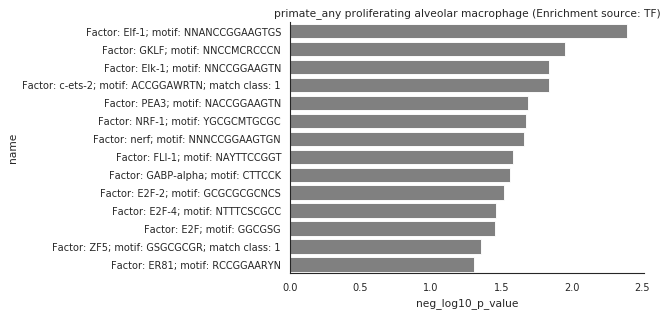

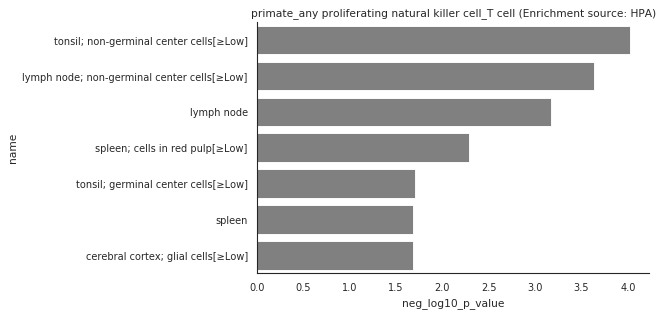

In [58]:
primate.do_per_group_enrichment(groupby_source=True, write=True)

figure_folder = os.path.join(figure_folder_base, "primate-gprofiler-enrichment")

save_figures(figure_folder)

In [59]:
primate.do_per_group_primate_generif()

-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:28,851 INFO: Querying Human--Mouse lemur genes for B cell


querying 1-40...done.


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:30,402 INFO: Querying Human--Mouse lemur genes for CD4+ T cell


Finished.
9 input query terms found dup hits:
	[('AP1B1', 4), ('AP1S2', 3), ('C1GALT1', 9), ('GNG7', 2), ('HNRNPA1', 6), ('KRT10', 2), ('LCK', 2), 
(2125, 7)
querying 1-55...done.
Finished.
12 input query terms found dup hits:
	[('AP1S2', 3), ('CCDC88C', 2), ('CD46', 3), ('HNRNPA1', 6), ('MAP4K1', 2), ('MYC', 10), ('PERP', 3),


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:32,329 INFO: Querying Human--Mouse lemur genes for CD8+ T cell


(6319, 7)
querying 1-49...done.
Finished.
10 input query terms found dup hits:
	[('AP1S2', 3), ('CCDC88C', 2), ('HNRNPA1', 6), ('MAP4K1', 2), ('OPTN', 3), ('PERP', 3), ('REL', 2), 


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:33,915 INFO: Querying Human--Mouse lemur genes for adventitial fibroblast


(4017, 7)
querying 1-122...done.
Finished.
33 input query terms found dup hits:
	[('ABCA9', 2), ('ACSL3', 3), ('BTG3', 3), ('CADM3', 3), ('DNAJB12', 3), ('DNASE2', 5), ('DOCK4', 2),


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:36,357 INFO: Querying Human--Mouse lemur genes for alveolar epithelial cell type 2


(13530, 7)
querying 1-264...done.
Finished.
57 input query terms found dup hits:
	[('ABHD14A', 2), ('ACSL3', 3), ('ACTR6', 3), ('AQP4', 3), ('BCAR1', 5), ('BTG3', 3), ('C1GALT1', 9),
1 input query terms found no hit:
	['WDR34']


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:40,056 INFO: Querying Human--Mouse lemur genes for alveolar fibroblast


(17005, 7)
querying 1-99...done.
Finished.
15 input query terms found dup hits:
	[('ACSL3', 3), ('BTG3', 3), ('DNAJB12', 3), ('DNASE2', 5), ('HEBP2', 3), ('HMBOX1', 3), ('HNRNPA1', 


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:42,192 INFO: Querying Human--Mouse lemur genes for alveolar macrophage


(9841, 7)
querying 1-397...done.
Finished.
70 input query terms found dup hits:
	[('ACSL3', 3), ('ADAMTSL4', 5), ('ALG14', 2), ('ANPEP', 3), ('ARHGAP15', 3), ('ARL2', 3), ('ATP6V0E2


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:46,364 INFO: Querying Human--Mouse lemur genes for artery cell


(19162, 7)
querying 1-49...done.
Finished.
11 input query terms found dup hits:
	[('BTG3', 3), ('CD46', 3), ('CYTH1', 3), ('HEBP2', 3), ('HMBOX1', 3), ('HNRNPA1', 6), ('NCKAP1', 3),


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:47,941 INFO: Querying Human--Mouse lemur genes for capillary aerocyte cell


(4241, 7)
querying 1-68...done.
Finished.
17 input query terms found dup hits:
	[('ACSL3', 3), ('ADA', 3), ('BTG3', 3), ('CD46', 3), ('DNAJB12', 3), ('DOCK4', 2), ('GAS6', 4), ('HM


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:49,662 INFO: Querying Human--Mouse lemur genes for capillary cell


(5002, 7)
querying 1-58...done.
Finished.
16 input query terms found dup hits:
	[('AP1S2', 3), ('ARRDC3', 2), ('BTG3', 3), ('ERG', 3), ('HMBOX1', 3), ('HMGN3', 2), ('HNRNPA1', 6), 


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:51,757 INFO: Querying Human--Mouse lemur genes for ciliated cell


(9474, 7)
querying 1-202...done.
Finished.
35 input query terms found dup hits:
	[('AQP5', 2), ('BCAR3', 3), ('BTG3', 3), ('C4BPA', 6), ('C6', 5), ('CCDC88C', 2), ('DNAJB12', 3), ('


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:54,580 INFO: Querying Human--Mouse lemur genes for conventional dendritic cell


(15703, 7)
querying 1-168...done.
Finished.
34 input query terms found dup hits:
	[('ACSL3', 3), ('BTG3', 3), ('C1GALT1', 9), ('CD46', 3), ('CPVL', 2), ('DNAJB12', 3), ('EIF2AK4', 2)


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:57,090 INFO: Querying Human--Mouse lemur genes for lymphatic cell


(8103, 7)
querying 1-111...done.
Finished.
23 input query terms found dup hits:
	[('ACSL3', 3), ('ADA', 3), ('CBY1', 5), ('DNAJB12', 3), ('ERG', 3), ('HEBP1', 2), ('HEBP2', 3), ('HM


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:00:59,346 INFO: Querying Human--Mouse lemur genes for monocyte


(11317, 7)
querying 1-139...done.
Finished.
32 input query terms found dup hits:
	[('ADAMTSL4', 5), ('ANPEP', 3), ('AP1B1', 4), ('BASP1', 6), ('C1GALT1', 9), ('CD163', 2), ('DAPK1', 


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:02,072 INFO: Querying Human--Mouse lemur genes for natural killer T cell


(17507, 7)
querying 1-56...done.
Finished.
10 input query terms found dup hits:
	[('AP1S2', 3), ('CCDC88C', 2), ('HNRNPA1', 6), ('HPS1', 2), ('OPTN', 3), ('REL', 2), ('SIAH2', 3), (


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:03,683 INFO: Querying Human--Mouse lemur genes for natural killer cell


(3182, 7)
querying 1-60...done.
Finished.
19 input query terms found dup hits:
	[('AP1S2', 3), ('CCDC88C', 2), ('CD8A', 2), ('CTBP2', 10), ('GFOD1', 3), ('HNRNPA1', 6), ('IGF2R', 2


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:05,407 INFO: Querying Human--Mouse lemur genes for pericyte cell


(3388, 7)
querying 1-73...done.
Finished.
20 input query terms found dup hits:
	[('BTG3', 3), ('COL18A1', 3), ('DCXR', 2), ('DNAJB12', 3), ('DNASE2', 5), ('EPS8', 4), ('F3', 4), ('


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:07,464 INFO: Querying Human--Mouse lemur genes for plasma cell


(10759, 7)
querying 1-148...done.
Finished.
35 input query terms found dup hits:
	[('ACSL3', 3), ('B4GALT4', 2), ('BTG3', 3), ('CCDC88C', 2), ('CD46', 3), ('CTNNA1', 2), ('DPYD', 5),


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:09,982 INFO: Querying Human--Mouse lemur genes for plasmacytoid dendritic cell


(10749, 7)
querying 1-96...done.
Finished.
26 input query terms found dup hits:
	[('ADA', 3), ('AP1S2', 3), ('BTG3', 3), ('C1GALT1', 9), ('CD46', 3), ('CDKN1A', 6), ('CPVL', 2), ('D


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:12,119 INFO: Querying Human--Mouse lemur genes for proliferating alveolar macrophage


(7148, 7)
querying 1-516...done.
Finished.
93 input query terms found dup hits:
	[('ABHD14A', 2), ('ACSL3', 3), ('ACTR6', 3), ('ADAMTSL4', 5), ('ALG14', 2), ('ANPEP', 3), ('ARHGAP15
1 input query terms found no hit:
	['WDR34']


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:17,281 INFO: Querying Human--Mouse lemur genes for proliferating natural killer cell_T cell


(26851, 7)
querying 1-161...done.
Finished.
42 input query terms found dup hits:
	[('ACTN1', 2), ('AP1S2', 3), ('ASAP1', 3), ('BRCA2', 8), ('BTG3', 3), ('C1GALT1', 9), ('CCDC88C', 2)
1 input query terms found no hit:
	['WDR34']


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:19,865 INFO: Querying Human--Mouse lemur genes for vein cell


(9595, 7)
querying 1-114...done.
Finished.
28 input query terms found dup hits:
	[('BTG3', 3), ('DNAJB12', 3), ('DPYD', 5), ('EPS8', 4), ('ERG', 3), ('FGFR1', 6), ('HEBP1', 2), ('HE


-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:01:22,405 INFO: Writing /home/olga/data_lg/data_sm_copy/tabula-microcebus/data-objects/cross-species/binarized/binarized_expression__stable_genes__primate_any__narrow_group__generif.xlsx ...


(13330, 7)


/home/olga/miniconda3/envs/tabula-microcebus-jan2021/lib/python3.7/site-packages/openpyxl/workbook/child.py:99: UserWarning: Title is more than 31 characters. Some applications may not be able to read the file
  warnings.warn("Title is more than 31 characters. Some applications may not be able to read the file")
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:02:35,764 INFO: Done!
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:02:35,765 INFO: Writing /home/olga/googledrive/TabulaMicrocebus/data/cross-species/binarized/binarized_expression__stable_genes__primate_any__narrow_group__generif.xlsx ...
-- /home/olga/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/binarized.py --
2021-06-28 16:04:06,428 INFO: Done!


# Categorize genes in binarized across cell types

## Across compartment

In [103]:
compartment_narrow_to_compartment = adata.obs[
    ["narrow_group", "compartment_group"]
].set_index("narrow_group")["compartment_group"]
compartment_narrow_to_compartment = compartment_narrow_to_compartment[
    ~compartment_narrow_to_compartment.index.duplicated()
]
compartment_narrow_to_compartment

narrow_group
B cell                                         lymphoid
monocyte                                        myeloid
natural killer cell                            lymphoid
alveolar macrophage                             myeloid
conventional dendritic cell                     myeloid
CD8+ T cell                                    lymphoid
capillary cell                              endothelial
natural killer T cell                          lymphoid
capillary aerocyte cell                     endothelial
adventitial fibroblast                          stromal
CD4+ T cell                                    lymphoid
vein cell                                   endothelial
alveolar fibroblast                             stromal
pericyte cell                                   stromal
plasma cell                                    lymphoid
artery cell                                 endothelial
alveolar epithelial cell type 2              epithelial
proliferating alveolar macrophage  

In [104]:
stability

In [105]:
binarized_per_gene = primate.binarized.unstack(level=0)
binarized_per_gene = binarized_per_gene.sort_index(axis=1)
# binarized_per_gene = binarized_per_gene.swaplevel(axis=1)
# binarized_per_gene = binarized_per_gene.sort_index(axis=1)
binarized_per_gene.head()

A1BG                      A1CF              \
species                          Mouse Mouse lemur  Human  Mouse Mouse lemur   
narrow_group                                                                   
B cell                           False       False   True  False       False   
CD4+ T cell                      False       False   True  False       False   
CD8+ T cell                      False       False   True  False       False   
adventitial fibroblast           False       False  False  False       False   
alveolar epithelial cell type 2  False       False  False  False       False   

                                          A2M                    A4GALT  ...  \
species                          Human  Mouse Mouse lemur  Human  Mouse  ...   
narrow_group                                                             ...   
B cell                           False  False       False  False  False  ...   
CD4+ T cell                      False  False       False  False  False  ...   
CD8+ T cell                      False  False       False  False  False  ...   
adventitial fibroblast           False  False       False   True   True  ...   
alveolar epithelial cell type 2  False  False       False  False  False  ...   

                                ZSCAN10 ZSCAN18                    ZWILCH  \
species                           Human   Mouse Mouse lemur  Human  Mouse   
narrow_group                                                                
B cell                            False   False       False  False  False   
CD4+ T cell                       False   False       False  False  False   
CD8+ T cell                       False   False       False  False  False   
adventitial fibroblast            False   False        True   True  False   
alveolar epithelial cell type 2   False   False        True   True  False   

                                                    ZWINT                     
species                         Mouse lemur  Human  Mouse Mouse lemur  Human  
narrow_group                                                                  
B cell                                False  False  False       False  False  
CD4+ T cell                           False  False  False       False  False  
CD8+ T cell                           False  False  False       False  False  
adventitial fibroblast                False  False  False       False  False  
alveolar epithelial cell type 2       False  False  False       False  False  

[5 rows x 13056 columns]

In [108]:
binarized_per_gene_compartment = (
    binarized_per_gene.groupby(compartment_narrow_to_compartment).sum() > 0
)
binarized_per_gene_compartment

A1BG                      A1CF                       A2M  \
species            Mouse Mouse lemur  Human  Mouse Mouse lemur  Human  Mouse   
compartment_group                                                              
endothelial        False       False  False  False       False  False  False   
epithelial         False       False   True  False       False  False  False   
lymphoid           False       False   True  False       False  False  False   
myeloid            False       False   True  False       False  False  False   
stromal            False       False   True  False       False  False  False   

                                     A4GALT  ... ZSCAN10 ZSCAN18              \
species           Mouse lemur  Human  Mouse  ...   Human   Mouse Mouse lemur   
compartment_group                            ...                               
endothelial             False   True   True  ...   False   False        True   
epithelial              False  False  False  ...   False   False        True   
lymphoid                False   True   True  ...   False   False        True   
myeloid                 False   True  False  ...   False   False       False   
stromal                 False   True   True  ...   False   False        True   

                         ZWILCH                     ZWINT                     
species            Human  Mouse Mouse lemur  Human  Mouse Mouse lemur  Human  
compartment_group                                                             
endothelial         True  False       False  False   True       False  False  
epithelial          True  False       False  False  False       False  False  
lymphoid           False   True       False   True   True        True   True  
myeloid             True   True        True   True  False        True   True  
stromal             True  False       False  False  False       False  False  

[5 rows x 13056 columns]

In [110]:
hhip = binarized_per_gene_compartment['ACSL1']
binarized.categorize_genes(hhip)

'Contraction in primates, lemur=human'

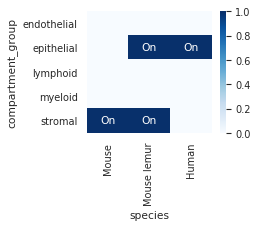

In [111]:
fig, ax = plt.subplots(figsize=(2.5, 2))
binarized.plot_binarized_gene('HHIP', binarized_per_gene_compartment)

### Do per-compartment

In [112]:
# %%time
# per_gene_catgorization_compartment = binarized_per_gene_compartment.groupby(
#     level=0, axis=1
# ).apply(categorize_genes)
# per_gene_catgorization_compartment["HHIP"]

### Parallelized per comaprtment

In [113]:
%%time

remove_rogue_tqdm()

grouped = binarized_per_gene_compartment.groupby(level=0, axis=1)

results = Parallel(n_jobs=16)(
    delayed(binarized.categorize_genes)(df) for gene, df in grouped
)
per_gene_catgorization_compartment = pd.Series(results, index=grouped.groups.keys())
per_gene_catgorization_compartment["HHIP"]


CPU times: user 7.49 s, sys: 1.36 s, total: 8.84 s
Wall time: 12.5 s


'Celltype-switching, lemur closer to mouse'

In [114]:
per_gene_catgorization_compartment_counts = (
    per_gene_catgorization_compartment.value_counts().reset_index()
)
per_gene_catgorization_compartment_counts = (
    per_gene_catgorization_compartment_counts.rename(
        columns={"index": "gene_category", 0: "n_genes"}
    )
)
per_gene_catgorization_compartment_counts

,gene_category,n_genes
0,Other,761
1,"Human-specific, celltype-specific",609
2,Not expressed in all three species,588
3,"Conserved, celltype-specific in all three species",467
4,Nearly constitutively expressed in all three s...,386
5,Expansion to primates,272
6,Constitutively expressed in all three species,170
7,"Contraction in primates, lemur=human",151
8,"Lemur-specific, celltype-specific",128
9,"Mouse-specific, celltype-specific, lemur=human",102


In [115]:
lemur_eq_human = per_gene_catgorization_compartment_counts.loc[
    per_gene_catgorization_compartment_counts.gene_category.str.contains("lemur=human")
]
lemur_eq_human

,gene_category,n_genes
7,"Contraction in primates, lemur=human",151
9,"Mouse-specific, celltype-specific, lemur=human",102
15,"Expansion to primates, lemur=human",71
16,"Expansion to constitutive in primates, lemur=h...",68
18,"Constitutively expressed in Primates, lemur=human",17
21,"Constitutively expressed in Mouse only, lemur=...",11
23,"Celltype-switching, mouse!=human, lemur=human",9


In [116]:
lemur_eq_human.n_genes.sum()

429

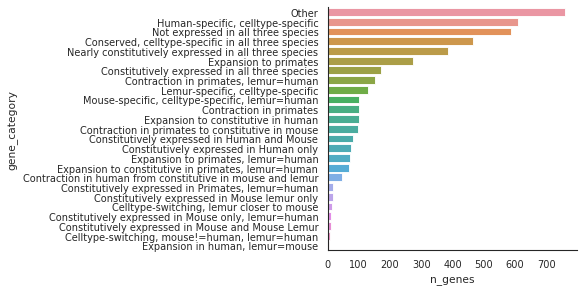

In [117]:
sns.set_context('paper')

fig, ax = plt.subplots(figsize=(4, 4))
sns.barplot(data=per_gene_catgorization_compartment_counts, x='n_genes', y='gene_category')
sns.despine()
fig.savefig(
    os.path.join(figure_folder_base, f"{tissue}__gene_categories.pdf")
)

### Dotplot of `Constitutively expressed in Primates`

In [118]:
per_gene_categorization_compartment_primates = per_gene_catgorization_compartment[
    per_gene_catgorization_compartment.isin(lemur_eq_human.gene_category)
]
per_gene_categorization_compartment_primates

AARD          Mouse-specific, celltype-specific, lemur=human
ABCD2         Mouse-specific, celltype-specific, lemur=human
ACOX2         Mouse-specific, celltype-specific, lemur=human
ACSL1                   Contraction in primates, lemur=human
ACSL3      Expansion to constitutive in primates, lemur=h...
                                 ...                        
ZAP70                   Contraction in primates, lemur=human
ZDHHC18                 Contraction in primates, lemur=human
ZNF580     Expansion to constitutive in primates, lemur=h...
ZNF710                  Contraction in primates, lemur=human
ZNF791     Constitutively expressed in Primates, lemur=human
Length: 429, dtype: object

In [119]:
pd.options.display.max_rows = 100

In [120]:
# gene_names = per_gene_categorization_compartment_primates.index

# for compartment in binarized_per_gene_compartment.index:
#     cross_species_compartment.dotplots(
#         gene_names,
#         save=f"__binary__compartment_primates__{compartment}",
#         dot_min=0.05,
#         dot_max=1,
#         #         select_group=compartment,
#         #         save_format="pdf",
#         #         max_genes=32,
#     )

In [121]:
# cross_species.dotplot_multispecies(
#     compartment_constitutive_primates.index,
#     groupby="compartment_group",
#     dot_min=0.05,
#     dot_max=1,
# )

#### @paper multispecies dotplots (green, orange, blue for each species)

In [122]:
cross_species.dotplot_multispecies(
    per_gene_categorization_compartment_primates.index,
    groupby="compartment_narrow",
    dot_min=0.05,
    dot_max=1,
    save_prefix=f"__binary__compartment_switching__primates",
)


gene subset #1
Mouse


Mouse lemur


Human


gene subset #2
Mouse


Mouse lemur


Human


gene subset #3
Mouse


Mouse lemur


Human


gene subset #4
Mouse


Mouse lemur


Human


gene subset #5
Mouse


Mouse lemur


Human


gene subset #6
Mouse


Mouse lemur


Human


gene subset #7
Mouse


Mouse lemur


Human


gene subset #8
Mouse


Mouse lemur


Human


### Compute bitscores of heatmap

In [123]:
binarized_per_gene_compartment_expressed = binarized_per_gene_compartment.groupby(
    level=0, axis=1
).filter(lambda x: x.any().any())
binarized_per_gene_compartment_expressed.head()

compartment_binarized_bitscore = binarized_per_gene_compartment.groupby(level=0, axis=1).apply(lambda x: sum(n * 2**i for i, n in enumerate(x.values.flatten())))
compartment_binarized_bitscore.value_counts()

0        588
32767    170
56       146
4032     133
23405     80
        ... 
3772       1
32446      1
30399      1
8064       1
1751       1
Length: 1693, dtype: int64

In [124]:
100 * compartment_binarized_bitscore.nunique()/2**15

5.1666259765625

## Join bitscores with categoriza5tion

In [125]:
compartment_gene_categories_bitscore = pd.DataFrame(
    {
        "bitscore": compartment_binarized_bitscore,
        "gene_category": per_gene_catgorization_compartment,
    }
)
compartment_gene_categories_bitscore.head()

,bitscore,gene_category
A1BG,18720,"Human-specific, celltype-specific"
A1CF,0,Not expressed in all three species
A2M,18692,"Human-specific, celltype-specific"
A4GALT,22773,Other
AAAS,20448,Expansion to primates


#### Heatmaps of top ~20 bitscores

In [126]:
compartment_binarized_bitscore_value_counts = compartment_binarized_bitscore.value_counts()
compartment_binarized_bitscore_value_counts

0        588
32767    170
56       146
4032     133
23405     80
        ... 
3772       1
32446      1
30399      1
8064       1
1751       1
Length: 1693, dtype: int64

In [127]:
bitscores_to_use = compartment_binarized_bitscore_value_counts[
    compartment_binarized_bitscore_value_counts >= 10
]
print(f"len(bitscores_to_use): {len(bitscores_to_use)}")

len(bitscores_to_use): 44


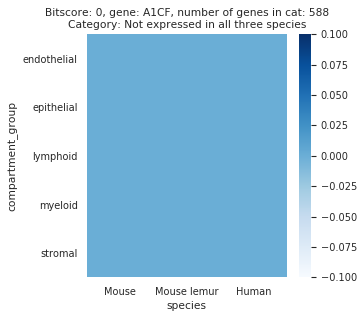

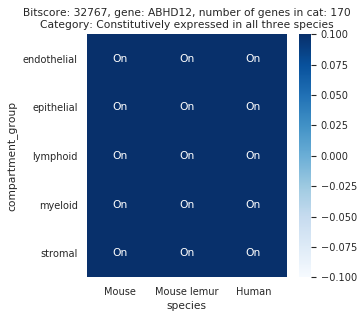

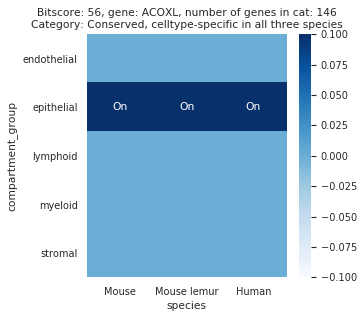

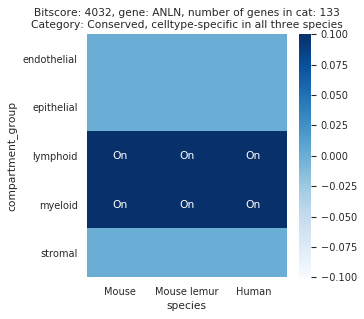

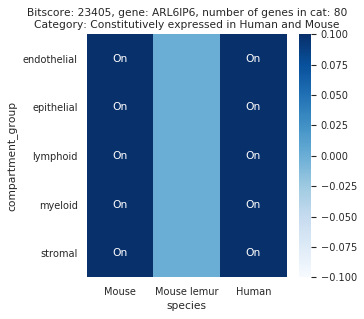

...

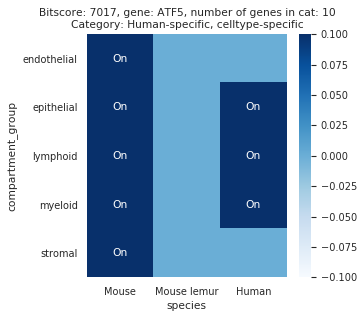

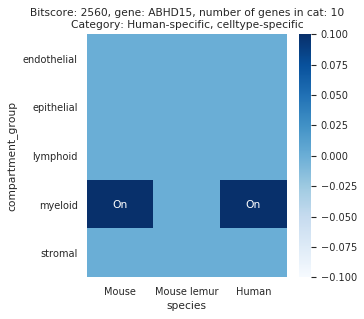

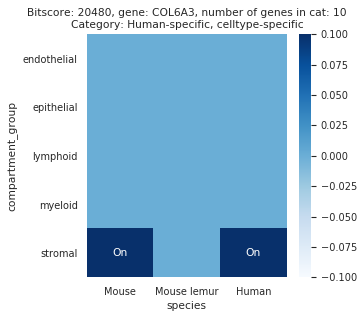

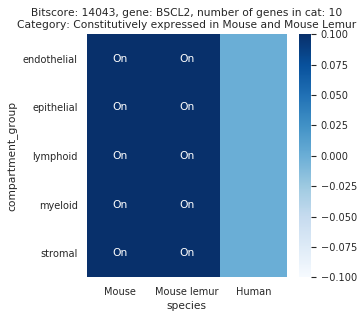

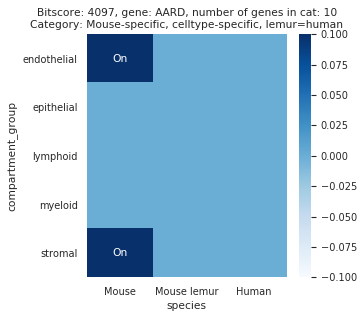

In [128]:
# for bitscore, series in binarized_bitscore.groupby(binarized_bitscore):
for bitscore, n_genes in bitscores_to_use.iteritems():
    series = compartment_binarized_bitscore[compartment_binarized_bitscore == bitscore]
#     print(f'--- bitscore: {bitscore} ---')
    for gene in series.index[:1]:
        fig, ax = plt.subplots()
        data = binarized_per_gene_compartment[gene]
#         sns.heatmap(, )
        annot = data.applymap(lambda x: 'On' if x else '')
        gene_category = compartment_gene_categories_bitscore.query('bitscore == @bitscore')['gene_category'].iloc[0]
        sns.heatmap(data, cmap='Blues', annot=annot, fmt='s', vmin=0, vmax=0)
        ax.set(title=f"Bitscore: {bitscore}, gene: {gene}, number of genes in cat: {n_genes}\nCategory: {gene_category}")

### Plot lemur=human bitscores

In [129]:
lemur_eq_human_bitscores = compartment_gene_categories_bitscore.loc[
    compartment_gene_categories_bitscore.gene_category.str.contains("lemur=human")
]
lemur_eq_human_bitscores

,bitscore,gene_category
AARD,4097,"Mouse-specific, celltype-specific, lemur=human"
ABCD2,4608,"Mouse-specific, celltype-specific, lemur=human"
ACOX2,8,"Mouse-specific, celltype-specific, lemur=human"
ACSL1,7737,"Contraction in primates, lemur=human"
ACSL3,32190,"Expansion to constitutive in primates, lemur=h..."
...,...,...
ZAP70,456,"Contraction in primates, lemur=human"
ZDHHC18,4041,"Contraction in primates, lemur=human"
ZNF580,32183,"Expansion to constitutive in primates, lemur=h..."
ZNF710,3657,"Contraction in primates, lemur=human"


In [130]:
lemur_eq_human_bitscores_with_counts = compartment_binarized_bitscore_value_counts[
    lemur_eq_human_bitscores.bitscore.unique()
].sort_values(ascending=False)
lemur_eq_human_bitscores_with_counts

8        29
28086    17
3520     13
512      11
4096     11
         ..
28736     1
4086      1
25166     1
28095     1
31744     1
Length: 152, dtype: int64

In [131]:
lemur_eq_human_bitscores.query('bitscore == 48')

,bitscore,gene_category


In [132]:
heatmap_outdir = os.path.join(figure_folder_base, 'heatmaps')


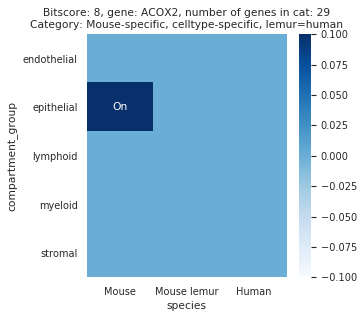

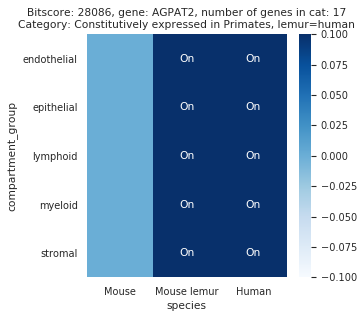

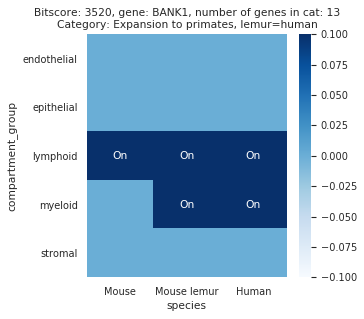

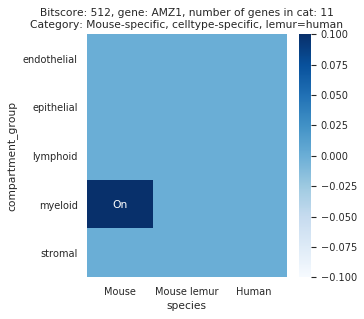

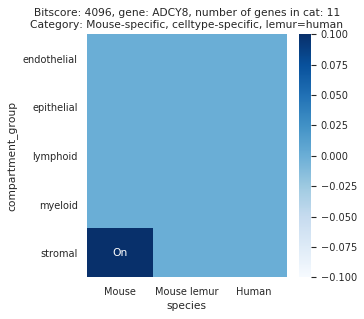

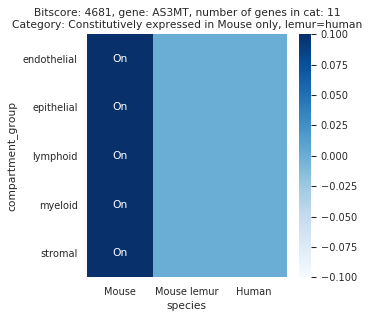

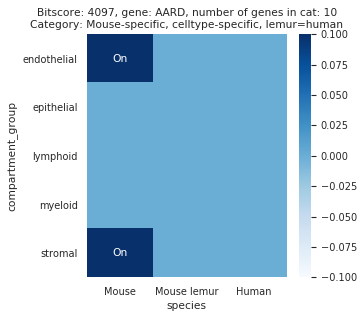

In [133]:
# for bitscore, series in binarized_bitscore.groupby(binarized_bitscore):
for bitscore, n_genes in lemur_eq_human_bitscores_with_counts.iteritems():
    #     n_genes = compartment_binarized_bitscore_value_counts[bitscore]
    if n_genes < 10:
        continue
    series = compartment_binarized_bitscore[compartment_binarized_bitscore == bitscore]
    #     print(f'--- bitscore: {bitscore} ---')
    for gene in series.index[:1]:
        fig, ax = plt.subplots()
        data = binarized_per_gene_compartment[gene]
        #         sns.heatmap(, )
        annot = data.applymap(lambda x: "On" if x else "")
        gene_category = compartment_gene_categories_bitscore.query(
            "bitscore == @bitscore"
        )["gene_category"].iloc[0]
        sns.heatmap(data, cmap="Blues", annot=annot, fmt="s", vmin=0, vmax=0)
        ax.set(
            title=f"Bitscore: {bitscore}, gene: {gene}, number of genes in cat: {n_genes}\nCategory: {gene_category}"
        )

## GEne ontology enrichment of bitscores

In [134]:
import enrich

In [135]:
compartment_binarized_bitscore

A1BG       18720
A1CF           0
A2M        18692
A4GALT     22773
AAAS       20448
           ...  
ZPLD1          0
ZSCAN10        0
ZSCAN18    26806
ZWILCH      3904
ZWINT       3521
Length: 4352, dtype: int64

In [136]:
expressed_genes = compartment_binarized_bitscore[compartment_binarized_bitscore > 0].index.tolist()

In [137]:
lemur_eq_human_bitscores.bitscore_category = pd.Categorical(
    lemur_eq_human_bitscores.bitscore,
    categories=lemur_eq_human_bitscores_with_counts.index,
    ordered=True,
)
lemur_eq_human_bitscores.bitscore_category

/home/olga/miniconda3/envs/tabula-microcebus-jan2021/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  after removing the cwd from sys.path.


[4097, 4608, 8, 7737, 32190, ..., 456, 4041, 32183, 3657, 28086]
Length: 429
Categories (152, int64): [8 < 28086 < 3520 < 512 ... 4086 < 25166 < 28095 < 31744]

In [138]:
for bitscore, df in lemur_eq_human_bitscores.groupby("bitscore"):
    enrichment = enrich.do_go_enrichment(df.index.tolist(), background=expressed_genes)
    break

In [139]:
enrich.do_go_enrichment??

Signature: enrich.do_go_enrichment(gene_names, no_evidences=False, **kwargs)
Docstring: <no docstring>
Source:   
def do_go_enrichment(gene_names, no_evidences=False, **kwargs):
    kwargs['no_evidences'] = no_evidences
    
    go = sc.queries.enrich(gene_names, 
                           gprofiler_kwargs=kwargs)
    # print(go.shape)
    go['neg_log10_p_value'] = -np.log10(go.p_value)
    return go
File:      ~/code/tabula-microcebus--olgabot/rerun-cross-species-jan2021/notebooks/enrich.py
Type:      function


In [140]:
enrichment.head()

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents,intersections,evidences,neg_log10_p_value


## Which celltypes were most affected by contractions/expasions/switching?

### Contractions

In [141]:
def get_celltypes_most_affected_by_category(
    gene_category_contains, compartment_gene_categories_bitscore, human_present=False
):

    gene_category_subset = compartment_gene_categories_bitscore.loc[
        compartment_gene_categories_bitscore.gene_category.str.contains(
            gene_category_contains, case=False
        )
    ]

    binarized_per_gene_compartment_subset = binarized_per_gene_compartment.loc[
        :, gene_category_subset.index
    ]

    binarized_per_gene_compartment_subset_human = (
        binarized_per_gene_compartment_subset.loc[
            :, pd.IndexSlice[:, "Human"]
        ].droplevel(-1, axis=1)
    )
    print((binarized_per_gene_compartment_subset_human == human_present).sum(axis=1))
    return gene_category_subset


contractions = get_celltypes_most_affected_by_category(
    "Contraction", compartment_gene_categories_bitscore
)

compartment_group
endothelial    278
epithelial     210
lymphoid       273
myeloid        157
stromal        289
dtype: int64


In [142]:
contractions

,bitscore,gene_category
ACACA,1592,Contraction in primates
ACADL,14075,Contraction in human from constitutive in mous...
ACSL1,7737,"Contraction in primates, lemur=human"
ACSL5,8191,Contraction in primates to constitutive in mouse
ADAM19,8143,Contraction in primates to constitutive in mouse
...,...,...
ZNF664,16379,Contraction in human from constitutive in mous...
ZNF704,28731,Contraction in primates
ZNF710,3657,"Contraction in primates, lemur=human"
ZNRF1,5759,Contraction in primates to constitutive in mouse


#### Plot contractions heatmap

NameError: name 'plot_binarized_gene' is not defined

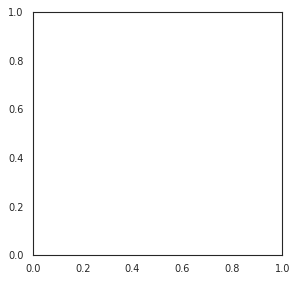

In [143]:
# for bitscore, series in binarized_bitscore.groupby(binarized_bitscore):
for bitscore in contractions.bitscore.unique():
    series = compartment_binarized_bitscore[compartment_binarized_bitscore == bitscore]
    #     print(f'--- bitscore: {bitscore} ---')
    for gene in series.index[:1]:
        fig, ax = plt.subplots()
        plot_binarized_gene(gene, binarized_per_gene_compartment)
        gene_category = compartment_gene_categories_bitscore.query(
            "bitscore == @bitscore"
        )["gene_category"].iloc[0]
        ax.set(
            title=f"Bitscore: {bitscore}, gene: {gene}, number of genes in cat: {n_genes}\nCategory: {gene_category}"
        )

#### Plot contractions heatmap

In [ ]:
# for bitscore, series in binarized_bitscore.groupby(binarized_bitscore):
for bitscore in contractions.bitscore.unique():
    series = compartment_binarized_bitscore[compartment_binarized_bitscore == bitscore]
    #     print(f'--- bitscore: {bitscore} ---')
    n_genes = compartment_binarized_bitscore_value_counts[bitscore]
    for gene in series.index[:1]:
        fig, ax = plt.subplots()
        binarized.plot_binarized_gene(gene, binarized_per_gene_compartment)
        gene_category = compartment_gene_categories_bitscore.query(
            "bitscore == @bitscore"
        )["gene_category"].iloc[0]
        ax.set(
            title=f"Bitscore: {bitscore}, gene: {gene}, number of genes in cat: {n_genes}\nCategory: {gene_category}"
        )

### Expansion

In [ ]:


expansions = get_celltypes_most_affected_by_category(
    "Expansion", compartment_gene_categories_bitscore, human_present=True
)

#### Plot Expansions heatmap

In [ ]:
# for bitscore, series in binarized_bitscore.groupby(binarized_bitscore):
for bitscore in expansions.bitscore.unique():
    series = compartment_binarized_bitscore[compartment_binarized_bitscore == bitscore]
    #     print(f'--- bitscore: {bitscore} ---')
    n_genes = compartment_binarized_bitscore_value_counts[bitscore]
    for gene in series.index[:1]:
        fig, ax = plt.subplots()
        binarized.plot_binarized_gene(gene, binarized_per_gene_compartment)
        gene_category = compartment_gene_categories_bitscore.query(
            "bitscore == @bitscore"
        )["gene_category"].iloc[0]
        ax.set(
            title=f"Bitscore: {bitscore}, gene: {gene}, number of genes in cat: {n_genes}\nCategory: {gene_category}"
        )

In [ ]:
binarized_per_gene_compartment.groupby(level=0, axis=1).apply(lambda x: )

In [ ]:
for gene in genes:
    fig, ax = plt.subplots()
    sns.heatmap(binarized_per_gene_compartment[gene])
    ax.set(title=gene)

In [ ]:
hhip = binarized_per_gene_compartment['HHIP']
categorize_genes(hhip)

#### Dotplot, per compartment_narrow

In [ ]:
gene_names = sorted(['HNRNPA1', 'AMD1', "ATP6V0C", 'TYMP', 'ZNF146'])

# for compartment in binarized_per_gene_compartment.index:
cross_species.dotplot_multispecies(
    gene_names,
#         save=f"__binary__compartment_constitutive_primates__{compartment}",
#         select_group=compartment,
#         save_format="pdf",
#         max_genes=32,
)

In [ ]:
# gene_names = compartment_constitutive_primates.index

# for compartment in binarized_per_gene_compartment.index:
cross_species.dotplots(
    gene_names,
    
#         save=f"__binary__compartment_constitutive_primates__{compartment}",
#         select_group=compartment,
#         save_format="pdf",
#         max_genes=32,
)

#### Dotplot, per compartment group

In [ ]:
cross_species_compartment = xspecies.CrossSpeciesComparison(adata, 'compartment_group')
cross_species_compartment.preprocess()

#### Plot dotplost per compartment

In [ ]:
# gene_names = compartment_constitutive_primates.index

# for compartment in binarized_per_gene_compartment.index:
cross_species_compartment.dotplots(
    gene_names,
    
#         save=f"__binary__compartment_constitutive_primates__{compartment}",
#         select_group=compartment,
#         save_format="pdf",
#         max_genes=32,
)

## Parallelized per-narrow group

In [ ]:
binarized_per_gene.head()

In [ ]:
binarized_per_gene.stack(level=-1).unstack()

In [ ]:
figure_folder

In [ ]:
celltype_group

In [ ]:
%%time

remove_rogue_tqdm()

grouped = binarized_per_gene.groupby(level=0, axis=1)

results = Parallel(n_jobs=16)(
    delayed(binarized.categorize_genes)(df) for gene, df in grouped
)
per_gene_catgorization_narrow = pd.Series(results, index=grouped.groups.keys())
per_gene_catgorization_narrow["HHIP"]


In [ ]:
binarized.query_binarized_category_and_plot(
    "AAK1", binarized_per_gene, context=None, linewidth=0.5
)

### Write categorization to file

In [ ]:
tissue

In [ ]:
celltype_group = "narrow_group"

binarized.save_gene_categorization(
    tissue, celltype_group, per_gene_catgorization_narrow, figure_folder_base
)

### WRite binarized on/off to file

In [ ]:
parquet = os.path.join(figure_folder_base, f'binarized__{tissue}__{celltype_group}.parquet')
print(parquet)
binarized_per_gene.stack(level=-1).to_parquet(parquet)

In [ ]:
csv

In [ ]:
per_gene_catgorization_narrow_counts.reset_index()

In [ ]:
per_gene_catgorization_narrow_counts = (
    per_gene_catgorization_narrow.value_counts().reset_index()
)
# per_gene_catgorization_narrow_counts.name = 'n_genes'
per_gene_catgorization_narrow_counts = (
    per_gene_catgorization_narrow_counts.rename(
        columns={"index": "gene_category", 'gene_category': "n_genes"}
    )
)
per_gene_catgorization_narrow_counts

In [ ]:
per_gene_catgorization_narrow_counts

In [ ]:
lemur_eq_human = per_gene_catgorization_narrow_counts.loc[
    per_gene_catgorization_narrow_counts.gene_category.str.contains("lemur=human")
]
lemur_eq_human

In [ ]:
rows = per_gene_catgorization_narrow == "Constitutively expressed in Primates, lemur=human"
per_gene_catgorization_narrow[rows]

In [ ]:
lemur_eq_human.n_genes.sum()

In [ ]:
sns.set_context('paper')

fig, ax = plt.subplots(figsize=(4, 4))
sns.barplot(data=per_gene_catgorization_narrow_counts, x='n_genes', y='gene_category')
sns.despine()
fig.savefig(
    os.path.join(figure_folder_base, f"{tissue}__gene_categories.pdf")
)

### Dotplot of `Constitutively expressed in Primates`

In [ ]:
per_gene_categorization_narrow_primates = per_gene_catgorization_narrow[
    per_gene_catgorization_narrow.isin(lemur_eq_human.gene_category)
]
per_gene_categorization_narrow_primates

In [ ]:
primate_constitutive_strings = [
    "Expansion to constitutive in primates, lemur=human",
    "Constitutively expressed in Primates, lemur=human",
]

In [ ]:
primate_constitutive_strings = [
    "Expansion to constitutive in primates, lemur=human",
    "Constitutively expressed in Primates, lemur=human",
]

In [ ]:
narrow_constitutive_primates = per_gene_catgorization_narrow[
    per_gene_catgorization_narrow.isin(primate_constitutive_strings)
]
narrow_constitutive_primates

In [ ]:
per_gene_catgorization_narrow[['ATP6V0C',
 'BEX4',
 'CCDC66',
 'DHX29',
 'FGD3',
 'HNRNPA1',
 'POLR2A',
 'RPL26',
 'TIMP1',
 'TMEM87A',
 'TYMP',
 'UBR1']]

In [ ]:
narrow_constitutive_primates.index.tolist()

In [ ]:
per_gene_categorization_narrow_primates['HNRNPA1']

In [ ]:
pd.options.display.max_rows = 100

In [ ]:
# gene_names = per_gene_categorization_compartment_primates.index

# for compartment in binarized_per_gene_compartment.index:
#     cross_species_compartment.dotplots(
#         gene_names,
#         save=f"__binary__compartment_primates__{compartment}",
#         dot_min=0.05,
#         dot_max=1,
#         #         select_group=compartment,
#         #         save_format="pdf",
#         #         max_genes=32,
#     )

In [ ]:
# cross_species.dotplot_multispecies(
#     compartment_constitutive_primates.index,
#     groupby="compartment_group",
#     dot_min=0.05,
#     dot_max=1,
# )

#### @paper multispecies dotplots (green, orange, blue for each species)

In [ ]:
# cross_species.dotplot_multispecies(
#     per_gene_categorization_compartment_primates.index,
#     groupby="compartment_narrow",
#     dot_min=0.05,
#     dot_max=1,
#     save_prefix=f"__binary__compartment_switching__primates",
# )


In [ ]:
binarized_per_gene_expressed = binarized_per_gene.groupby(level=0, axis=1).filter(
    lambda x: x.any().any()
)
binarized_per_gene_expressed.head()

narrow_binarized_bitscore = binarized_per_gene_expressed.groupby(level=0, axis=1).apply(
    lambda x: ''.join('1' if n else '0' for i, n in enumerate(x.values.flatten()))
)
narrow_binarized_bitscore.value_counts()

In [ ]:
100 * narrow_binarized_bitscore.nunique()/2**(3*len(binarized_per_gene_expressed.index))

## Join bitscores with categoriza5tion

In [ ]:
narrow_gene_categories_bitscore = pd.DataFrame(
    {
        "bitscore": narrow_binarized_bitscore,
        "gene_category": per_gene_catgorization_narrow,
    }
).dropna()
narrow_gene_categories_bitscore.head()

## Remove categories that are hard to verify or not as interesting

- Constitutive acoss all species
- Only detected in human, lemur, or mouse,
- Same expression across all species (expressed in the same cells)

In [ ]:
rows = (
    narrow_gene_categories_bitscore.gene_category.str.contains(
        "constitutive", case=False
    )
    | narrow_gene_categories_bitscore.gene_category.str.contains("Human-specific")
    | narrow_gene_categories_bitscore.gene_category.str.contains("Lemur-specific")
    | narrow_gene_categories_bitscore.gene_category.str.contains("Mouse-specific")
    | narrow_gene_categories_bitscore.gene_category.str.contains("Conserved")
)

narrow_gene_categories_bitscore_not_constitutive_or_species_specific = (
    narrow_gene_categories_bitscore.loc[~rows]
)
narrow_gene_categories_bitscore_not_constitutive_or_species_specific.gene_category.value_counts()

In [ ]:
narrow_gene_categories_bitscore_not_constitutive_or_species_specific.groupby('gene_category').bitscore.nunique()

## WRite bitscores with categorization to file

In [ ]:
celltype_group = "narrow_group"

binarized.save_gene_categorization(
    tissue, celltype_group, narrow_gene_categories_bitscore, figure_folder_base
)

In [ ]:
narrow_gene_categories_bitscore.dtypes

In [ ]:
narrow_gene_categories_bitscore.loc[narrow_gene_categories_bitscore.gene_category.str.contains('switch')]

### Heatmaps of top ~20 bitscores that change across evolution

In [ ]:
narrow_binarized_bitscore_value_counts = narrow_gene_categories_bitscore_not_constitutive_or_species_specific.value_counts()
narrow_binarized_bitscore_value_counts

In [ ]:
genes_in_bitscore = narrow_gene_categories_bitscore_not_constitutive_or_species_specific.query(
    'bitscore == "000000000000000100111000000000000000000000000000000000000000000000000"'
)
genes_in_bitscore

In [ ]:
cross_species.dotplots(
    genes_in_bitscore.index,
    #                 save=f"__binarized__{tissue}__{category_sanitized}__{bitscore}",
    #                 select_group=compartment_narrow_col,
    #                 save_format="pdf",
    max_genes=32,
    dot_min=0.05,
    dot_max=1,
)

In [ ]:
bitscores_to_use = narrow_binarized_bitscore_value_counts[
    narrow_binarized_bitscore_value_counts >= 2
]
print(f"len(bitscores_to_use): {len(bitscores_to_use)}")

In [ ]:
# for bitscore, series in binarized_bitscore.groupby(binarized_bitscore):
for (bitscore, gene_category), n_genes in bitscores_to_use.iteritems():
    series = narrow_binarized_bitscore[
        narrow_binarized_bitscore == bitscore
    ]
#     print(f'--- bitscore: {bitscore} ---')
#     print(series.head())
    for gene in series.index[:1]:
        fig, ax = plt.subplots(figsize=(4, 4))
        binarized.plot_binarized_gene(gene, binarized_per_gene, linewidth=0.5)
#         data = binarized_per_gene[gene]
        
#         #         sns.heatmap(, )
#         annot = data.applymap(lambda x: "On" if x else "")
#         gene_category = per_gene_catgorization_narrow[gene]
#         sns.heatmap(data, cmap="Blues", annot=annot, fmt="s", vmin=0, vmax=0)
        ax.set(
            title=f"Bitscore: {bitscore}\ngene: {gene}, number of genes in cat: {n_genes}\nCategory: {gene_category}"
        )

In [ ]:
narrow_binarized_bitscore_value_counts_df = narrow_binarized_bitscore_value_counts.reset_index()
narrow_binarized_bitscore_value_counts_df.head()

## Save (Pickle) cross species object for later

In [ ]:
pickle_filename = os.path.join(
    figure_folder_base, f"cross_species__{tissue}__adata_per_{celltype_group}.pickle"
)
with open(pickle_filename, "wb") as f:
    pickle.dump(cross_species, f)

In [ ]:
ls -lha $pickle_filename

In [ ]:
narrow_lemur_eq_human_bitscores = narrow_binarized_bitscore_value_counts_df.loc[
    narrow_binarized_bitscore_value_counts_df.gene_category.str.contains(
        "lemur=human"
    )
]
narrow_lemur_eq_human_bitscores = narrow_lemur_eq_human_bitscores.rename(columns={0: 'n_genes'})
narrow_lemur_eq_human_bitscores.head()

In [ ]:
# for bitscore, series in binarized_bitscore.groupby(binarized_bitscore):
for index, (bitscore, gene_category, n_genes) in narrow_lemur_eq_human_bitscores.iterrows():
    series = narrow_binarized_bitscore[
        narrow_binarized_bitscore == bitscore
    ]
#     print(f'--- bitscore: {bitscore} ---')
#     print(series.head())
    for gene in series.index[:1]:
        fig, ax = plt.subplots(figsize=(4, 4))
        binarized.plot_binarized_gene(gene, binarized_per_gene, linewidth=0.5)
#         data = binarized_per_gene[gene]
        
#         #         sns.heatmap(, )
#         annot = data.applymap(lambda x: "On" if x else "")
#         gene_category = per_gene_catgorization_narrow[gene]
#         sns.heatmap(data, cmap="Blues", annot=annot, fmt="s", vmin=0, vmax=0)
        ax.set(
            title=f"Bitscore: {bitscore}\ngene: {gene}, number of genes in cat: {n_genes}\nCategory: {gene_category}"
        )

In [ ]:
# %%time

# grouped = binarized_per_gene.groupby(level=0, axis=1)

# results = Parallel(n_jobs=16)(
#     delayed(categorize_genes)(df) for gene, df in tqdm(grouped)
# )
# per_gene_catgorization_narrow = pd.Series(results, index=grouped.groups.keys())

In [ ]:
per_gene_catgorization_narrow['HHIP']

In [ ]:
per_gene_catgorization_narrow.value_counts()

In [ ]:
%%time
per_gene_catgorization_narrow = binarized_per_gene.groupby(level=0, axis=1).apply(
    categorize_genes
)
per_gene_catgorization_narrow["HHIP"]

In [ ]:
per_gene_catgorization_narrow.value_counts()

In [ ]:
fig, ax = plt.subplots(figsize=(4, 8))
sns.heatmap(binarized_per_gene["HHIP"])
ax.set(title='HHIP')

In [ ]:
cross_species.dotplot_multispecies(['HHIP'])

### Do per comaprtment

In [ ]:
%%time
per_gene_catgorization_compartment = binarized_per_gene_compartment.groupby(
    level=0, axis=1
).apply(categorize_genes)
per_gene_catgorization_compartment["HHIP"]

In [ ]:
# celltypes_that_are_off = (~df).all(axis=1)
# df.loc[~celltypes_that_are_off]

In [ ]:
per_gene_catgorization_compartment.value_counts()

In [ ]:
genes_in_category_other = per_gene_catgorization_compartment[
    per_gene_catgorization_compartment == "Other"
]
genes_in_category_other.head()

In [ ]:
ax = sns.heatmap(binarized_per_gene_compartment['HHIP'])
ax.set(title='HHIP')

In [ ]:
binarized_per_gene[genes_in_category_other.index]

In [ ]:
primate_conserved = per_gene_catgorization_narrow[per_gene_catgorization_narrow == 'Conserved expression of genes in Human and Lemur']
scanpy.pl.dotplot(adata, primate_conserved.index[:10], groupby=['species', 'compartment_narrow'])

In [ ]:
'HHIP' in stability.stable_gene_names

In [ ]:
stability.binarized[stability.stable_gene_names]

In [ ]:
pd.options.display.max_columns = 50

In [ ]:
cross_species.

In [ ]:
sc.pl.dotplot(adata, genes, groupby=['species', 'compartment_narrow'])

In [ ]:
genes = ['ATP6V0C', 'HNRNPA1']

In [ ]:
import scanpy as sc

In [ ]:
sc.pl.dotplot(adata, genes, groupby=['species', 'compartment_narrow'])

# End of notebook